In [1]:
import random
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns
from copy import copy, deepcopy
from itertools import product
from tqdm.notebook import tqdm
from scipy.spatial import ConvexHull
import scipy.stats as stats

from matplotlib import ticker
M=4

from models.game import *

sns.set_style('ticks',  {"axes.grid" : "True", "grid.color": ".4", "grid.linestyle": ":"})
sns.set_context('paper')
plt.rcParams.update({ 'mathtext.default':  'regular',
                    #   'mathtext.fontset' : 'cm',
                    #   "font.family": "Helvetica",
                    #   "text.usetex": True
                      })
plt.rcParams['xtick.direction'] = 'out'
plt.rcParams['ytick.labelsize']  =15
plt.rcParams['xtick.labelsize']  =15
plt.rcParams['legend.fontsize']  = 16
plt.rcParams['axes.labelsize' ] = 16
plt.rcParams['font.size'] = 16
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['axes.formatter.useoffset'] = False
plt.rcParams["figure.autolayout"] = True


figsize = (9.333, 6.666 )
# (12,8)

# ne_style = { 'alpha' : 0.9}
# one_shot_style = { 'marker' : 'o' ,'markevery' : 3, 'ms' : 6, 'lw' : 1.5}
# so_style = { 'ls' : '--', 'alpha' : 0.8 }
# planning_style = { 'marker' : 's' ,
#                 'markevery' : (0,3),
#                 'ms' : 4,
#                 'lw' : 1.5
#                 }
# receding_style = { 'marker' : '*', 
#                   'markevery' : (1,3),  
#                   'ms' : 10, 
#                   'lw' : 1.5
#                   }


# ne_style = {
#     'alpha' : 0.9
#     }


# so_style = {
#     # 'ls' : '--',
#     'c' : 'white',
#     'alpha' : 0.9
#     }

from plot_param import *

temperature_target = None
final_multiplier = 0

case = 'sigmoid'

horizon = 2100

In [2]:
FIRST_YEAR = 2020
"Year of the first occurence of the game."

FINAL_YEAR = 2100
"Year of the last occurence of the game."

STEP = 5
"Number of years between two occurence of the game."

T = int((FINAL_YEAR - FIRST_YEAR) / STEP) 

horizon = FINAL_YEAR
X = 2020 + np.arange((horizon-2020)//5 )*5

r = [1.15, 1.60, 2, 0.5, 1.25,0.75]
e = [2, -2, -5, -4, -5, 2.5]

In [3]:
def parallel_plot(array_list, X, plot_kwargs_list=None, title=None, xlabel=None, ylabel=None, label_list=None, save_file=None, ax=None, n_col=None, n_row = None, param_fig=None, param_legend=None, param_fill=None, step=False):
    """
    Plots multiple arrays in parallel on the same plot.

    Parameters:
        array_list (list of arrays): A list of arrays to be plotted.
        plot_kwargs_list (list of dict, optional): A list of dictionaries specifying the plot properties for each array.
            If not provided, the default plot properties are used, with different colors for each array.
        title (str, optional): The title for the plot.
        xlabel (str, optional): The label for the x-axis.
        ylabel (str, optional): The label for the y-axis.
        label_list (list of str, optional): A list of labels for each array to be used in the legend.
        save_file (str, optional): The file path to save the plot as a PDF file.
        ax (matplotlib.axes.Axes, optional): The axes object to plot on. If not provided, a new figure and axis is created.

    Returns:
        None
    """

    if ax is None:
        fig, ax = plt.subplots(**param_fig)
        is_ax = False
    else:
        # ax = ax[n_row,n_col]
        is_ax = True

    # If plot_kwargs_list is not provided, use default plot properties with different colors for each array
    if plot_kwargs_list is None:
        plot_kwargs_list = [{'color': f'C{i}'}  for i in range(len(array_list))]

    # Loop through each sublist in array_list and plot the arrays in parallel
    for k, arr in enumerate(array_list):
        # Combine the default plot properties with the plot properties for the current array
        plot_kwargs = {'color': f'C{0}'} | plot_kwargs_list[k]
        # If a label list is provided and the current array has a corresponding label, use it in the plot
        if not step:
            if label_list and k < len(label_list):
                ax.plot(X, arr, label=label_list[k], **plot_kwargs)
            else:
                ax.plot(X, arr,  **plot_kwargs)
            if param_fill:
                max_arr = np.maximum(array_list[0], arr)
                ax.fill_between(X, array_list[0], max_arr, **param_fill)
        else:
            if label_list and k < len(label_list):
                ax.step(X, arr, label=label_list[k], where='post', **plot_kwargs)
            else:
                ax.step(X, arr, where='post', **plot_kwargs)
            if param_fill:
                max_arr = np.maximum(array_list[0], arr)
                ax.fill_between(X, array_list[0], max_arr, **param_fill)

    # Set the plot title, x-axis label, and y-axis label if they are provided
    if title:
        ax.set_title(title)    


    if xlabel:
        ax.set_xlabel(xlabel)
    if ylabel:
        ax.set_ylabel(ylabel)

    # Add the legend if a label list is provided
    if label_list:
        ax.legend(**param_legend)

    # Save the plot to a file if save_file is provided
    if save_file:
        fig.savefig(save_file + '.pdf', format='pdf')

    if is_ax:
        return ax

    # Show the plot if save_file is not provided
    else:
        plt.show()


In [124]:
def multi_parallel_plot(array_list, 
                        X, 
                        plot_kwargs_list=None, 
                        title=None, 
                        xlabel=None, 
                        ylabel=None, 
                        label_list=None, 
                        save_file=None, 
                        ax : plt.Axes =None, 
                        n_col=None, 
                        n_row = None, 
                        param_fig=None, 
                        param_legend=None, 
                        fill = None,
                        step = False, 
                        hatch = ['//', '\\\\', '||', '--', '++', 'xx', 'oo', 'OO', '..', '**']):
    """
    Plots multiple arrays in parallel on the same plot.

    Parameters:
        array_list (list of arrays): A list of arrays to be plotted.
        plot_kwargs_list (list of dict, optional): A list of dictionaries specifying the plot properties for each array.
            If not provided, the default plot properties are used, with different colors for each array.
        title (str, optional): The title for the plot.
        xlabel (str, optional): The label for the x-axis.
        ylabel (str, optional): The label for the y-axis.
        label_list (list of str, optional): A list of labels for each array to be used in the legend.
        save_file (str, optional): The file path to save the plot as a PDF file.
        ax (matplotlib.axes.Axes, optional): The axes object to plot on. If not provided, a new figure and axis is created.

    Returns:
        None
    """

    if ax is None:
        fig, ax = plt.subplots(**param_fig)
        is_ax = False
    else:
        # ax = ax[n_row,n_col]
        is_ax = True

    # If plot_kwargs_list is not provided, use default plot properties with different colors for each array
    if plot_kwargs_list is None:
        plot_kwargs_list = [{'color': f'C{i}'}  for i in range(len(array_list))]

    # Loop through each sublist in array_list and plot the arrays in parallel
    for k, sublist in enumerate(array_list):
        for i, arr in enumerate(sublist):
            # Combine the default plot properties with the plot properties for the current array
            colors = {'color': f'C{i}'}
            plot_kwargs = colors | plot_kwargs_list[k]
            if fill is not None:
                ax.fill_between(X, fill[k][0], fill[k][1],  
                                # hatch = hatch[k], 
                                color=colors["color"], 
                                alpha= 0.2, 
                                # facecolor ='none'
                                )
                ax.plot(X, fill[k][0], ls = 'dotted', **plot_kwargs)
                ax.plot(X, fill[k][1], ls = 'dotted', **plot_kwargs)
            if not step :
                if (label_list is not None) and (k < len(label_list)):
                    # If a label list is provided and the current array has a corresponding label, use it in the plot
                    if label_list and i == 0 :
                        ax.plot(X, arr, label=label_list[k], **plot_kwargs)
                    else:
                        ax.plot(X, arr,  **plot_kwargs)
                else:
                    ax.plot(X, arr,  **plot_kwargs)
            else :
                if (label_list is not None) and (k < len(label_list)):
                    # If a label list is provided and the current array has a corresponding label, use it in the plot
                    if label_list and i == 0:
                        ax.step(X, arr, label=label_list[i], where='post', **plot_kwargs)
                    else:
                        ax.step(X, arr, where='post', **plot_kwargs)
                else:
                    ax.step(X, arr, where='post', **plot_kwargs)

    # Set the plot title, x-axis label, and y-axis label if they are provided
    if title:
        ax.set_title(title)    


    if xlabel:
        ax.set_xlabel(xlabel)
    if ylabel:
        ax.set_ylabel(ylabel)

    # Add the legend if a label list is provided
    if label_list:
        ax.legend(**param_legend)

    # Save the plot to a file if save_file is provided
    if save_file:
        fig.savefig(save_file + '.pdf', format='pdf')

    if is_ax:
        return ax

    # Show the plot if save_file is not provided
    else:
        plt.show()


In [125]:
def plots(res, directory, list_label, case = '', title ='', ) :

    from pathlib import Path

    Path("{}/{}".format(directory,case)).mkdir(parents=True, exist_ok=True)
    directory = directory + '/' + case 

    
    def update_prop(handle, orig):
        handle.update_from(orig)
        handle.set_marker("")
    param_fig = {'figsize' : figsize, 'dpi': 100}
    param_legend = {}

    

    array_list = [list_sum_action, list_sum_action_so, list_sum_action_planning, list_sum_action_planning_so]
    plot_kwargs_list = [
        {**one_shot_style, **ne_style},
        {**so_style, **one_shot_style},
        {**ne_style, **planning_style},
        {**so_style, **planning_style}
    ]
    label_list = [r'$D = {},\, \alpha = {}$'.format(label[0], label[1]) for label in list_label]
    # [r'${}, {}, \alpha = {}$'.format(label[2][0], label[0], label[1]) for label in list_label]
    title = None
    xlabel = 'Years'
    ylabel = 'Annual Global CO2 Emissions (GtCO2)'
    save_file = directory + "/Annual_Global_CO2_Emission_planning_{}_{}".format(case, horizon)
    multi_parallel_plot(array_list=array_list,
                        X=X, 
                        plot_kwargs_list=plot_kwargs_list, 
                        label_list=label_list, 
                        title=title, 
                        xlabel=xlabel, 
                        ylabel=ylabel, 
                        save_file=save_file, 
                        param_fig=param_fig, 
                        param_legend=param_legend,
                        step = True
                        )

    array_list = [list_sum_utilities, list_sum_utilities_so, list_sum_utilities_planning, list_sum_utilities_planning_so]
    title = 'New'
    xlabel = 'Years'
    ylabel = r'Annual World Utility in  $10^{10}$\$ 2011'
    save_file = directory + "/Annual_World_Utility_planning_{}_{}".format(case, horizon)

    multi_parallel_plot(array_list=array_list, X=X, plot_kwargs_list=plot_kwargs_list, label_list=label_list, title=title, xlabel=xlabel, ylabel=ylabel, save_file=save_file, param_fig=param_fig, param_legend=param_legend)

    array_list = [list_temp, list_temp_so, list_temp_planning, list_temp_planning_so]
    title = 'New'
    xlabel = 'Years'
    ylabel = 'Global Mean Temperature variation \n from 1900 (°C)'
    save_file = directory + "/Global_Mean_Temperature_planning_{}_{}".format(case, horizon)

    multi_parallel_plot(array_list=array_list, X=X, plot_kwargs_list=plot_kwargs_list, label_list=label_list, title=title, xlabel=xlabel, ylabel=ylabel, save_file=save_file, param_fig=param_fig, param_legend=param_legend)

    n_row = 3
    n_col = 2
    
    temp0, temp1 = figsize
    tfigsize = (temp1, temp0)

    fig, axes = plt.subplots(n_row, n_col, dpi = 100, figsize=(temp1, temp0))
    k = 0
    for row in range(n_row):
        for col in range(n_col):
            array_list = [[ne_u[k] for ne_u in list_ne_u], [so_u[k] for so_u in list_so_u], [ne_planning_u[k] for ne_planning_u in list_ne_planning_u], [so_planning_u[k] for so_planning_u in list_so_planning_u]]
            title = NAMES[k]
            axes[row, col] = multi_parallel_plot(ax = axes[row,col], X = X, array_list=array_list, plot_kwargs_list=plot_kwargs_list, title=title, param_fig=param_fig)
            xticks = ticker.MaxNLocator(M)
            axes[row, col].xaxis.set_major_locator(xticks)
            k += 1
    fig.supylabel('Utility of players')
    fig.supxlabel('Years')
    save_file =  directory + "/Utilities_planning_{}_{}.pdf".format(case, horizon)

    plt.savefig(fname= save_file, format='pdf')
    plt.show()

    fig, axes = plt.subplots(n_row, n_col, dpi = 100, figsize=tfigsize)
    k = 0
    for row in range(n_row):
        for col in range(n_col):
            array_list = [[ne[k] for ne in list_ne], [a[k] for a in list_so], [a[k] for a in list_ne_planning], [a[k] for a in list_so_planning]]
            title = NAMES[k]
            axes[row, col] = multi_parallel_plot(step = True, 
                                                 ax = axes[row,col], X = X, array_list=array_list, plot_kwargs_list=plot_kwargs_list, title=title, param_fig=param_fig)
            xticks = ticker.MaxNLocator(M)
            axes[row, col].xaxis.set_major_locator(xticks)
            k +=1
    fig.supylabel('Emissions in GtCO2')
    fig.supxlabel('Years')
    save_file =  directory + "/Actions_planning_{}_{}.pdf".format(case, horizon)

    plt.savefig(fname= save_file, format='pdf')
    plt.show()


In [126]:
def plots_noise(res, noise, directory, list_label, case = '', title ='', X = X) :

    # a_planning_piece, sum_a_planning_piece, u_planning_piece, sum_u_planning_piece, temp_planning_piece

    from pathlib import Path

    Path("{}/{}".format(directory,case)).mkdir(parents=True, exist_ok=True)
    directory = directory + '/' + case 

    
    def update_prop(handle, orig):
        handle.update_from(orig)
        handle.set_marker("")
    param_fig = {'figsize' : figsize, 'dpi': 100}
    param_legend = {'ncol' : 2}

    def calculate_bounds(res, idx):
        fill_up = []
        fill_low = []
        for res_ in res:
            dumy_up = np.zeros_like(res_[idx][0])
            dumy_low = np.ones_like(res_[idx][0]) * np.max(res)
            for arr in res_[idx]:
                dumy_up = np.maximum(dumy_up,arr)
                dumy_low = np.minimum(dumy_low,arr)
            fill_up.append(dumy_up)
            fill_low.append(dumy_low)
        return dumy_low, dumy_up

    fill = calculate_bounds(res,1)

    array_list = [[np.mean(res_[1], axis=0)] for res_ in res]
    # array_list = [res_[1] for res_ in res]

    # plot_kwargs_list = None
    plot_kwargs_list = [
        ne_style | planning_style,
        so_style_curve | planning_style
    ]

    label_list = [r'SNR = {}'.format(nois) for nois in noise]
    # [r'${}, {}, \alpha = {}$'.format(label[2][0], label[0], label[1]) for label in list_label]
    title = 'Sum of action under perturbation of the Climate model of the players with some noise'
    xlabel = 'Years'
    ylabel = 'Annual Global CO2 Emissions (GtCO2)'
    save_file = directory + "/Annual_Global_CO2_Emission_planning_{}_{}".format(case, horizon)
    multi_parallel_plot(array_list=array_list,
                        X=X, 
                        plot_kwargs_list=plot_kwargs_list, 
                        label_list=label_list, 
                        title=title, 
                        xlabel=xlabel, 
                        ylabel=ylabel, 
                        save_file=save_file, 
                        param_fig=param_fig, 
                        param_legend=param_legend,
                        # patche_legend = legend_elements,
                        fill= fill,
                        step = False
                        )

    fill_up = []
    fill_low = []
    for res_ in res:
        dumy_up = np.zeros_like(res_[3][0])
        dumy_low = np.ones_like(res_[3][0]) * np.infty
        for arr in res_[3]:
            dumy_up = np.maximum(dumy_up,arr)
            dumy_low = np.minimum(dumy_low,arr)
        fill_up.append(dumy_up)
        fill_low.append(dumy_low)
    array_list = [[np.mean(res_[3], axis=0)] for res_ in res]

    # array_list = [res_[3] for res_ in res]
    title = 'Sum of GDP under perturbation of the Climate model of the players with some noise'

    # title = r'Global GDP $\bar{u}_t$ evolution in time'
    xlabel = 'Years'
    ylabel = r'Annual World Utility $\bar{u}_t$ in  $10^{10}$\$ 2011'
    save_file = directory + "/Annual_World_Utility_planning_{}_{}".format(case, horizon)

    multi_parallel_plot(array_list=array_list,
                        X=X, 
                        plot_kwargs_list=plot_kwargs_list, 
                        label_list=label_list, 
                        title=title, 
                        xlabel=xlabel, 
                        ylabel=ylabel, 
                        save_file=save_file, 
                        param_fig=param_fig, 
                        param_legend=param_legend,
                        fill= [fill_low, fill_up],
                        # patche_legend = legend_elements,
                        step = False
                        )
    
    # array_list = [res_[-1] for res_ in res]

    fill_up = []
    fill_low = []
    for res_ in res:
        dumy_up = np.zeros_like(res_[-1][0])
        dumy_low = np.ones_like(res_[-1][0]) * np.infty
        for arr in res_[-1]:
            dumy_up = np.maximum(dumy_up,arr)
            dumy_low = np.minimum(dumy_low,arr)
        fill_up.append(dumy_up)
        fill_low.append(dumy_low)
    array_list = [[np.mean(res_[-1], axis=0)] for res_ in res]
    title = 'Global Mean Temperature variation from 1900 (°C) under perturbation of the Climate model of the players with some noise'
    xlabel = 'Years'
    ylabel = 'Temperature variation'
    save_file = directory + "/Global_Mean_Temperature_planning_{}_{}".format(case, horizon)

    multi_parallel_plot(array_list=array_list,
                        X=X, 
                        plot_kwargs_list=plot_kwargs_list, 
                        label_list=label_list, 
                        title=title, 
                        xlabel=xlabel, 
                        ylabel=ylabel, 
                        save_file=save_file, 
                        param_fig=param_fig, 
                        param_legend=param_legend,
                        fill= [fill_low, fill_up],

                        # patche_legend = legend_elements,
                        step = False
                        )
    n_row = 3
    n_col = 2

    plot_kwargs_list = None
    
    # for arg in plot_kwargs_list:
    #     arg['markevery'] = (0,5)
    #     arg['ms'] = 8
    temp0, temp1 = figsize
    tfigsize = (temp1, temp0)
    ac = np.array([list(zip(*res_[2])) for res_ in res])
    ac = np.moveaxis(ac, [0,1],[1,0])
    fig, axes = plt.subplots(n_row, n_col, dpi = 100, figsize=(temp1, temp0))
    k = 0
    for row in range(n_row):
        for col in range(n_col):
            array_list = ac[k] # [[res_[0][k]] for res_ in res] # [[ne_u[k] for ne_u in list_ne_u], [so_u[k] for so_u in list_so_u], [ne_planning_u[k] for ne_planning_u in list_ne_planning_u], [so_planning_u[k] for so_planning_u in list_so_planning_u]]
            # print(array_list)
            # print(len(array_list))
            fill_up = []
            fill_low = []
            for acc in ac[k]:
                dumy_up = np.zeros_like(acc[0])
                dumy_low = np.ones_like(acc[0]) * np.infty
                for arr in acc:
                    dumy_up = np.maximum(dumy_up,arr)
                    dumy_low = np.minimum(dumy_low,arr)
                fill_up.append(dumy_up)
                fill_low.append(dumy_low)
            # print('k : ', k)
            
            title = NAMES[k]
            axes[row, col] = multi_parallel_plot(ax = axes[row,col],
                                                 X = X, 
                                                 array_list=array_list,
                                                 # label_list=label_list, 
                                                 plot_kwargs_list=plot_kwargs_list, 
                                                 title=title,
                                                 fill= [fill_low, fill_up],
                                                 param_legend=param_legend,
                                                 param_fig=param_fig)
            xticks = ticker.MaxNLocator(M)
            axes[row, col].xaxis.set_major_locator(xticks)
            k += 1
    fig.supylabel('Utility of players')
    fig.supxlabel('Years')
    save_file =  directory + "/Utilities_planning_{}_{}.pdf".format(case, horizon)

    plt.savefig(fname= save_file, format='pdf')
    plt.show()


    ac = np.array([list(zip(*res_[0])) for res_ in res])
    ac = np.moveaxis(ac, [0,1],[1,0])
    fig, axes = plt.subplots(n_row, n_col, dpi = 100, figsize=(temp1, temp0))
    k = 0
    for row in range(n_row):
        for col in range(n_col):
            array_list = ac[k] # [[res_[0][k]] for res_ in res] # [[ne_u[k] for ne_u in list_ne_u], [so_u[k] for so_u in list_so_u], [ne_planning_u[k] for ne_planning_u in list_ne_planning_u], [so_planning_u[k] for so_planning_u in list_so_planning_u]]
            # print(array_list)
            # print(len(array_list))
            fill_up = []
            fill_low = []
            for acc in ac[k]:
                dumy_up = np.zeros_like(acc[0])
                dumy_low = np.ones_like(acc[0]) * np.infty
                for arr in acc:
                    dumy_up = np.maximum(dumy_up,arr)
                    dumy_low = np.minimum(dumy_low,arr)
                fill_up.append(dumy_up)
                fill_low.append(dumy_low)
            # print('k : ', k)
            
            title = NAMES[k]
            axes[row, col] = multi_parallel_plot(ax = axes[row,col],
                                                 X = X, 
                                                 array_list=array_list,
                                                 # label_list=label_list, 
                                                 plot_kwargs_list=plot_kwargs_list, 
                                                 title=title,
                                                 fill= [fill_low, fill_up],
                                                 param_legend=param_legend,
                                                 param_fig=param_fig)
            xticks = ticker.MaxNLocator(M)
            axes[row, col].xaxis.set_major_locator(xticks)
            k += 1
    fig.supylabel('Emissions in GtCO2')
    fig.supxlabel('Years')
    save_file =  directory + "/Actions_planning_{}_{}.pdf".format(case, horizon)

    plt.savefig(fname= save_file, format='pdf')
    plt.show()

    # fig, axes = plt.subplots(n_row, n_col, dpi = 100, figsize=tfigsize)
    # k = 0
    # for row in range(n_row):
    #     for col in range(n_col):
    #         array_list = [[ne[k] for ne in list_ne], [a[k] for a in list_so], [a[k] for a in list_ne_planning], [a[k] for a in list_so_planning]]
    #         title = NAMES[k]
    #         axes[row, col] = multi_parallel_plot(step = True, 
    #                                              ax = axes[row,col], X = X, array_list=array_list, plot_kwargs_list=plot_kwargs_list, title=title, param_fig=param_fig)
    #         xticks = ticker.MaxNLocator(M)
    #         axes[row, col].xaxis.set_major_locator(xticks)
    #         k +=1



In [130]:
def plots_noise(res_ne, res_so, noise, directory, list_label, case = '', title ='', X = X) :

    # a_planning_piece, sum_a_planning_piece, u_planning_piece, sum_u_planning_piece, temp_planning_piece

    from pathlib import Path

    Path("{}/{}".format(directory,case)).mkdir(parents=True, exist_ok=True)
    directory = directory + '/' + case 

    
    def update_prop(handle, orig):
        handle.update_from(orig)
        handle.set_marker("")
    param_fig = {'figsize' : figsize, 'dpi': 100}
    param_legend = {'ncol' : 2}

    def calculate_bounds(res, idx):

        for res_ in res:
            dumy_up = -1 * np.ones_like(res_[idx][0]) * np.infty
            dumy_low = np.ones_like(res_[idx][0]) * np.infty
            for arr in res_[idx]:
                dumy_up = np.maximum(dumy_up,arr)
                dumy_low = np.minimum(dumy_low,arr)
            fill_up = dumy_up
            fill_low = dumy_low
        return np.stack([fill_low, fill_up], axis=0)

    fill = [calculate_bounds(res_ne,1), calculate_bounds(res_so,1)]
    array_list = [[np.mean(res_ne_[1], axis=0) for res_ne_ in res_ne], [np.mean(res_so_[1], axis=0) for res_so_ in res_so]]
    # array_list = [res_ne_[1] for res_ne_ in res_ne]

    # plot_kwargs_list = None
    plot_kwargs_list = [
        ne_style | planning_style,
        so_style_curve | planning_style
    ]

    label_list = [r'SNR = {}'.format(nois) for nois in noise]
    # [r'${}, {}, \alpha = {}$'.format(label[2][0], label[0], label[1]) for label in list_label]
    title = 'Sum of action under perturbation of the Benefits function of the players with some noise'
    xlabel = 'Years'
    ylabel = 'Annual Global CO2 Emissions (GtCO2)'
    save_file = directory + "/Annual_Global_CO2_Emission_planning_{}_{}".format(case, horizon)
    multi_parallel_plot(array_list=array_list,
                        X=X, 
                        plot_kwargs_list=plot_kwargs_list, 
                        label_list=label_list, 
                        title=title, 
                        xlabel=xlabel, 
                        ylabel=ylabel, 
                        save_file=save_file, 
                        param_fig=param_fig, 
                        param_legend=param_legend,
                        # patche_legend = legend_elements,
                        fill= fill,
                        step = False
                        )

    fill = [calculate_bounds(res_ne,3), calculate_bounds(res_so,3)]


    # array_list = [res_ne_[3] for res_ne_ in res_ne]
    title = 'Sum of GDP under perturbation of the Climate model of the players with some noise'

    # title = r'Global GDP $\bar{u}_t$ evolution in time'
    xlabel = 'Years'
    ylabel = r'Annual World Utility $\bar{u}_t$ in  $10^{10}$\$ 2011'
    save_file = directory + "/Annual_World_Utility_planning_{}_{}".format(case, horizon)

    multi_parallel_plot(array_list=array_list,
                        X=X, 
                        plot_kwargs_list=plot_kwargs_list, 
                        label_list=label_list, 
                        title=title, 
                        xlabel=xlabel, 
                        ylabel=ylabel, 
                        save_file=save_file, 
                        param_fig=param_fig, 
                        param_legend=param_legend,
                        fill= fill,
                        # patche_legend = legend_elements,
                        step = False
                        )
    
    # array_list = [res_ne_[-1] for res_ne_ in res_ne]

    fill = [calculate_bounds(res_ne,-1), calculate_bounds(res_so,-1)]

    array_list = [[np.mean(res_ne_[-1], axis=0) for res_ne_ in res_ne], [np.mean(res_so_[-1], axis=0) for res_so_ in res_so]]
    title = 'Global Mean Temperature variation from 1900 (°C) under perturbation of the Climate model of the players with some noise'
    xlabel = 'Years'
    ylabel = 'Temperature variation'
    save_file = directory + "/Global_Mean_Temperature_planning_{}_{}".format(case, horizon)

    multi_parallel_plot(array_list=array_list,
                        X=X, 
                        plot_kwargs_list=plot_kwargs_list, 
                        label_list=label_list, 
                        title=title, 
                        xlabel=xlabel, 
                        ylabel=ylabel, 
                        save_file=save_file, 
                        param_fig=param_fig, 
                        param_legend=param_legend,
                        fill= fill,

                        # patche_legend = legend_elements,
                        step = False
                        )
    n_row = 3
    n_col = 2

    plot_kwargs_list = [
        ne_style | planning_style,
        so_style_curve | planning_style
    ]

    def calculate_bounds_no_index(data):

        for res_ in data:
            dumy_up = -1* np.ones_like(res_[0]) * np.infty
            dumy_low = np.ones_like(res_[0]) * np.infty
            for arr in res_:
                dumy_up = np.maximum(dumy_up,arr)
                dumy_low = np.minimum(dumy_low,arr)
            fill_up = dumy_up
            fill_low = dumy_low
        return np.stack([fill_low, fill_up], axis=0)
    
    # for arg in plot_kwargs_list:
    #     arg['markevery'] = (0,5)
    #     arg['ms'] = 8
    temp0, temp1 = figsize
    tfigsize = (temp1, temp0)
    ac = np.array([list(zip(*res_ne_[2])) for res_ne_ in res_ne])
    ac = np.moveaxis(ac, [0,1],[1,0])
    aso = np.array([list(zip(*res_so_[2])) for res_so_ in res_so])
    aso = np.moveaxis(aso, [0,1],[1,0])
    fig, axes = plt.subplots(n_row, n_col, dpi = 100, figsize=(temp1, temp0))
    k = 0
    for row in range(n_row):
        for col in range(n_col):
            array_list = [np.mean(ac[k], axis=1), np.mean(aso[k], axis=1)] # [[res_ne_[0][k]] for res_ne_ in res_ne] # [[ne_u[k] for ne_u in list_ne_u], [so_u[k] for so_u in list_so_u], [ne_planning_u[k] for ne_planning_u in list_ne_planning_u], [so_planning_u[k] for so_planning_u in list_so_planning_u]]
            # print(array_list)
            # print(len(array_list))

            fill = [calculate_bounds_no_index(ac[k]), calculate_bounds_no_index(aso[k])]
            print(np.array(fill).shape)

            # print('k : ', k)
            
            title = NAMES[k]
            axes[row, col] = multi_parallel_plot(ax = axes[row,col],
                                                 X = X, 
                                                 array_list=array_list,
                                                 # label_list=label_list, 
                                                 plot_kwargs_list=plot_kwargs_list, 
                                                 title=title,
                                                 fill= fill,
                                                 param_legend=param_legend,
                                                 param_fig=param_fig)
            xticks = ticker.MaxNLocator(M)
            axes[row, col].xaxis.set_major_locator(xticks)
            k += 1
    fig.supylabel('Utility of players')
    fig.supxlabel('Years')
    save_file =  directory + "/Utilities_planning_{}_{}.pdf".format(case, horizon)

    plt.savefig(fname= save_file, format='pdf')
    plt.show()


    ac = np.array([list(zip(*res_ne_[0])) for res_ne_ in res_ne])
    ac = np.moveaxis(ac, [0,1],[1,0])
    aso = np.array([list(zip(*res_so_[0])) for res_so_ in res_so])
    aso = np.moveaxis(aso, [0,1],[1,0])

    fig, axes = plt.subplots(n_row, n_col, dpi = 100, figsize=(temp1, temp0))
    k = 0
    for row in range(n_row):
        for col in range(n_col):
            array_list = [np.mean(ac[k], axis=1), np.mean(aso[k], axis=1)] # [[res_ne_[0][k]] for res_ne_ in res_ne] # [[ne_u[k] for ne_u in list_ne_u], [so_u[k] for so_u in list_so_u], [ne_planning_u[k] for ne_planning_u in list_ne_planning_u], [so_planning_u[k] for so_planning_u in list_so_planning_u]]
            # print(array_list)
            # print(len(array_list))
            fill = [calculate_bounds_no_index(ac[k]), calculate_bounds_no_index(aso[k])]
            # print('k : ', k)
            
            title = NAMES[k]
            axes[row, col] = multi_parallel_plot(ax = axes[row,col],
                                                 X = X, 
                                                 array_list=array_list,
                                                 # label_list=label_list, 
                                                 plot_kwargs_list=plot_kwargs_list, 
                                                 title=title,
                                                 fill= fill,
                                                 param_legend=param_legend,
                                                 param_fig=param_fig)
            xticks = ticker.MaxNLocator(M)
            axes[row, col].xaxis.set_major_locator(xticks)
            k += 1
    fig.supylabel('Emissions in GtCO2')
    fig.supxlabel('Years')
    save_file =  directory + "/Actions_planning_{}_{}.pdf".format(case, horizon)

    plt.savefig(fname= save_file, format='pdf')
    plt.show()

    # fig, axes = plt.subplots(n_row, n_col, dpi = 100, figsize=tfigsize)
    # k = 0
    # for row in range(n_row):
    #     for col in range(n_col):
    #         array_list = [[ne[k] for ne in list_ne], [a[k] for a in list_so], [a[k] for a in list_ne_planning], [a[k] for a in list_so_planning]]
    #         title = NAMES[k]
    #         axes[row, col] = multi_parallel_plot(step = True, 
    #                                              ax = axes[row,col], X = X, array_list=array_list, plot_kwargs_list=plot_kwargs_list, title=title, param_fig=param_fig)
    #         xticks = ticker.MaxNLocator(M)
    #         axes[row, col].xaxis.set_major_locator(xticks)
    #         k +=1



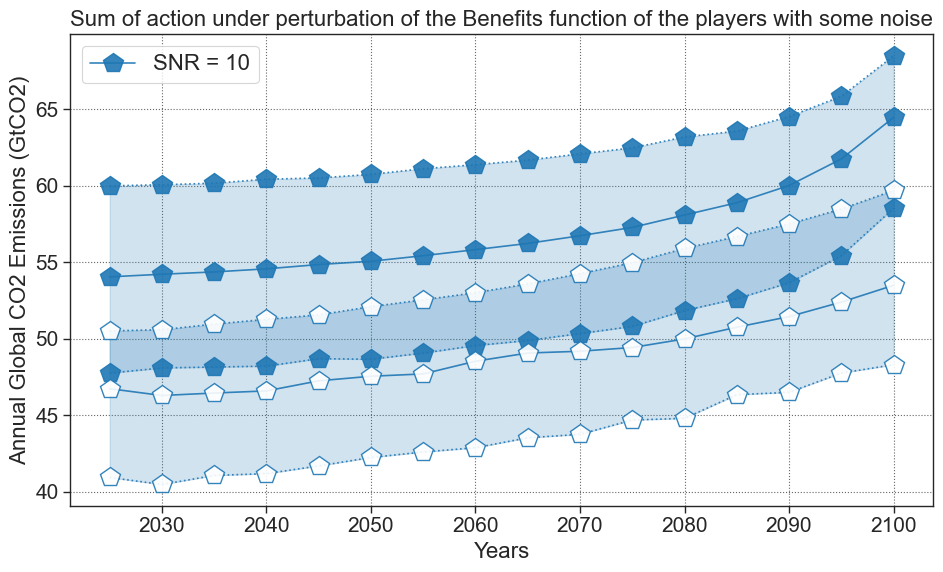

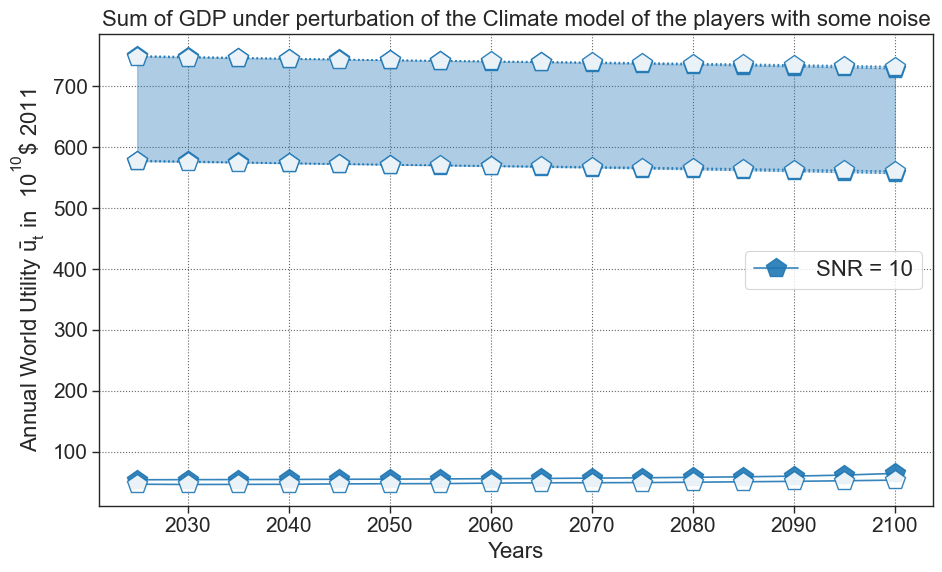

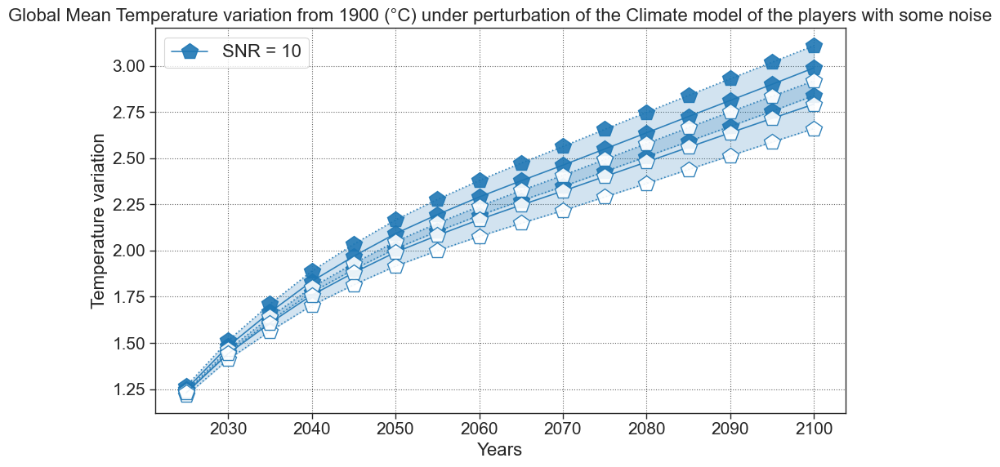

(2, 2, 16)
(2, 2, 16)
(2, 2, 16)
(2, 2, 16)
(2, 2, 16)
(2, 2, 16)


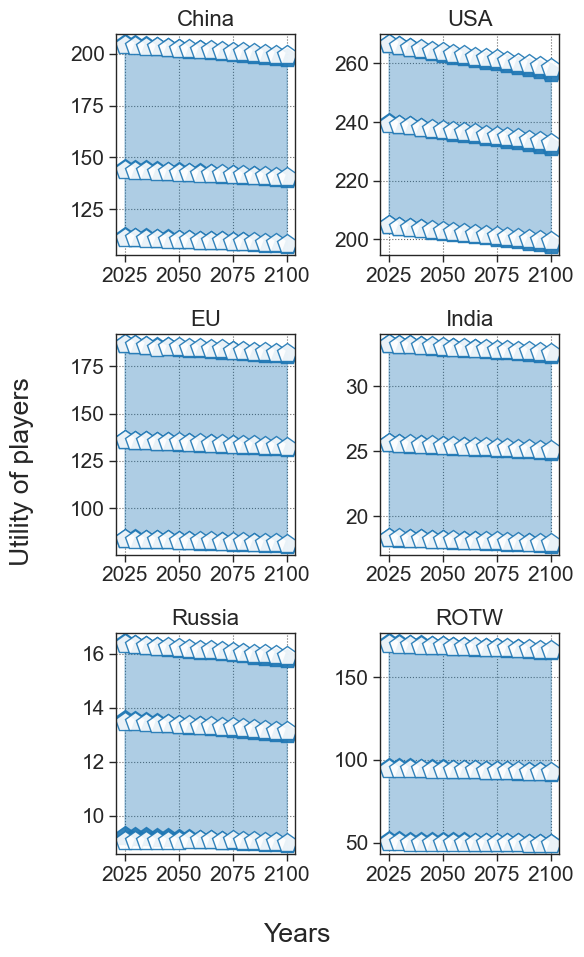

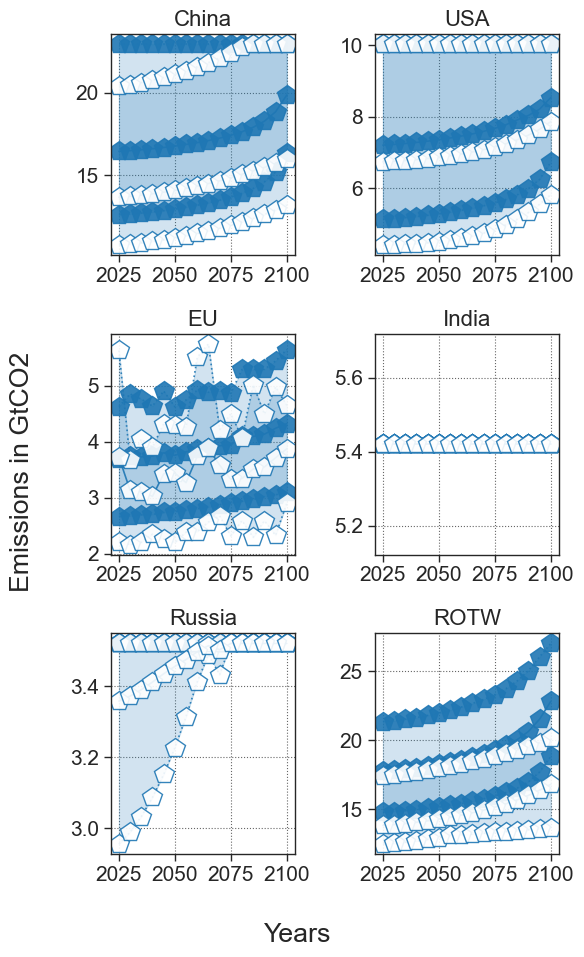

In [131]:
plots_noise(res_ne, res_so, NOISE, 'test_plot', list_label=list_label, case = 'classic_sigmoid')

In [ ]:
import numpy as np
from pathlib import Path

def plots_noise(res, noise, directory, list_label, case='', title='', X=X, figsize=None, horizon=None):

    Path(f"{directory}/{case}").mkdir(parents=True, exist_ok=True)
    directory = f"{directory}/{case}"

    def update_prop(handle, orig):
        handle.update_from(orig)
        handle.set_marker("")

    if figsize is None:
        figsize = {'figsize': FIG_SIZE}
    
    param_fig = {} | figsize
    param_legend = {'ncol': 2}

    def calculate_bounds(data, idx):
        dumy_up = np.zeros_like(data[idx][0])
        dumy_low = np.ones_like(data[idx][0]) * np.infty
        for arr in data[idx]:
            dumy_up = np.maximum(dumy_up,arr)
            dumy_low = np.minimum(dumy_low,arr)
        return dumy_low, dumy_up


    fill_bounds = [calculate_bounds(res_, 1) for res_ in res]
    array_list = [[np.mean(res_[1], axis=0)] for res_ in res]
    plot_kwargs_list = None
    label_list = [r'SNR = {}'.format(nois) for nois in noise]

    title = 'Sum of action under perturbation of the Climate model of the players with some noise'
    xlabel = 'Years'
    ylabel = 'Annual Global CO2 Emissions (GtCO2)'
    save_file = f"{directory}/Annual_Global_CO2_Emission_planning_{case}_{horizon}"
    multi_parallel_plot(array_list=array_list,
                        X=X,
                        plot_kwargs_list=plot_kwargs_list,
                        label_list=label_list,
                        title=title,
                        xlabel=xlabel,
                        ylabel=ylabel,
                        save_file=save_file,
                        param_fig=param_fig,
                        param_legend=param_legend,
                        fill=fill_bounds,
                        step=False)

    array_list = [[np.mean(res_[3], axis=0)] for res_ in res]
    title = 'Sum of GDP under perturbation of the Climate model of the players with some noise'
    xlabel = 'Years'
    ylabel = r'Annual World Utility $\bar{u}_t$ in  $10^{10}$\$ 2011'
    save_file = f"{directory}/Annual_World_Utility_planning_{case}_{horizon}"
    multi_parallel_plot(array_list=array_list,
                        X=X,
                        plot_kwargs_list=plot_kwargs_list,
                        label_list=label_list,
                        title=title,
                        xlabel=xlabel,
                        ylabel=ylabel,
                        save_file=save_file,
                        param_fig=param_fig,
                        param_legend=param_legend,
                        fill=fill_bounds,
                        step=False)

    array_list = [[np.mean(res_[-1], axis=0)] for res_ in res]
    fill_bounds = [calculate_bounds(res_, -1) for res_ in res]

    title = 'Global Mean Temperature variation from 1900 (°C) under perturbation of the Climate model of the players with some noise'
    xlabel = 'Years'
    ylabel = 'Temperature variation'
    save_file = f"{directory}/Global_Mean_Temperature_planning_{case}_{horizon}"
    multi_parallel_plot(array_list=array_list,
                        X=X,
                        plot_kwargs_list=plot_kwargs_list,
                        label_list=label_list,
                        title=title,
                        xlabel=xlabel,
                        ylabel=ylabel,
                        save_file=save_file,
                        param_fig=param_fig,
                        param_legend=param_legend,
                        fill=fill_bounds,
                        step=False)

    n_row = 3
    n_col = 2
    temp0, temp1 = figsize
    tfigsize = (temp1, temp0)
    ac = np.array([list(zip(*res_[2])) for res_ in res])
    ac = np.moveaxis(ac, [0, 1], [1, 0])
    fig, axes = plt.subplots(n_row, n_col, dpi=100, figsize=(temp1, temp0))
    k = 0
    for row in range(n_row):
        for col in range(n_col):
            array_list = ac[k]
            fill_bounds = [calculate_bounds(acc) for acc in ac[k]]
            title = NAMES[k]
            axes[row, col] = multi_parallel_plot(ax=axes[row, col],
                                                 X=X,
                                                 array_list=array_list,
                                                 title=title,
                                                 fill=fill_bounds,
                                                 param_legend=param_legend,
                                                 param_fig=param_fig)
            xticks = ticker.MaxNLocator(M)
            axes[row, col].xaxis.set_major_locator(xticks)
            k += 1
    fig.supylabel('Utility of players')
    fig.supxlabel('Years')
    save_file = f"{directory}/Utilities_planning_{case}_{horizon}.pdf"
    plt.savefig(fname=save_file, format='pdf')
    plt.show()

    ac = np.array([list(zip(*res_[0])) for res_ in res])
    ac = np.moveaxis(ac, [0, 1], [1, 0])
    fig, axes = plt.subplots(n_row, n_col, dpi=100, figsize=(temp1, temp0))
    k = 0
    for row in range(n_row):
        for col in range(n_col):
            array_list = ac[k]
            fill_bounds = [calculate_bounds(acc) for acc in ac[k]]
            title = NAMES[k]
            axes[row, col] = multi_parallel_plot(ax=axes[row, col],
                                                 X=X,
                                                 array_list=array_list,
                                                 title=title,
                                                 fill=fill_bounds,
                                                 param_legend=param_legend,
                                                 param_fig=param_fig)
            xticks = ticker.MaxNLocator(M)
            axes[row, col].xaxis.set_major_locator(xticks)
            k += 1
    fig.supylabel('Emissions in GtCO2')
    fig.supxlabel('Years')
    save_file = f"{directory}/Actions_planning_{case}_{horizon}.pdf"
    plt.savefig(fname=save_file, format='pdf')
    plt.show()


In [49]:
import numpy as np
from pathlib import Path

def plots_noise_v2(res, res_so, noise, directory, list_label, case='', title='', X=X, figsize=None, horizon=None):

    Path(f"{directory}/{case}").mkdir(parents=True, exist_ok=True)
    directory = f"{directory}/{case}"

    def update_prop(handle, orig):
        handle.update_from(orig)
        handle.set_marker("")

    if figsize is None:
        figsize = {'figsize': FIG_SIZE}
    
    param_fig = {} | figsize
    param_legend = {'ncol': 2}

    def calculate_bounds(data):
        fill_up = np.max(data, axis=0)
        fill_low = np.min(data, axis=0)
        return fill_low, fill_up

    fill_bounds = [calculate_bounds(res_) for res_ in res]
    array_list = [[[np.mean(res_[1], axis=0)] for res_ in res], [[np.mean(res_[1], axis=0)] for res_ in res_so]]
    plot_kwargs_list = None
    label_list = [r'SNR = {}'.format(nois) for nois in noise]

    title = 'Sum of action under perturbation of the Climate model of the players with some noise'
    xlabel = 'Years'
    ylabel = 'Annual Global CO2 Emissions (GtCO2)'
    save_file = f"{directory}/Annual_Global_CO2_Emission_planning_{case}_{horizon}"
    multi_parallel_plot(array_list=array_list,
                        X=X,
                        plot_kwargs_list=plot_kwargs_list,
                        label_list=label_list,
                        title=title,
                        xlabel=xlabel,
                        ylabel=ylabel,
                        save_file=save_file,
                        param_fig=param_fig,
                        param_legend=param_legend,
                        fill=fill_bounds,
                        step=False)

    array_list = [[np.mean(res_[3], axis=0)] for res_ in res]
    title = 'Sum of GDP under perturbation of the Climate model of the players with some noise'
    xlabel = 'Years'
    ylabel = r'Annual World Utility $\bar{u}_t$ in  $10^{10}$\$ 2011'
    save_file = f"{directory}/Annual_World_Utility_planning_{case}_{horizon}"
    multi_parallel_plot(array_list=array_list,
                        X=X,
                        plot_kwargs_list=plot_kwargs_list,
                        label_list=label_list,
                        title=title,
                        xlabel=xlabel,
                        ylabel=ylabel,
                        save_file=save_file,
                        param_fig=param_fig,
                        param_legend=param_legend,
                        fill=fill_bounds,
                        step=False)

    array_list = [[np.mean(res_[-1], axis=0)] for res_ in res]
    title = 'Global Mean Temperature variation from 1900 (°C) under perturbation of the Climate model of the players with some noise'
    xlabel = 'Years'
    ylabel = 'Temperature variation'
    save_file = f"{directory}/Global_Mean_Temperature_planning_{case}_{horizon}"
    multi_parallel_plot(array_list=array_list,
                        X=X,
                        plot_kwargs_list=plot_kwargs_list,
                        label_list=label_list,
                        title=title,
                        xlabel=xlabel,
                        ylabel=ylabel,
                        save_file=save_file,
                        param_fig=param_fig,
                        param_legend=param_legend,
                        fill=fill_bounds,
                        step=False)

    n_row = 3
    n_col = 2
    temp0, temp1 = figsize
    tfigsize = (temp1, temp0)
    ac = np.array([list(zip(*res_[2])) for res_ in res])
    ac = np.moveaxis(ac, [0, 1], [1, 0])
    fig, axes = plt.subplots(n_row, n_col, dpi=100, figsize=(temp1, temp0))
    k = 0
    for row in range(n_row):
        for col in range(n_col):
            array_list = ac[k]
            fill_bounds = [calculate_bounds(acc) for acc in ac[k]]
            title = NAMES[k]
            axes[row, col] = multi_parallel_plot(ax=axes[row, col],
                                                 X=X,
                                                 array_list=array_list,
                                                 title=title,
                                                 fill=fill_bounds,
                                                 param_legend=param_legend,
                                                 param_fig=param_fig)
            xticks = ticker.MaxNLocator(M)
            axes[row, col].xaxis.set_major_locator(xticks)
            k += 1
    fig.supylabel('Utility of players')
    fig.supxlabel('Years')
    save_file = f"{directory}/Utilities_planning_{case}_{horizon}.pdf"
    plt.savefig(fname=save_file, format='pdf')
    plt.show()

    ac = np.array([list(zip(*res_[0])) for res_ in res])
    ac = np.moveaxis(ac, [0, 1], [1, 0])
    fig, axes = plt.subplots(n_row, n_col, dpi=100, figsize=(temp1, temp0))
    k = 0
    for row in range(n_row):
        for col in range(n_col):
            array_list = ac[k]
            fill_bounds = [calculate_bounds(acc) for acc in ac[k]]
            title = NAMES[k]
            axes[row, col] = multi_parallel_plot(ax=axes[row, col],
                                                 X=X,
                                                 array_list=array_list,
                                                 title=title,
                                                 fill=fill_bounds,
                                                 param_legend=param_legend,
                                                 param_fig=param_fig)
            xticks = ticker.MaxNLocator(M)
            axes[row, col].xaxis.set_major_locator(xticks)
            k += 1
    fig.supylabel('Emissions in GtCO2')
    fig.supxlabel('Years')
    save_file = f"{directory}/Actions_planning_{case}_{horizon}.pdf"
    plt.savefig(fname=save_file, format='pdf')
    plt.show()


In [8]:
import numpy as np

def add_noise(snr_dB, signal):
    # Convert SNR from decibels to linear scale
    snr_linear = 10**(snr_dB / 10.0)
    try :
        l = len(signal)
    except :
        l = 1
    # Calculate signal power
    signal_power = np.sum(signal**2) / l
    
    # Calculate noise power based on SNR
    noise_power = signal_power / snr_linear
    
    # Generate noise with the same shape as the signal
    noise = np.random.normal(0, np.sqrt(noise_power), signal.shape)
    
    # Add noise to the signal
    noisy_signal = signal + noise
    
    return noisy_signal


In [9]:
import numpy as np

def add_noise_scalar(snr_dB, signal):
    # Convert SNR from decibels to linear scale
    snr_linear = 10**(snr_dB / 10.0)
    
    # Calculate signal power
    signal_power = signal**2
    
    # Calculate noise power based on SNR
    noise_power = signal_power / snr_linear
    
    # Generate noise with the same shape as the signal
    noise = np.random.normal(0, np.sqrt(noise_power), signal.shape )
    
    # Add noise to the signal
    noisy_signal = signal + noise

    # Apply additional conditions to keep values within the desired range
    # noisy_signal = np.where(noisy_signal < 0, 0, noisy_signal)
    # noisy_signal = np.where(noisy_signal > 1, 1, noisy_signal)
    noisy_signal = np.where(signal == 0, 0, noisy_signal)
    noisy_signal = np.where(signal == 1, 1, noisy_signal)
    
    
    return noisy_signal


In [10]:
def noise_climate_model(noise, game :Game, on_game = False):
    game = deepcopy(game)
    if on_game :
        new_diag = np.diag(game.scm_game.carbon_model.Ac)[1:]
        new_diag_ = [1] + [add_noise(noise, e) for e in new_diag]
        noise_diag = np.array(new_diag_)
        game.scm_game.carbon_model.Ac = np.diag(noise_diag)
        
        new_diag = np.diag(game.scm_game.temperature_model.At)
        noise_diag = np.array([add_noise(noise, e) for e in new_diag])
        game.scm_game.temperature_model.At = np.diag(noise_diag)

    for player in game.list_players:
        player.scm.carbon_model.Ac = add_noise_scalar(noise, player.scm.carbon_model.Ac)
        player.scm.temperature_model.At = add_noise_scalar(noise, player.scm.temperature_model.At)
    return game

In [11]:
def noise_benefit(noise, e, r):
    game = deepcopy(game)

    for player in game.list_players:
        player.scm.carbon_model.Ac = add_noise_scalar(noise, player.scm.carbon_model.Ac)
        player.scm.temperature_model.At = add_noise_scalar(noise, player.scm.temperature_model.At)
    return game

In [12]:
def noise_climate_model_common(noise, game :Game, on_game = False):
    game = deepcopy(game)
    if on_game :
        new_diag = np.diag(game.scm_game.carbon_model.Ac)[1:]
        new_diag_ = [1] + [add_noise(noise, e) for e in new_diag]
        noise_diag = np.array(new_diag_)
        game.scm_game.carbon_model.Ac = np.diag(noise_diag)
        
        new_diag = np.diag(game.scm_game.temperature_model.At)
        noise_diag = np.array([add_noise(noise, e) for e in new_diag])
        game.scm_game.temperature_model.At = np.diag(noise_diag)
    noise_AC = add_noise_scalar(noise, game.scm_game.carbon_model.Ac)
    noise_AT = add_noise_scalar(noise, game.scm_game.temperature_model.At)
    for player in game.list_players:
        player.scm.carbon_model.Ac = noise_AC
        player.scm.temperature_model.At = noise_AT
    return game

In [13]:
from models.game_theory_model.damage_function import *
from utility.array_to_latex import array_to_latex

r = [1.15, 1.60, 2, 0.5, 1.25,0.75]
e = [2, -2, -5, -4, -5, 2.5]

# Action set doubled

r = [0.70, 1, 2, 0.5, 1.25,0.45]
e = [3, -1, -5, -4, -5, 2.5]

horizon = 2100

X = 2025 + np.arange((horizon-2020)//5  )*5

list_t_piece = np.arange(1,T,4)


list_damage_coef = [
    # np.array([0,0,1]), 
    np.array([0,0.25,0.16]),
    # np.array([0,-0.5,1.1]), 
    # np.array([0,0,1.1450]), 
    # np.array([0,0,0,0,1])
]

list_damage_function = [partial(damage_polynome, coefficients = coef) for coef in list_damage_coef]# + [damage_exponential(np.array([1,0.25]))]

 #,  
list_alpha = [
    # 1,
    1.5,
    # 2
]
list_list_benefit_functions = [[partial(benefit_sigm, e=e[i], r = r[i]) for i in range(len(BENEFITS_SIGMOID))],
                            #    BENEFITS_LOG
                               ]
list_label_benefit_function = [
                        ('Sigmoid', '-'), 
                        # ('log', '-')
                        ]

list_damage_label = [array_to_latex(coef) for coef in list_damage_coef]

case = 'sigmoid'
list_param = list(product(list_damage_function, list_alpha, list_list_benefit_functions))
list_label = list(product(list_damage_label, list_alpha, list_label_benefit_function))


In [14]:
alpha = list_alpha[-1]
benef = list_list_benefit_functions[0]
coef = list_damage_coef[0]
damage = list_damage_function[0]

In [15]:
list_players = create_players(alpha=alpha, list_action_sets=ACTION_SETS, list_of_names=NAMES, list_benefit_functions=benef, damage_function=damage, discount=1)

game = Game(list_players, horizon=horizon)

In [16]:
def add_noise_to_keyword(player : player_class, noise_level):
    for keyword in player.benefit_shape.keywords:
        player.benefit_shape.keywords[keyword] = add_noise(noise_level, np.array(player.benefit_shape.keywords[keyword]))
    

In [17]:
def add_noise_to_player(player : player_class, noise_level):
    player.GDP_initial = add_noise(noise_level, np.array(player.GDP_initial))
    # player.action_set_initial[:,1] = add_noise(noise_level, player.action_set_initial[:,1])

    for keyword in player.benefit_shape.keywords:
        player.benefit_shape.keywords[keyword] = add_noise(noise_level, np.array(player.benefit_shape.keywords[keyword]))
        player.reset()

In [18]:
def add_noise_to_list_player(list_player : list[player_class], noise_level):
    for player in list_player:
        add_noise_to_player(player, noise_level)

In [19]:
def noise_game_with_benef(list_param, list_label, horizon, noise, temperature_target=None, final_multiplier=None):
    
    print('Running f(%s)' )

    noisy_results = []
    list_game = []

    # loop over parameter and label lists
    for param, label in zip(list_param, list_label):
        print('coef:', label[0], 'alpha:', label[1], 'function:', label[2][0])
        

        # create list of players
        damage, alpha, list_benefit_functions = param

            # create game instance

        all_temp = []
        for nois in noise : 


            noisy_ = []
            print('Noise: ', nois, 'dB')
            temps = []
            for _ in range(10): 
                list_players = create_players(alpha=alpha, list_benefit_functions=list_benefit_functions, damage_function=damage, discount=1)
                add_noise_to_list_player(list_players, nois)
                # print(list_players[0].action_set)
                temp = []
                game = Game(list_players, horizon=horizon)
                # print('0',  ll)

                # game = noise_climate_model( nois, game)
                # print('avant', ll - game.list_players[0].scm.temperature_model.At)
                rr  = game.planning_BRD_by_piece_return(game.T)
                # print(list_players[0].action_set - game.list_players[0].action_set)

                noisy_.append(game.planning_BRD_by_piece_return(game.T))
            #     print('apres', ll - game.list_players[0].scm.temperature_model.At)
                for player in game.list_players:
                    temp.append(player.scm.evaluate_trajectory(rr[1])[-1][-1])
                list_game.append(game)
                temps.append(temp)
            noisy_ = list(zip(*noisy_))
            all_temp.append(temps)
            noisy_results.append(noisy_)
        print('-----------------------------------------------------------')


    return noisy_results, all_temp, list_game

In [20]:
NOISE = [12]

In [21]:
res, all_temp, list_game = noise_game_with_benef(list_param, list_label, noise=NOISE, horizon=horizon)

Running f(%s)
coef: 0.16x^{2}+0.25x alpha: 1.5 function: Sigmoid
Noise:  12 dB


Planning BRD, t_piece = 16:   0%|          | 0/1 [00:00<?, ?it/s]

Planning BRD, t_piece = 16: 100%|██████████| 1/1 [00:01<00:00,  1.79s/it]

-----------------------------------------------------------


In [31]:
for i in range(10):
    print(list_game[i].list_players[0].action_set[:,1])

[22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94
 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94
 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94]
[22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94
 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94
 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94]
[22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94
 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94
 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94]
[22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94
 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94
 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94]
[22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94
 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94
 22.94 22.94 22.94 22.94 22.94 22.94 22.94 22.94]
[22.94 22.94 22.94 2

In [33]:
plots_noise(res, NOISE, 'test_plot', list_label=list_label, case = 'classic_sigmoid')

TypeError: plots_noise() missing 1 required positional argument: 'directory'

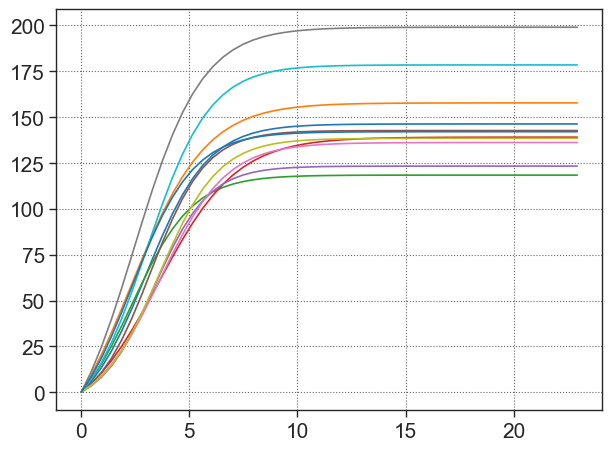

In [34]:
player = deepcopy(game.list_players[0])
x = np.linspace(*player.action_set[0])



noise = 15
plt.plot(x,player.benefit(x, t=0))
for _ in range(10):
    player = deepcopy(game.list_players[0])

    add_noise_to_player(player, noise)
    x = np.linspace(*player.action_set[0])

    # player.benefit_shape.keywords['e'] = add_noise(20,np.array(player.benefit_shape.keywords['e']) )
    plt.plot(x,player.benefit(x, t=0))
    # print(player.action_set[0,1])
    # print(player.GDP_max)
plt.show()

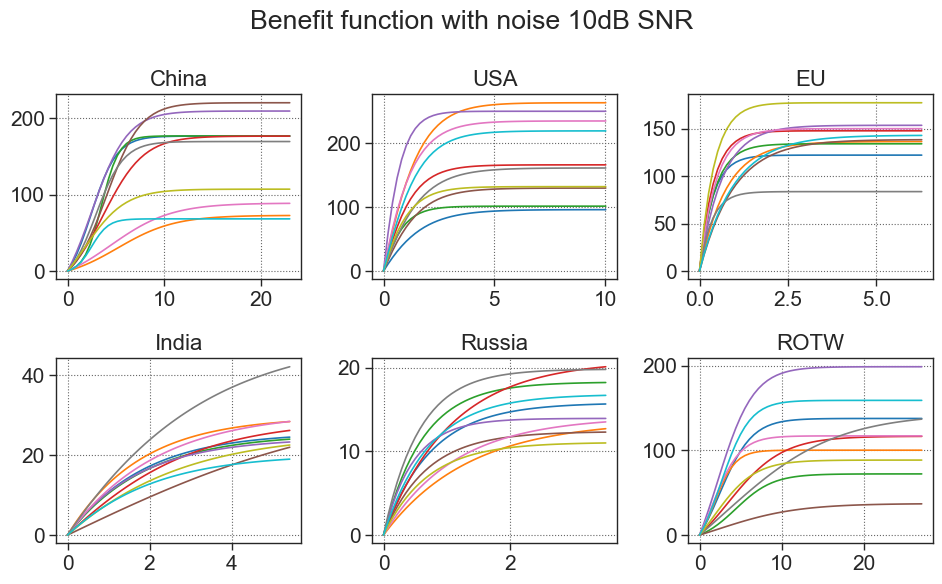

In [39]:

noise = 10
fig, axs = plt.subplots(2,3, figsize= figsize)
axs = axs.flatten()
for _ in range(10):
    list_players = deepcopy(game.list_players)
    add_noise_to_list_player(list_players, noise)
    for idx, player in enumerate(list_players) :
        ax = axs[idx]
        x = np.linspace(*player.action_set[0])
        ax.plot(x, player.benefit(x, t=0))
        ax.set_title(player.name)
plt.suptitle('Benefit function with noise 10dB SNR')
plt.show()

In [40]:
def noise_game(list_param, list_label, horizon, noise, temperature_target=None, final_multiplier=None):
    
    print('Running f(%s)' )

    noisy_results = []

    # loop over parameter and label lists
    for param, label in zip(list_param, list_label):
        print('coef:', label[0], 'alpha:', label[1], 'function:', label[2][0])
        

        # create list of players
        damage_coef, alpha, list_benefit_functions = param
        list_players = create_players(alpha=alpha, list_benefit_functions=list_benefit_functions, damage_function=damage_polynome(damage_coef), discount=1)

            # create game instance

        all_temp = []
        for nois in noise : 
            noisy_ = []
            print('Noise: ', nois, 'dB')
            temps = []
            for _ in range(10): 
                temp = []
                game = Game(list_players, horizon=horizon, temperature_target=temperature_target, final_multiplier=final_multiplier)
                # print('0',  ll)

                game = noise_climate_model( nois, game)
                # print('avant', ll - game.list_players[0].scm.temperature_model.At)
                rr  = game.planning_BRD_by_piece_return(game.T)
                noisy_.append(game.planning_BRD_by_piece_return(game.T))
            #     print('apres', ll - game.list_players[0].scm.temperature_model.At)
                for player in game.list_players:
                    temp.append(player.scm.evaluate_trajectory(rr[1])[-1][-1])

                temps.append(temp)
            noisy_ = list(zip(*noisy_))
            all_temp.append(temps)
            noisy_results.append(noisy_)
        print('-----------------------------------------------------------')


    return noisy_results, all_temp

In [41]:
def noise_game_common(list_param, list_label, horizon, noise, temperature_target=None, final_multiplier=None):
    
    print('Running f(%s)' )

    noisy_results = []

    # loop over parameter and label lists
    for param, label in zip(list_param, list_label):
        print('coef:', label[0], 'alpha:', label[1], 'function:', label[2][0])
        

        # create list of players
        damage_coef, alpha, list_benefit_functions = param
        list_players = create_players(alpha=alpha, list_benefit_functions=list_benefit_functions, damage_function=damage_polynome(damage_coef), discount=1)

            # create game instance

        all_temp = []
        for nois in noise : 
            noisy_ = []
            print('Noise: ', nois, 'dB')
            temps = []
            for _ in range(10): 
                temp = []
                game = Game(list_players, horizon=horizon, temperature_target=temperature_target, final_multiplier=final_multiplier)
                # print('0',  ll)

                # game = noise_climate_model_common( nois, game)
                # print('avant', ll - game.list_players[0].scm.temperature_model.At)
                rr  = game.planning_BRD_by_piece_return(game.T)
                noisy_.append(game.planning_BRD_by_piece_return(game.T))
            #     print('apres', ll - game.list_players[0].scm.temperature_model.At)
                for player in game.list_players:
                    temp.append(player.scm.evaluate_trajectory(rr[1])[-1][-1])

                temps.append(temp)
            noisy_ = list(zip(*noisy_))
            all_temp.append(temps)
            noisy_results.append(noisy_)
        print('-----------------------------------------------------------')


    return noisy_results, all_temp

In [42]:
def noise_game_with_benef(list_param, list_label, horizon, noise, temperature_target=None, final_multiplier=None, nb_iteration = 5):
    
    print('Running f(%s)')
    noisy_results = []
    
    # Loop over parameter and label lists
    for param, label in zip(list_param, list_label):
        print('coef:', label[0], 'alpha:', label[1], 'function:', label[2][0])
        
        # Unpack parameters
        damage_coef, alpha, list_benefit_functions = param
        
        all_temp = []
        for nois in noise:
            noisy_ = []
            print('Noise: ', nois, 'dB')
            temps = []
            
            for _ in range(nb_iteration): 
                # Create list of players
                list_players = create_players(alpha=alpha, list_benefit_functions=list_benefit_functions, damage_function=damage_polynome(damage_coef), discount=1)
                add_noise_to_list_player(list_players, nois)
                temp = []
                
                # Create game instance
                game = Game(list_players, horizon=horizon, temperature_target=temperature_target, final_multiplier=final_multiplier)
                rr = game.planning_BRD_by_piece_return(game.T)
                noisy_.append(game.planning_BRD_by_piece_return(game.T))
                
                for player in game.list_players:
                    temp.append(player.scm.evaluate_trajectory(rr[1])[-1][-1])
                
                temps.append(temp)
            
            noisy_ = list(zip(*noisy_))
            all_temp.append(temps)
            noisy_results.append(noisy_)
        
        print('-----------------------------------------------------------')

    return noisy_results, all_temp, game


In [22]:
def noise_game_with_benef_ne_so(list_param, list_label, horizon, noise, temperature_target=None, final_multiplier=None):
    # self.ne_a_planning_brd_piece, self.ne_sum_a_planning_brd_piece, self.ne_u_planning_brd_piece, self.ne_sum_u_planning_brd_piece, self.ne_temp_planning_brd_piece
    print('Running f(%s)')
    noisy_results_ne = []
    noisy_results_so = []

    # Loop over parameter and label lists
    for param, label in zip(list_param, list_label):
        print('coef:', label[0], 'alpha:', label[1], 'function:', label[2][0])
        
        # Unpack parameters
        damage, alpha, list_benefit_functions = param
        
        all_temp = []
        for nois in noise:
            noisy_ne = []
            noisy_so = []
            print('Noise: ', nois, 'dB')
            temps = []
            
            for _ in range(5): 
                # Create list of players
                list_players = create_players(alpha=alpha, list_benefit_functions=list_benefit_functions, damage_function=damage, discount=1)
                add_noise_to_list_player(list_players, nois)
                temp = []
                
                # Create game instance
                game = Game(list_players, horizon=horizon)
                rr = game.planning_BRD_by_piece_return(game.T)
                noisy_ne.append(rr)
                rso = game.planning_SO_by_piece_return(game.T)
                noisy_so.append(rso)

                
                for player in game.list_players:
                    temp.append(player.scm.evaluate_trajectory(rr[1])[-1][-1])
                
                temps.append(temp)
            
            noisy_ne = list(zip(*noisy_ne))
            noisy_so = list(zip(*noisy_so))
            all_temp.append(temps)
            noisy_results_ne.append(noisy_ne)
            noisy_results_so.append(noisy_so)
        
        print('-----------------------------------------------------------')

    return noisy_results_ne, noisy_results_so, all_temp, game


In [75]:
NOISE = [10]

In [76]:
res_ne, res_so, all_temp, list_game = noise_game_with_benef_ne_so(list_param, list_label, noise=NOISE, horizon=horizon)

Running f(%s)
coef: 0.16x^{2}+0.25x alpha: 1.5 function: Sigmoid
Noise:  10 dB


Planning SO, t_piece = 16: 100%|██████████| 1/1 [00:01<00:00,  1.75s/it]

-----------------------------------------------------------


In [90]:
plots_noise(res_ne, res_so, NOISE, 'test_plot', list_label=list_label, case = 'classic_sigmoid')

TypeError: plots_noise() got multiple values for argument 'list_label'

In [21]:
res, all_temp = noise_game(list_param, list_label, noise=NOISE, horizon=horizon)

Running f(%s)
coef: 2x^{2}-2x alpha: 1 function: Sigmoid
Noise:  15 dB


Planning BRD, t_piece = 16:   0%|          | 0/1 [00:00<?, ?it/s]

Planning BRD, t_piece = 16: 100%|██████████| 1/1 [00:01<00:00,  1.16s/it]

-----------------------------------------------------------


In [22]:
np.array(res).shape

C:\Users\Anthony Couthures\AppData\Local\Temp\ipykernel_51932\447893967.py:1: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  np.array(res).shape


(1, 5, 10)

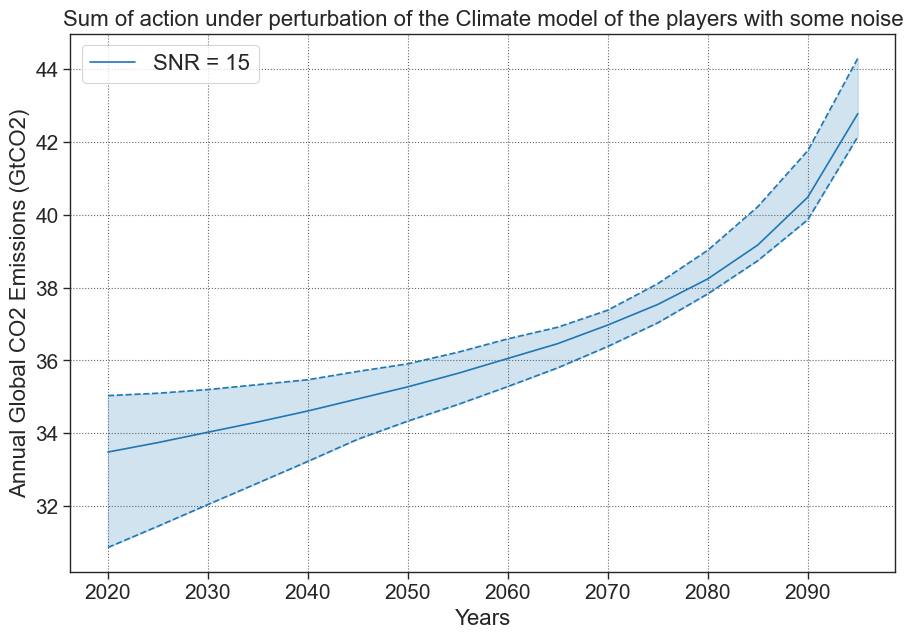

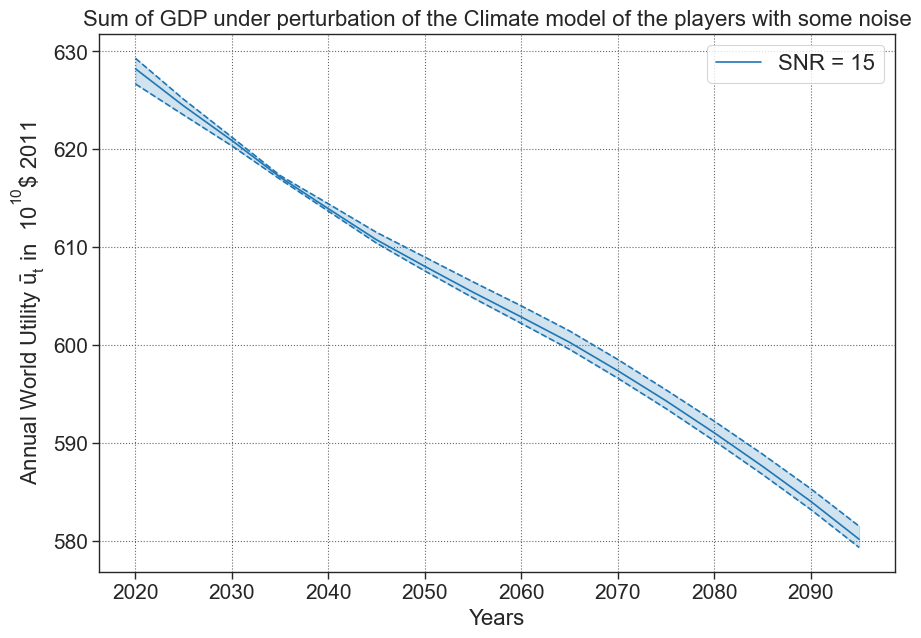

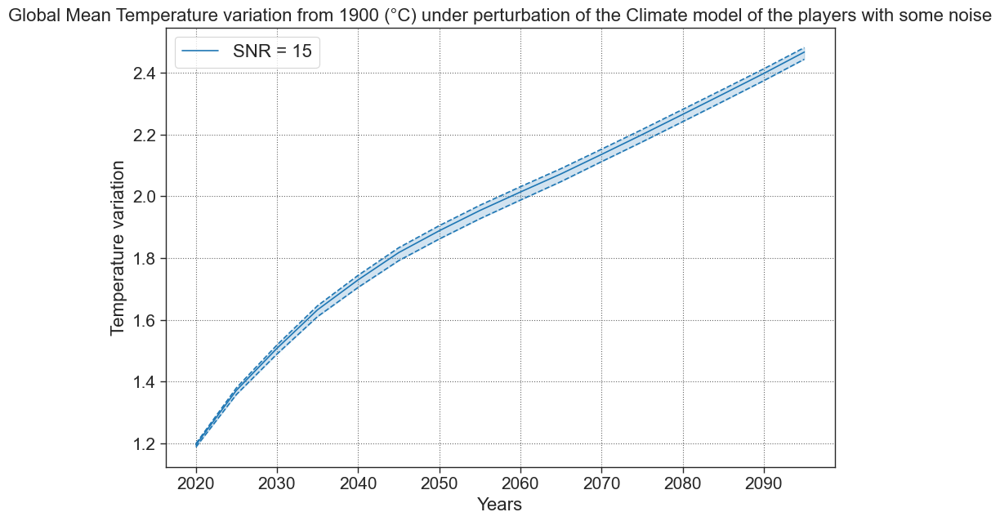

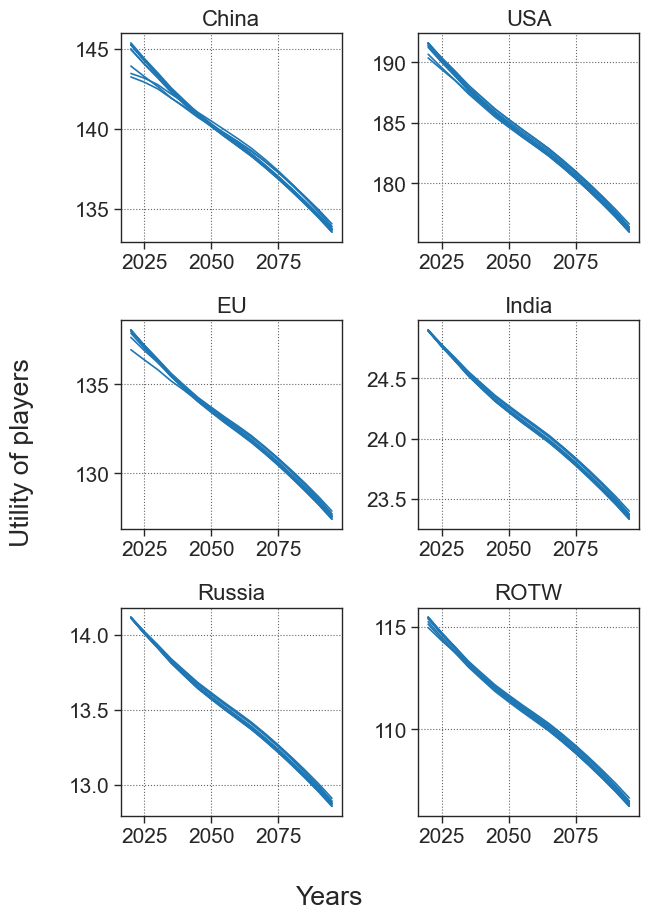

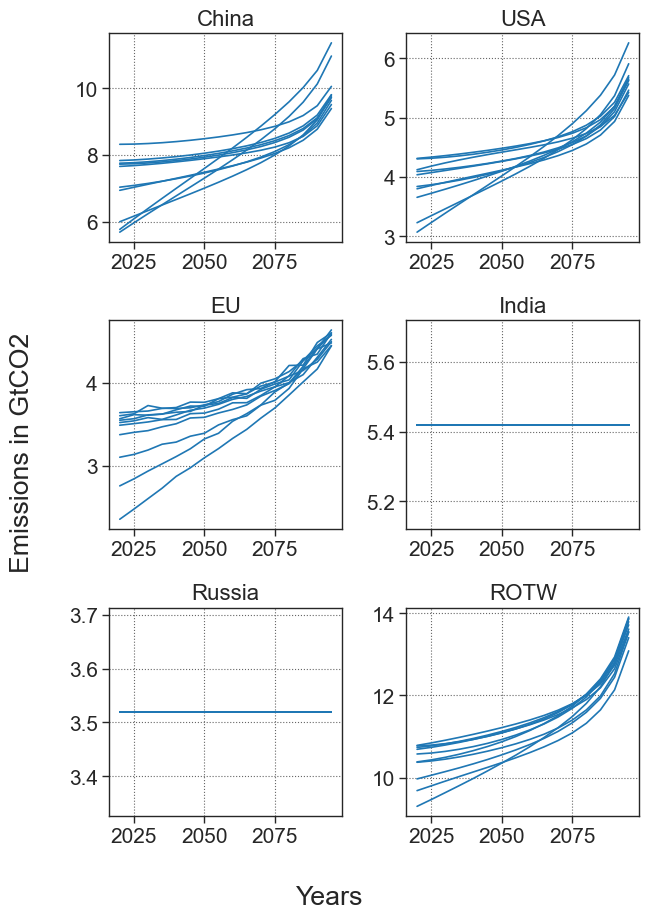

In [23]:
plots_noise(res, NOISE, 'test_plot', list_label=list_label, case = 'classic_sigmoid')

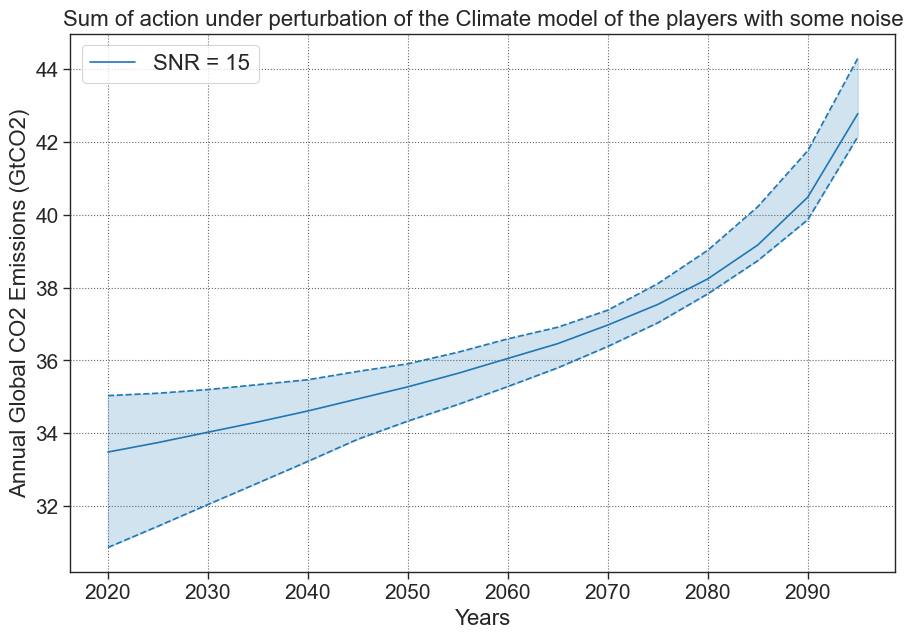

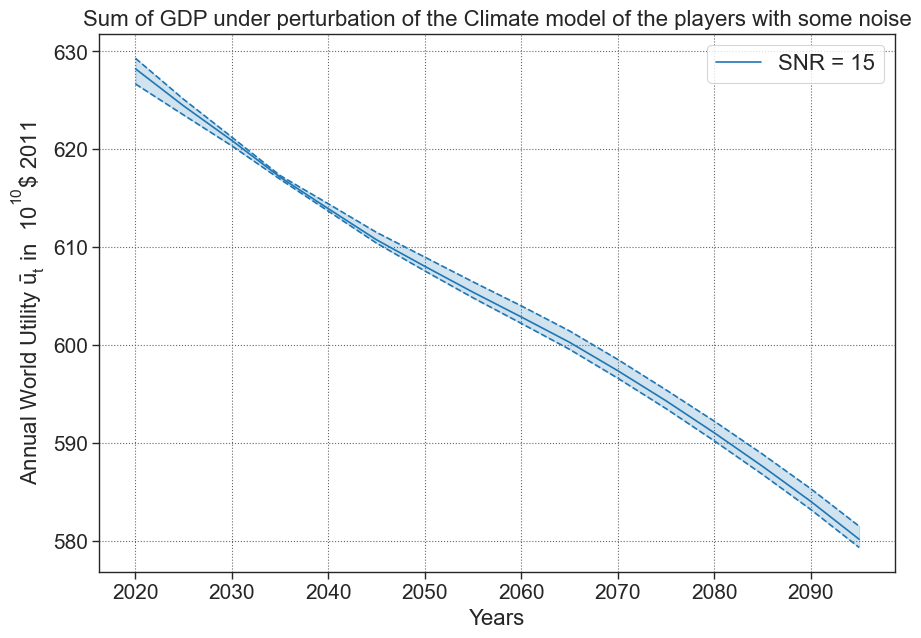

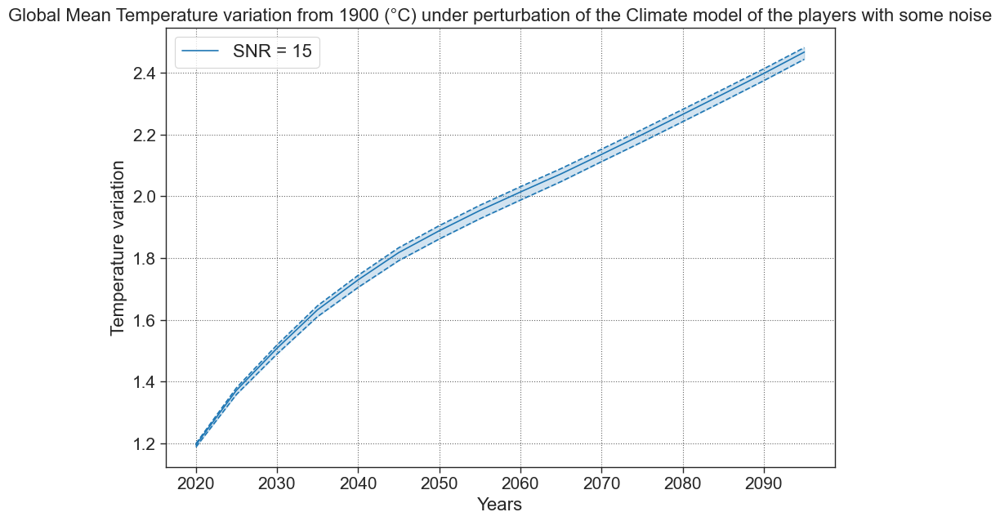

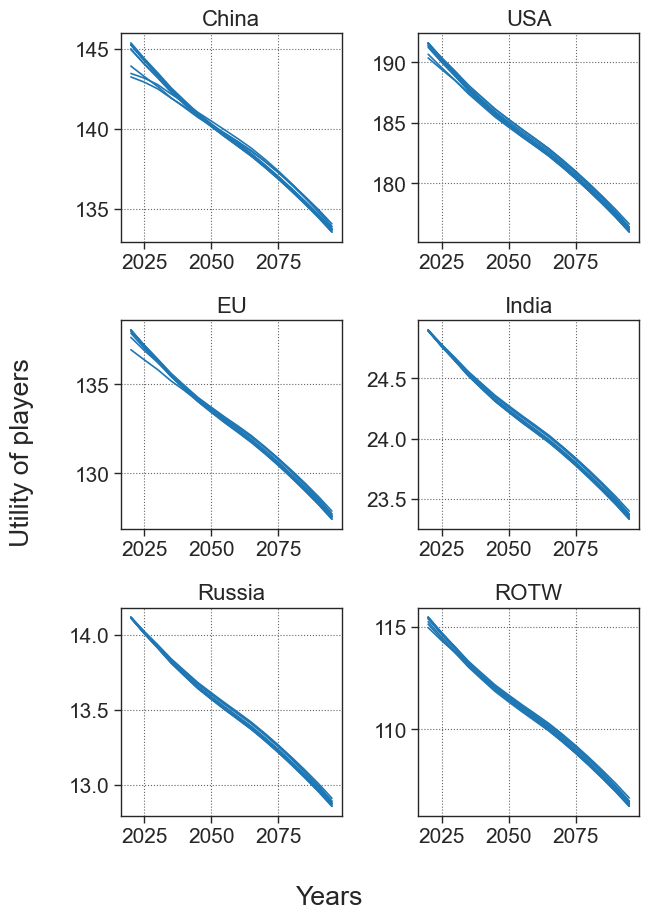

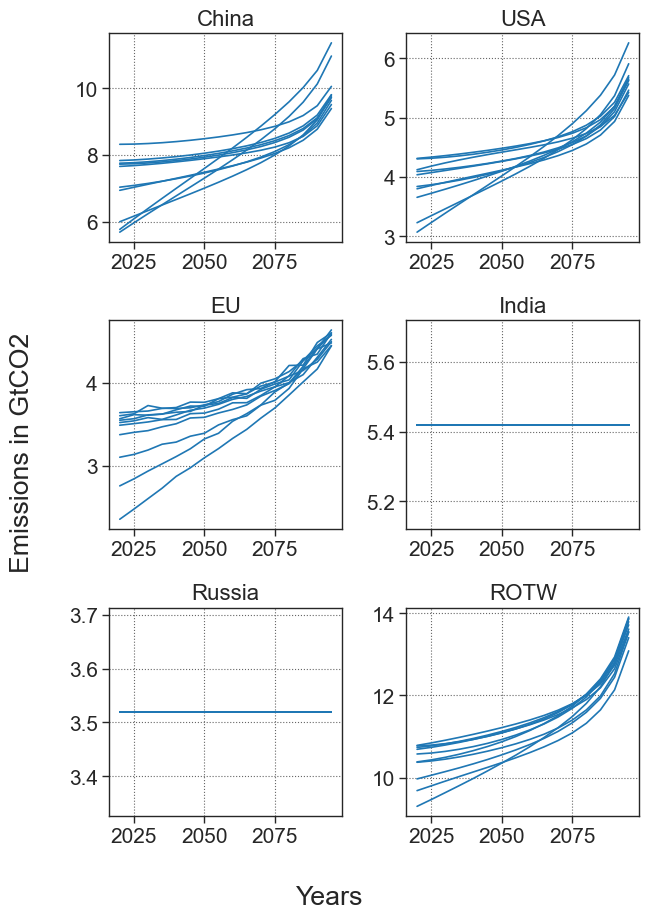

In [24]:
plots_noise(res, NOISE, 'test_plot', list_label=list_label, case = 'classic_sigmoid')

# INDIVIDUAL NOISE

## NOISE high

In [25]:
NOISE = [5] #, 10]


In [26]:
res, all_temp = noise_game(list_param, list_label, noise=NOISE, horizon=horizon)

Running f(%s)
coef: 2x^{2}-2x alpha: 1 function: Sigmoid
Noise:  5 dB


Planning BRD, t_piece = 16:   0%|          | 0/1 [00:00<?, ?it/s]c:\ProgramData\Anaconda3\envs\CO2\lib\site-packages\scipy\optimize\optimize.py:282: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
Planning BRD, t_piece = 16: 100%|██████████| 1/1 [00:01<00:00,  1.54s/it]

-----------------------------------------------------------


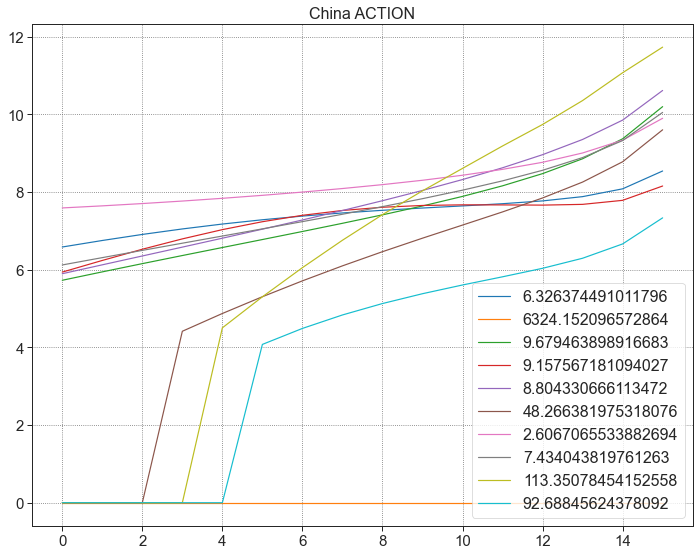

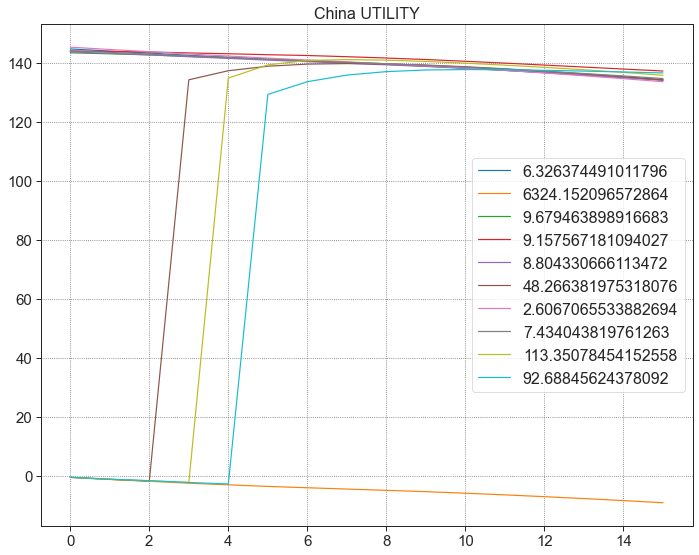

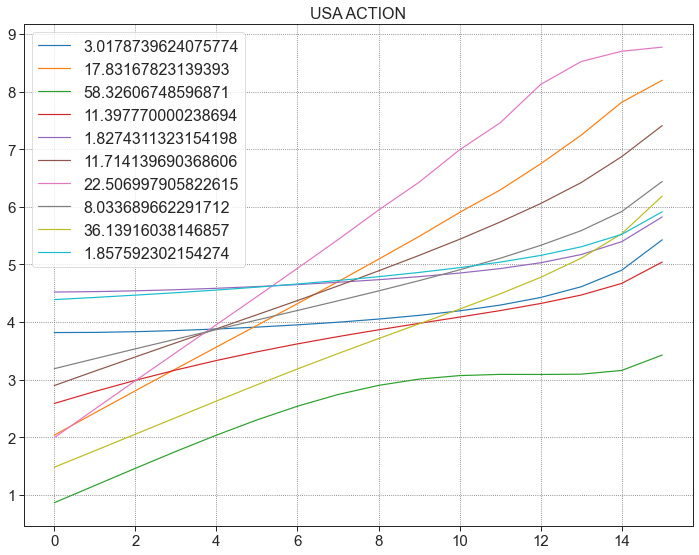

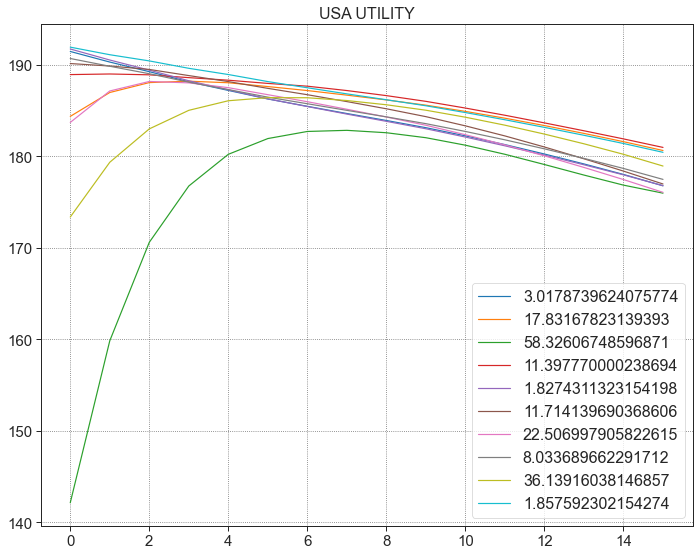

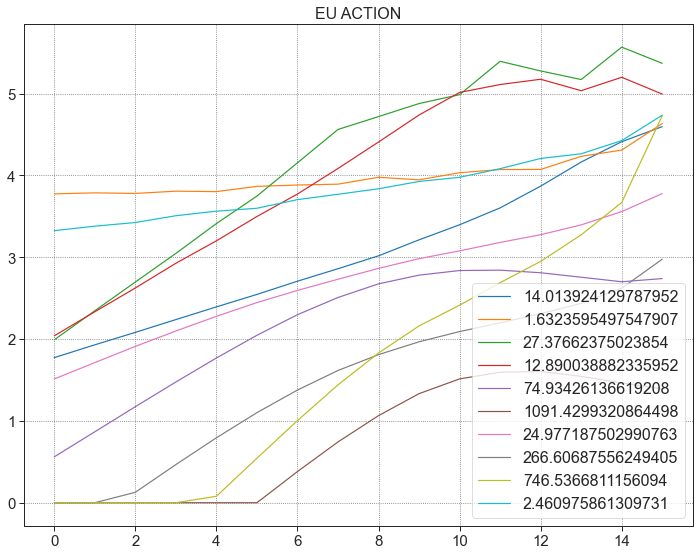

...

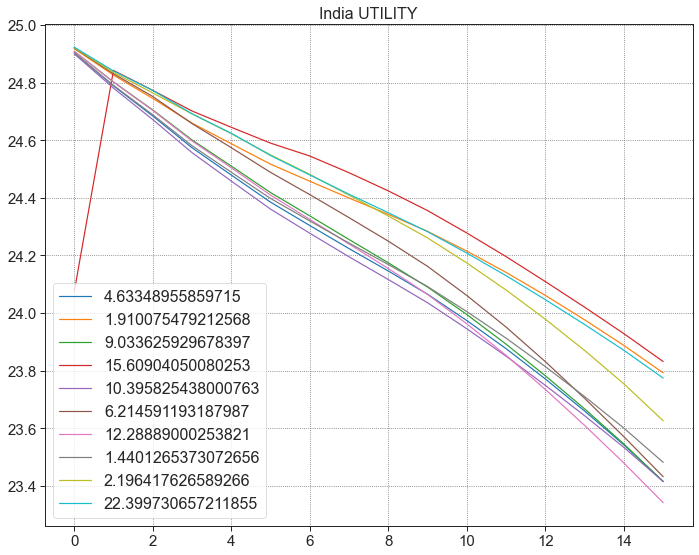

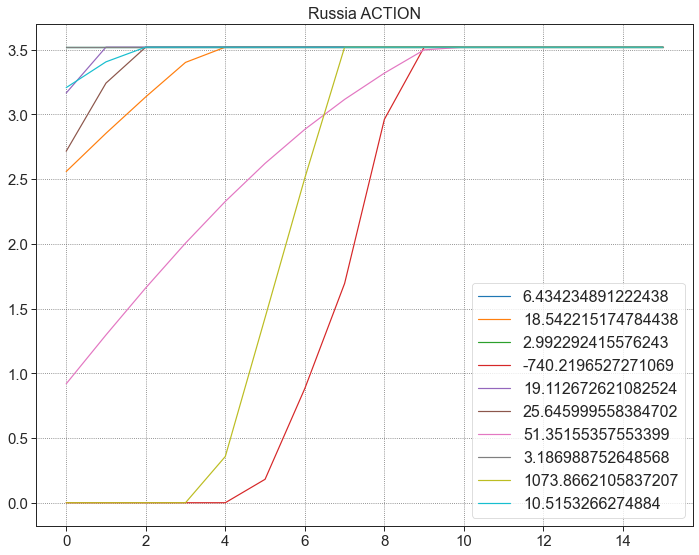

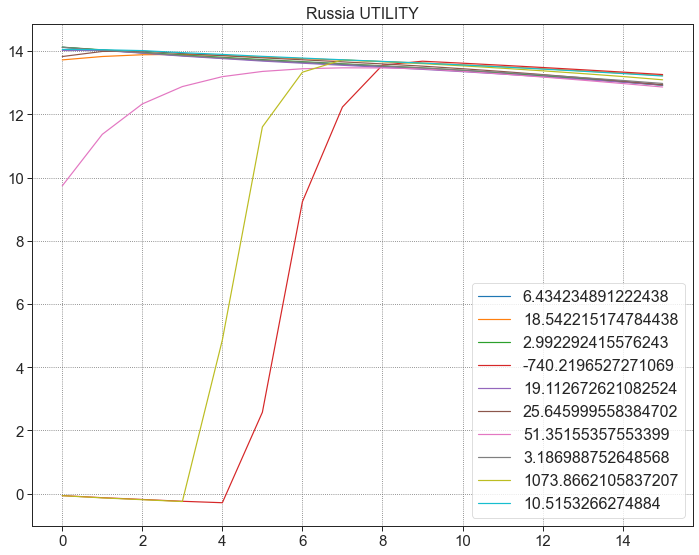

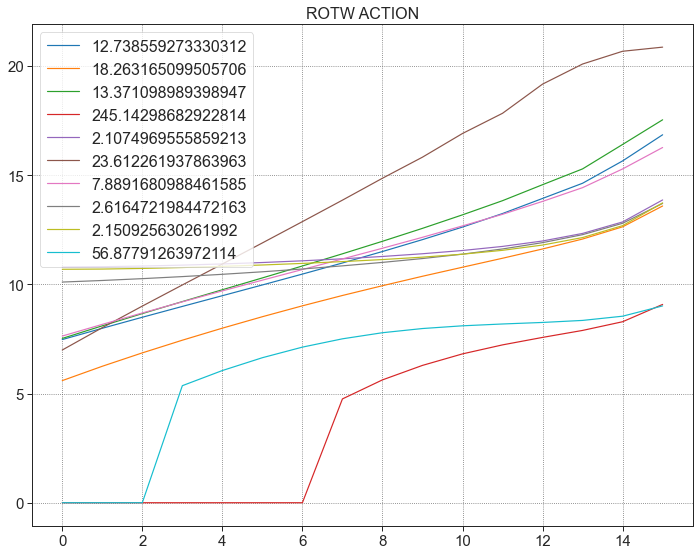

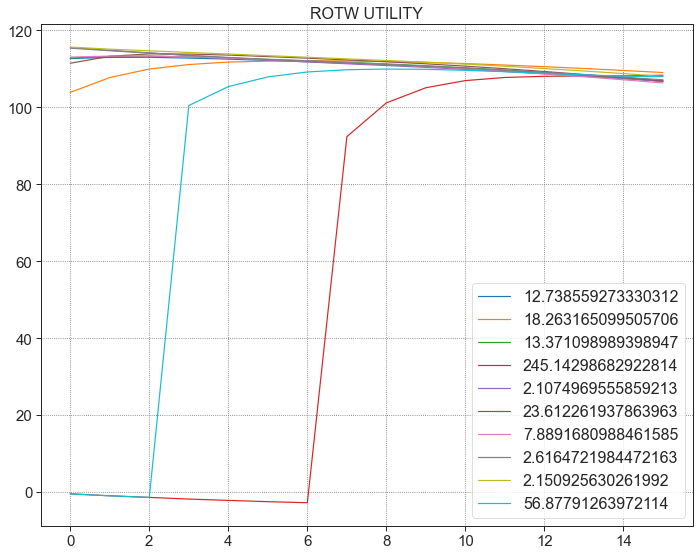

In [27]:
for l in range(N):

    plt.figure(figsize=(10,8))
    for k in range(10):

        plt.title(NAMES[l] + ' ACTION')
        plt.plot(res[0][0][k][l], label=all_temp[0][k][l])
    plt.legend()
    plt.show()

    plt.figure(figsize=(10,8))

    for k in range(10):
        plt.title(NAMES[l] + ' UTILITY')

        plt.plot(res[0][2][k][l], label=all_temp[0][k][l])
    plt.legend()

    plt.show()

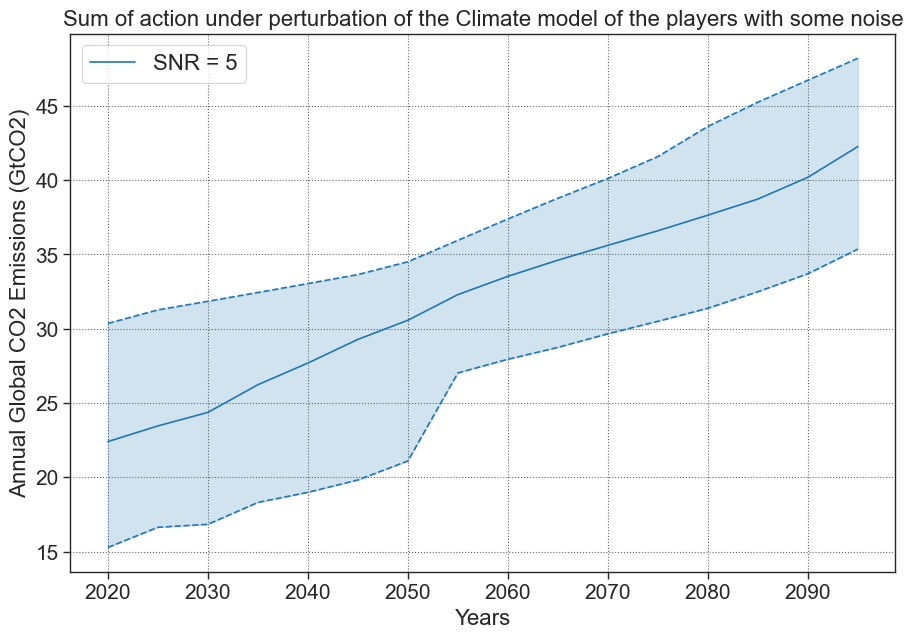

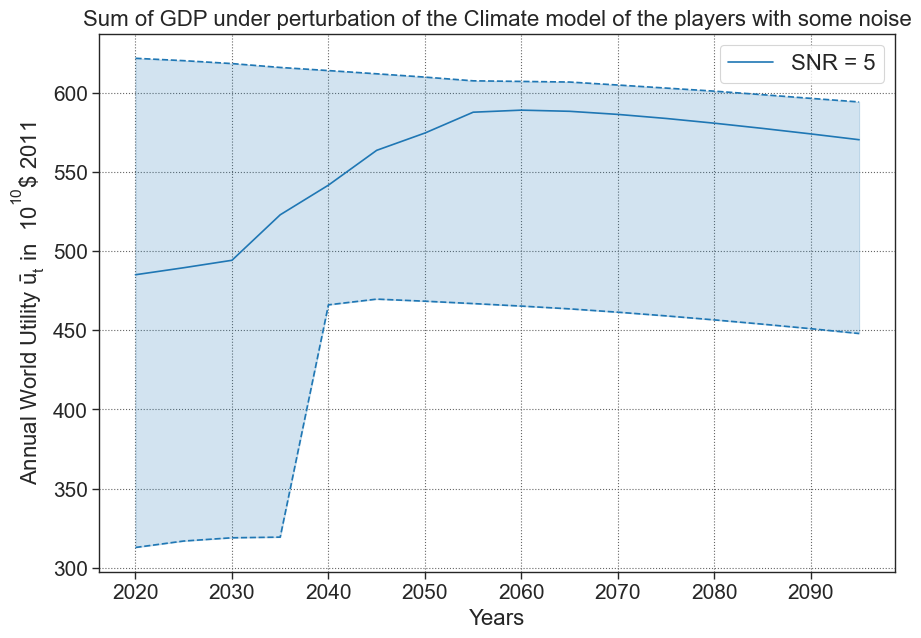

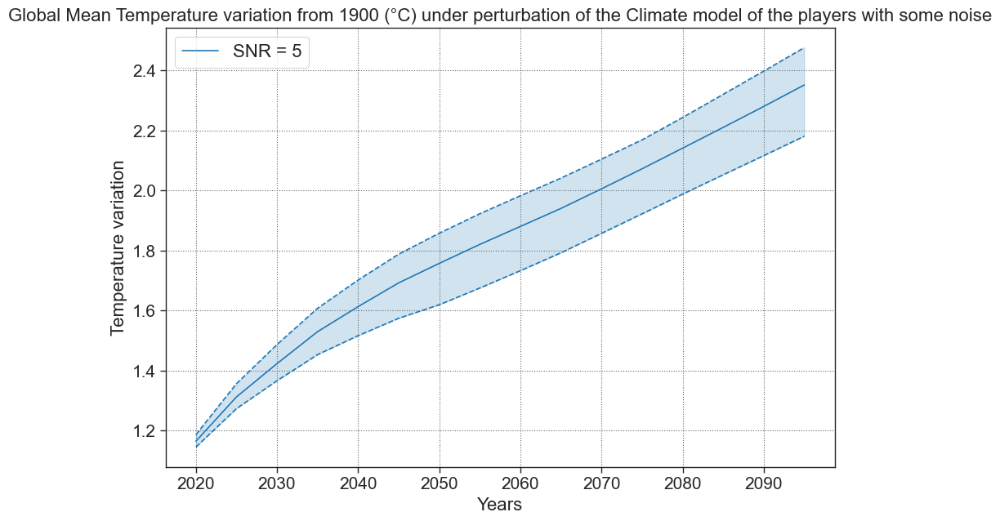

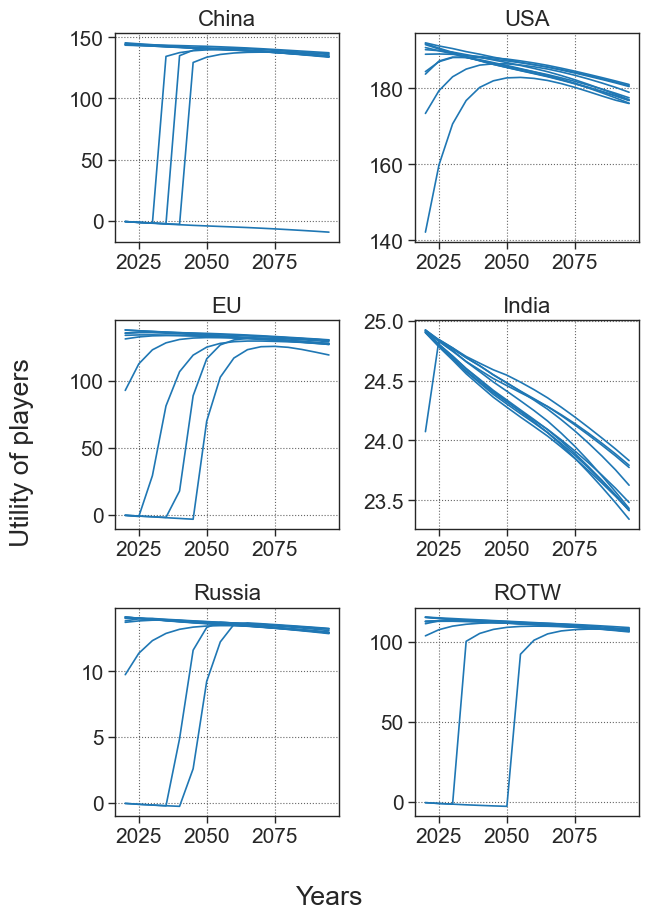

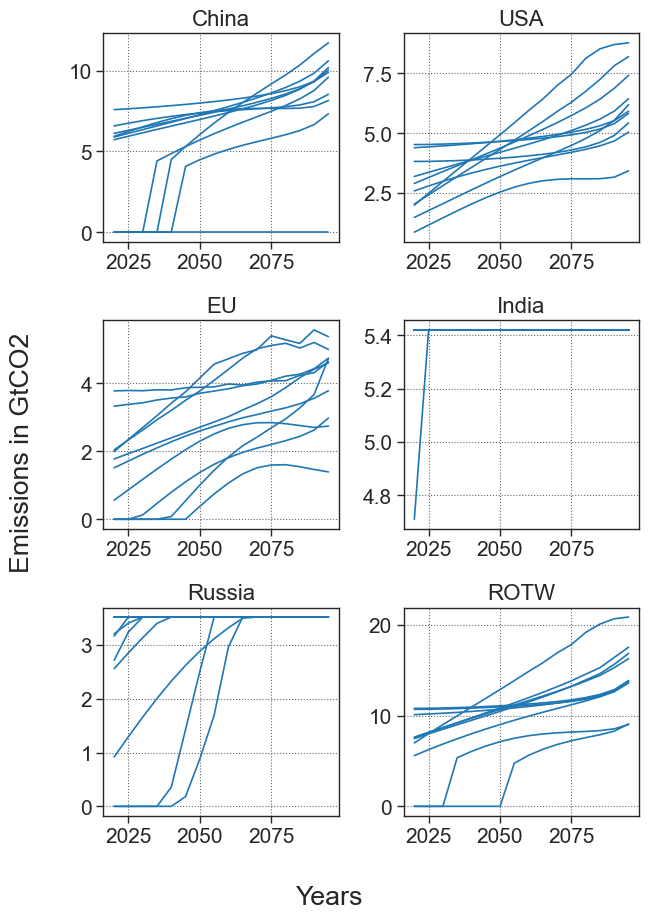

In [28]:
plots_noise(res, NOISE, 'test_plot', list_label=list_label, case = 'classic_sigmoid')

## NOISE low

In [29]:
NOISE = [20] #, 10]


In [30]:
res, all_temp = noise_game(list_param, list_label, noise=NOISE, horizon=horizon)

Running f(%s)
coef: 2x^{2}-2x alpha: 1 function: Sigmoid
Noise:  20 dB


Planning BRD, t_piece = 16: 100%|██████████| 1/1 [00:01<00:00,  1.09s/it]

-----------------------------------------------------------


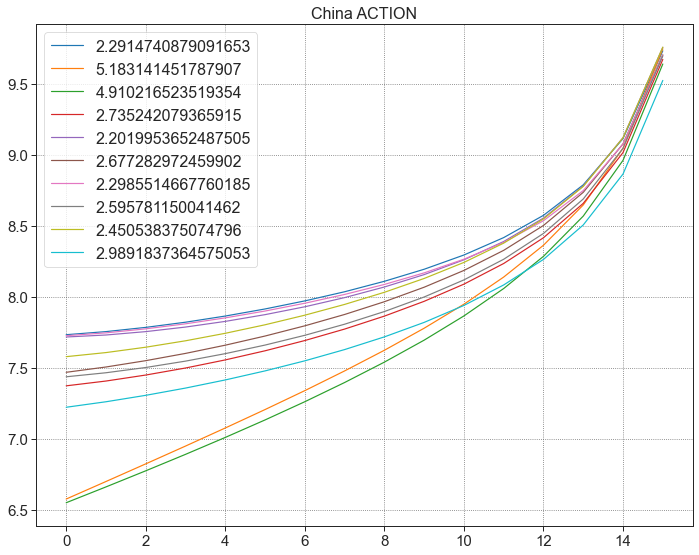

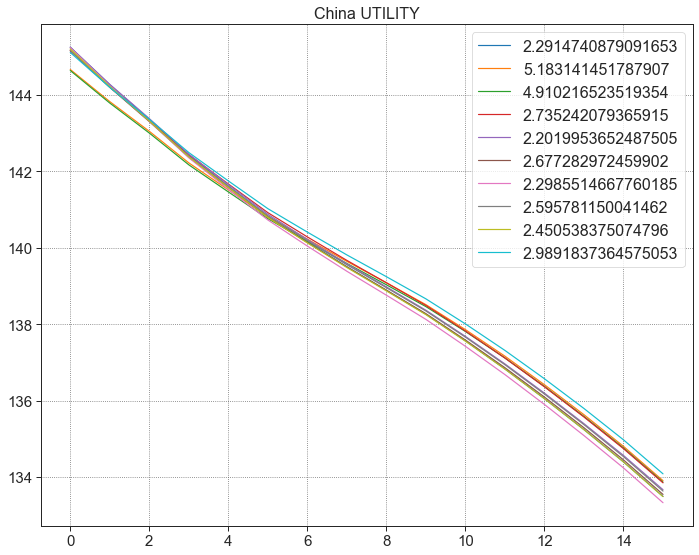

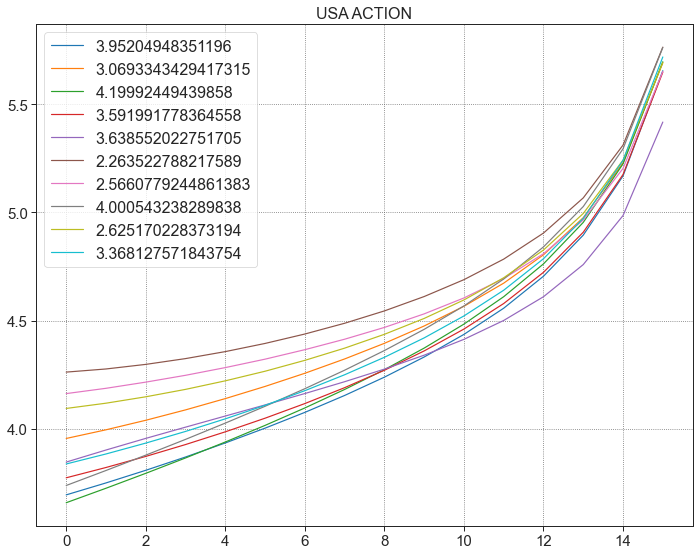

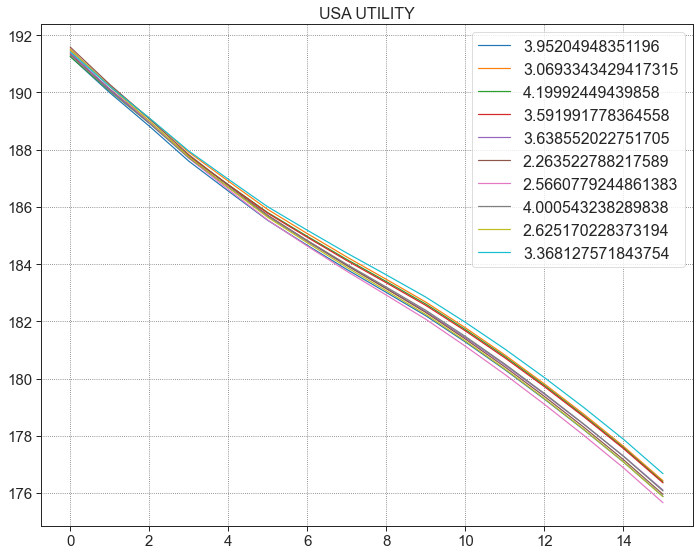

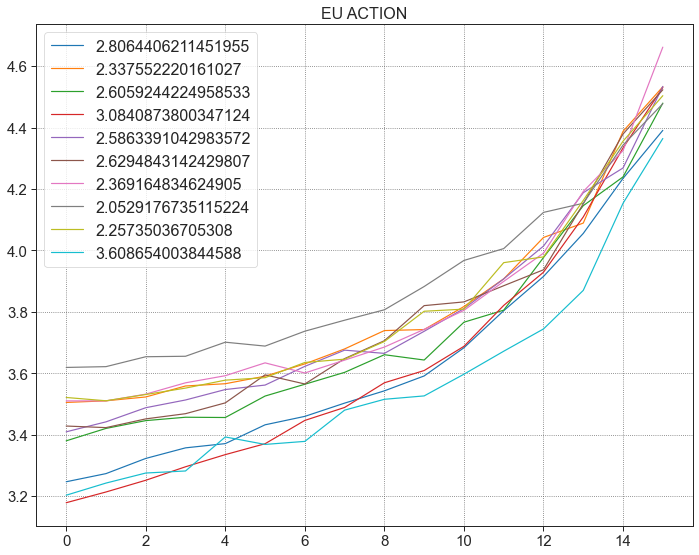

...

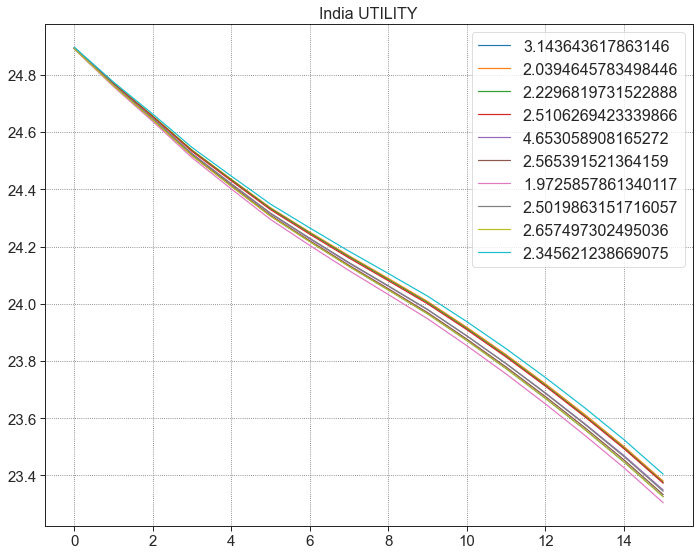

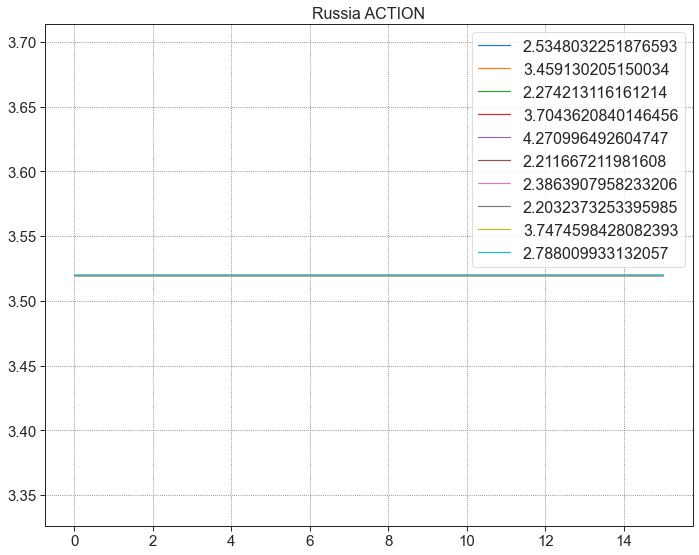

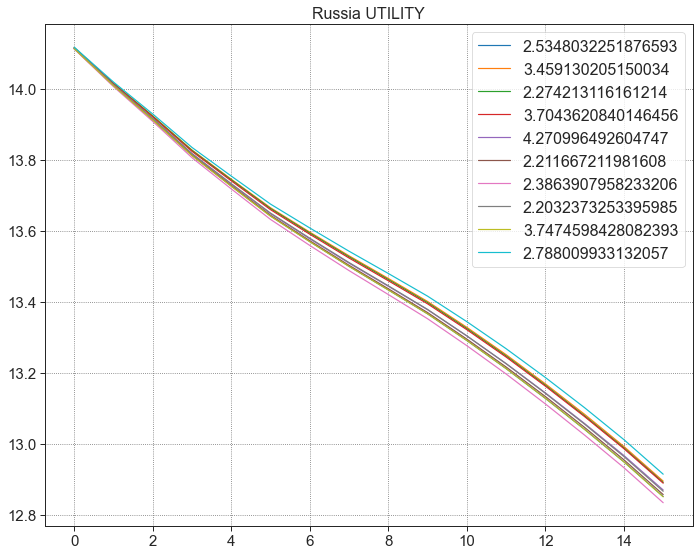

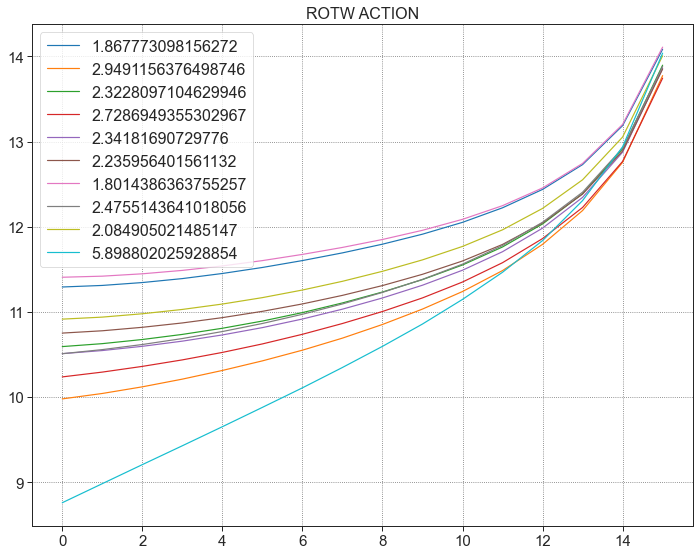

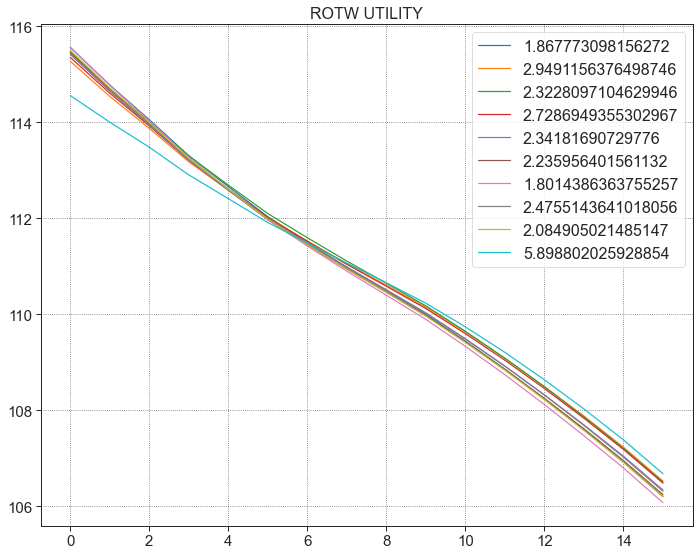

In [31]:
for l in range(N):

    plt.figure(figsize=(10,8))
    for k in range(10):

        plt.title(NAMES[l] + ' ACTION')
        plt.plot(res[0][0][k][l], label=all_temp[0][k][l])
    plt.legend()
    plt.show()

    plt.figure(figsize=(10,8))

    for k in range(10):
        plt.title(NAMES[l] + ' UTILITY')

        plt.plot(res[0][2][k][l], label=all_temp[0][k][l])
    plt.legend()

    plt.show()

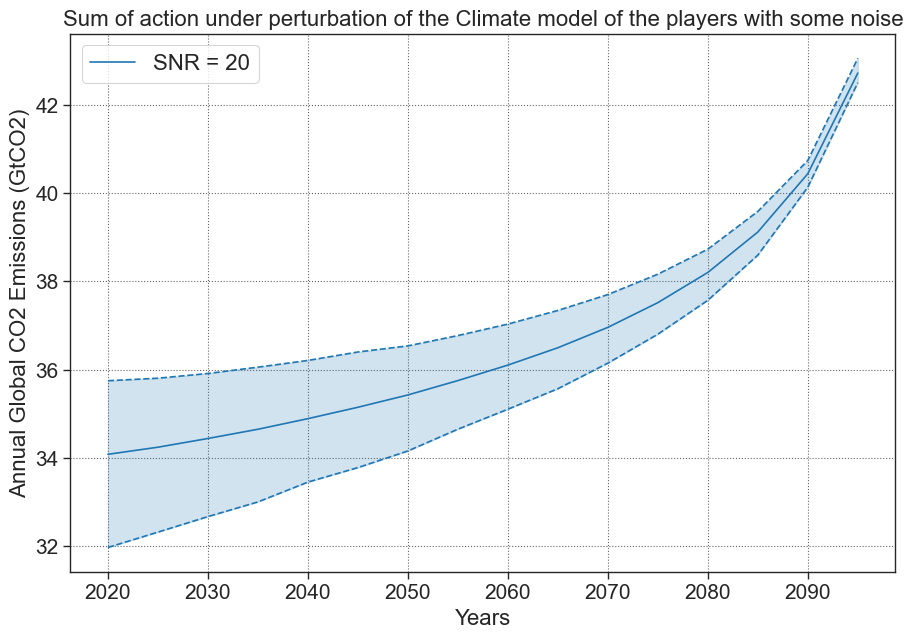

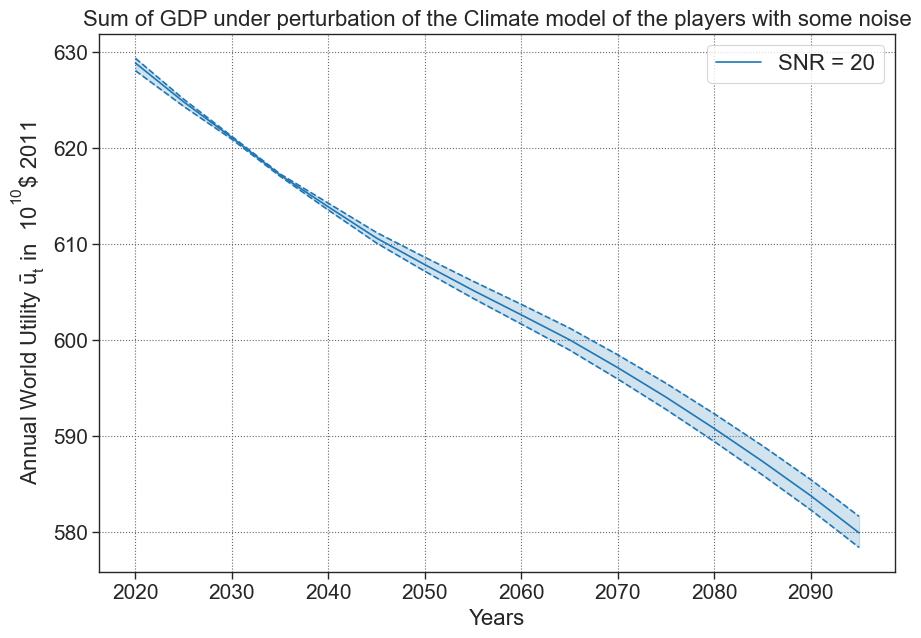

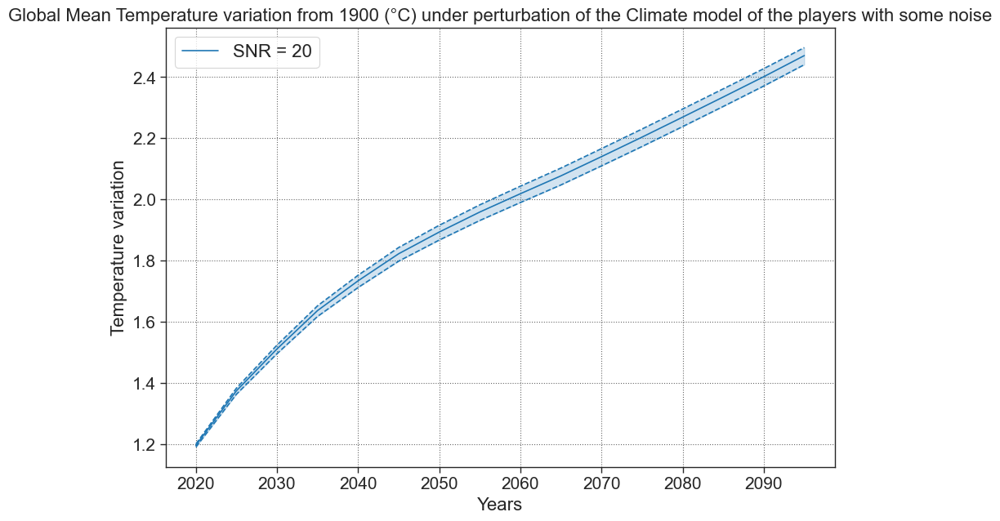

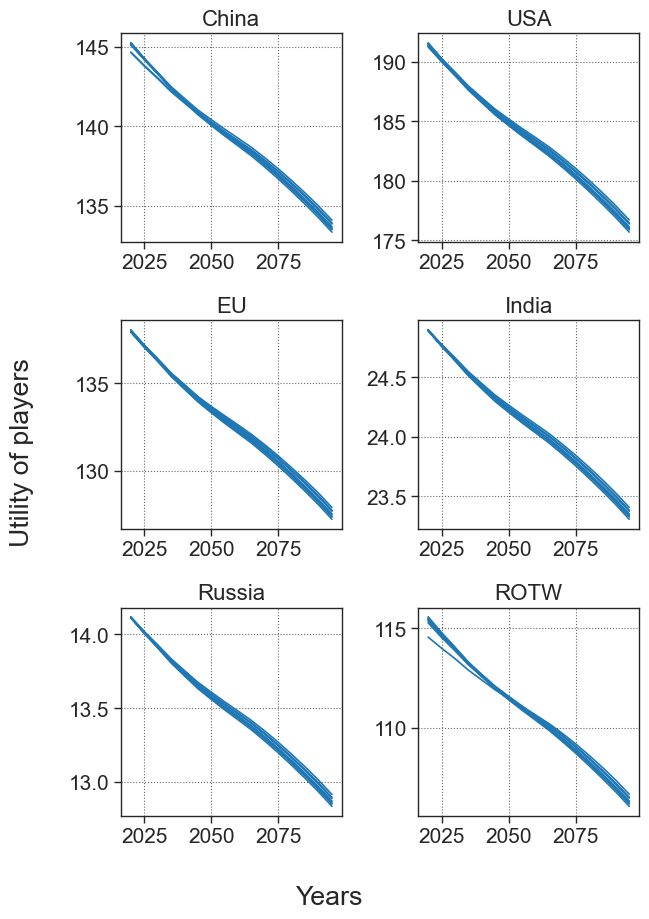

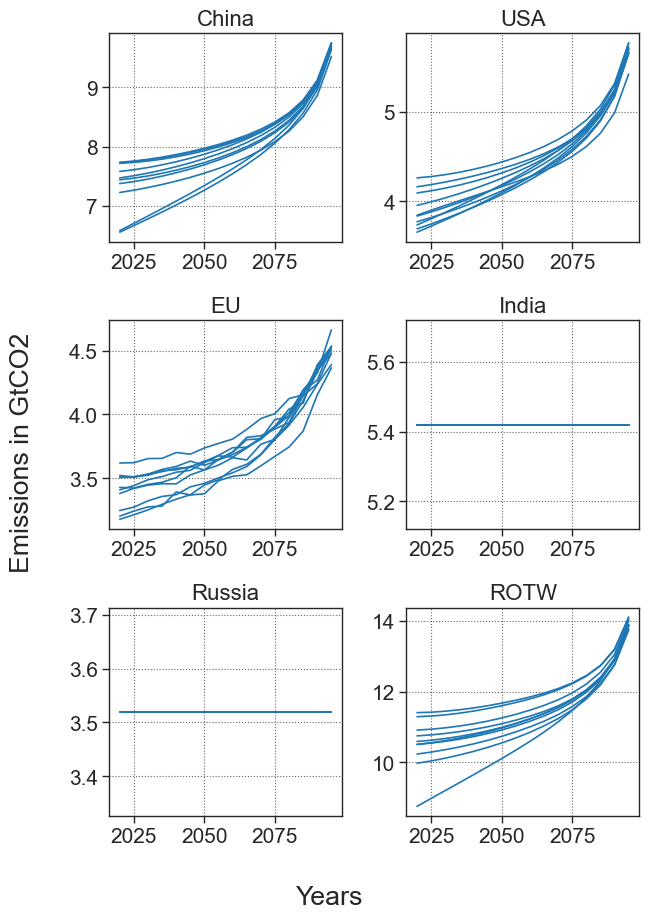

In [32]:
plots_noise(res, NOISE, 'test_plot', list_label=list_label, case = 'classic_sigmoid')

## MULTIPLE noise

In [33]:
NOISE = [5, 10, 20, 40]


In [34]:
res, all_temp = noise_game(list_param, list_label, noise=NOISE, horizon=horizon)

Running f(%s)
coef: 2x^{2}-2x alpha: 1 function: Sigmoid
Noise:  5 dB


Planning BRD, t_piece = 16: 100%|██████████| 1/1 [00:00<00:00,  1.16it/s]


Noise:  10 dB


Planning BRD, t_piece = 16: 100%|██████████| 1/1 [00:01<00:00,  1.90s/it]


Noise:  20 dB


Planning BRD, t_piece = 16: 100%|██████████| 1/1 [00:01<00:00,  1.49s/it]


Noise:  40 dB


Planning BRD, t_piece = 16: 100%|██████████| 1/1 [00:01<00:00,  1.73s/it]

-----------------------------------------------------------


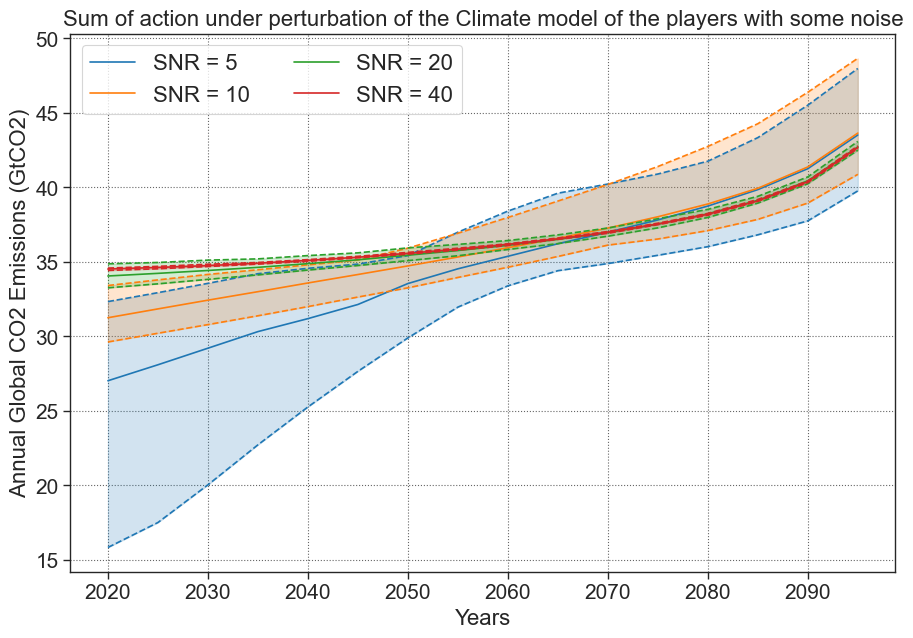

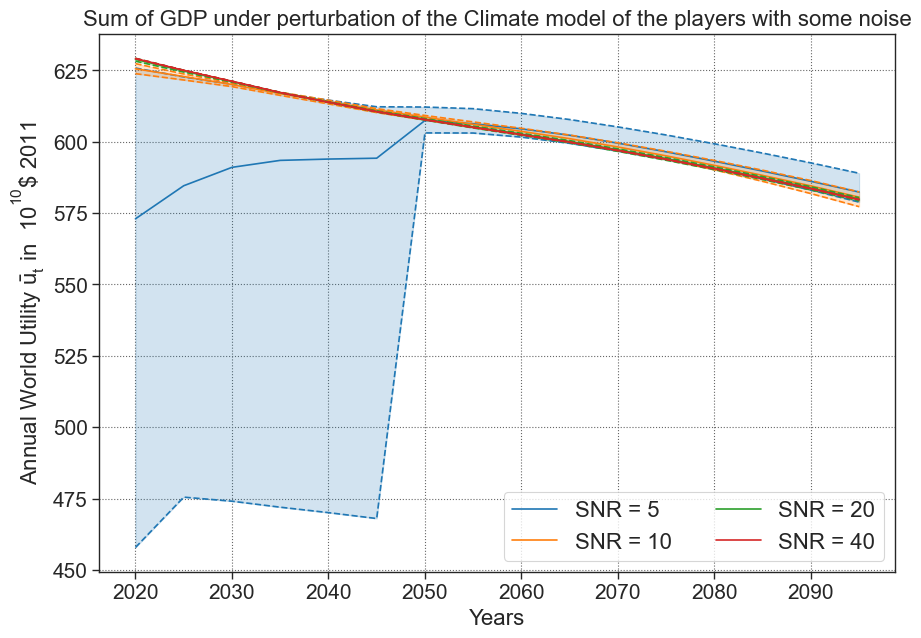

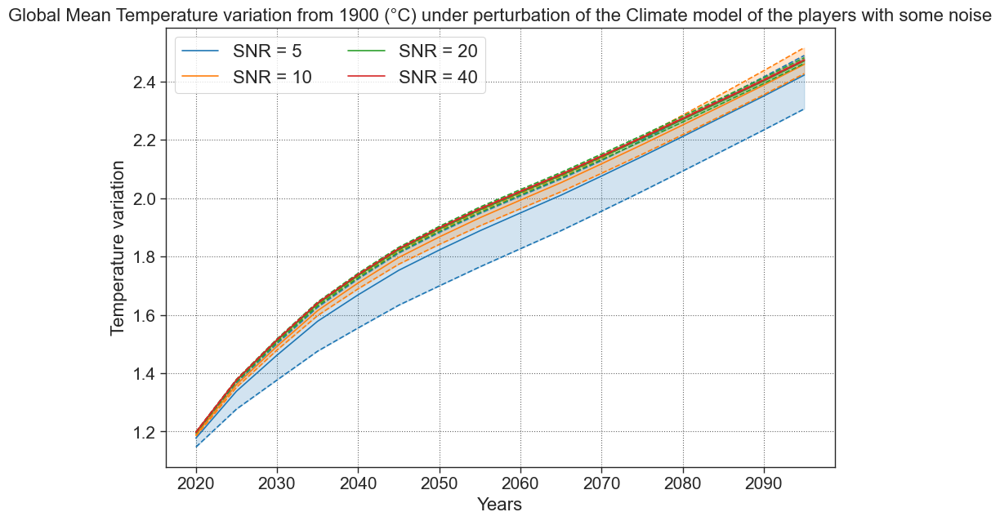

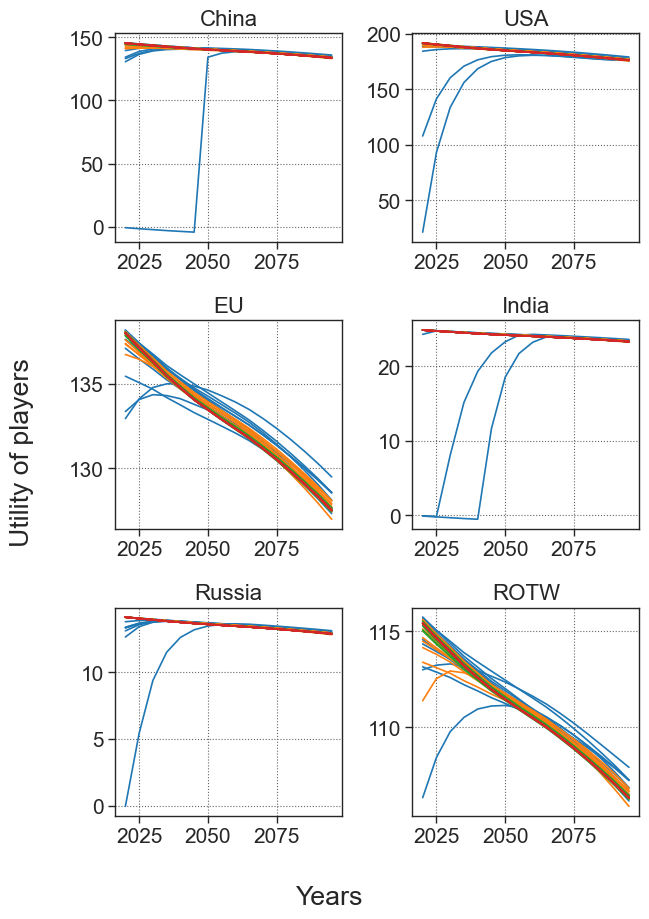

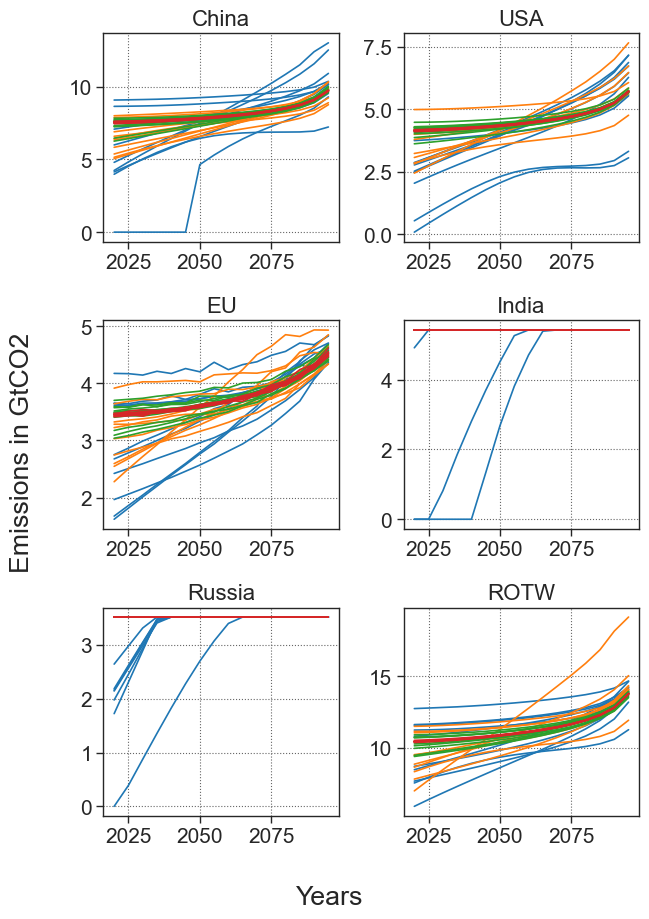

In [35]:
plots_noise(res, NOISE, 'test_plot', list_label=list_label, case = 'classic_sigmoid')

# COMMON NOISE

## NOISE high

In [36]:
NOISE = [5] #, 10]


In [37]:
res, all_temp = noise_game_common(list_param, list_label, noise=NOISE, horizon=horizon)

Running f(%s)
coef: 2x^{2}-2x alpha: 1 function: Sigmoid
Noise:  5 dB


Planning BRD, t_piece = 16: 100%|██████████| 1/1 [00:01<00:00,  1.22s/it]

-----------------------------------------------------------


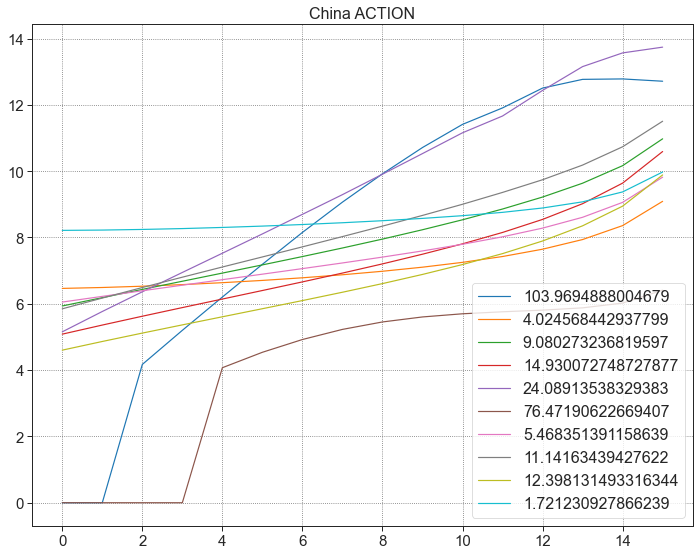

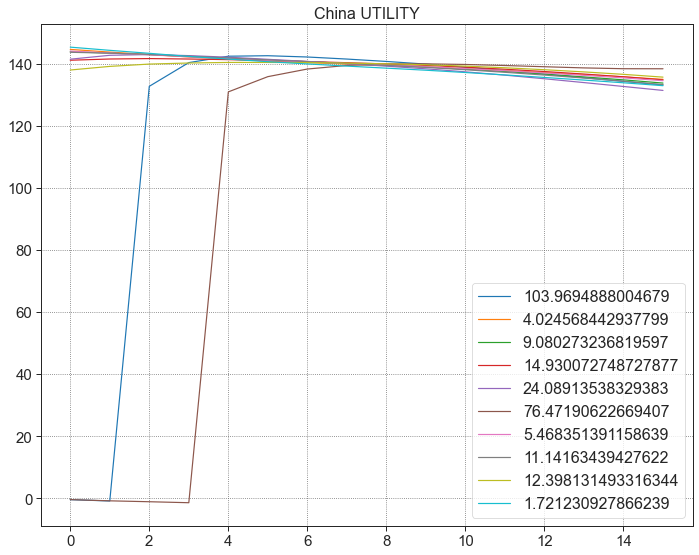

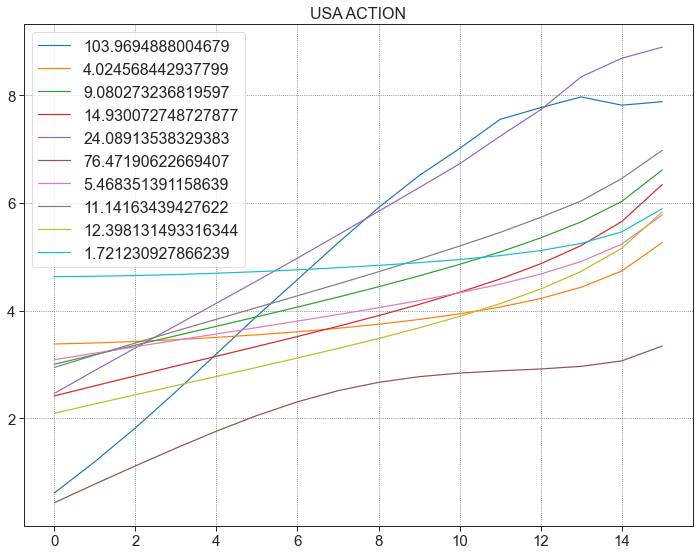

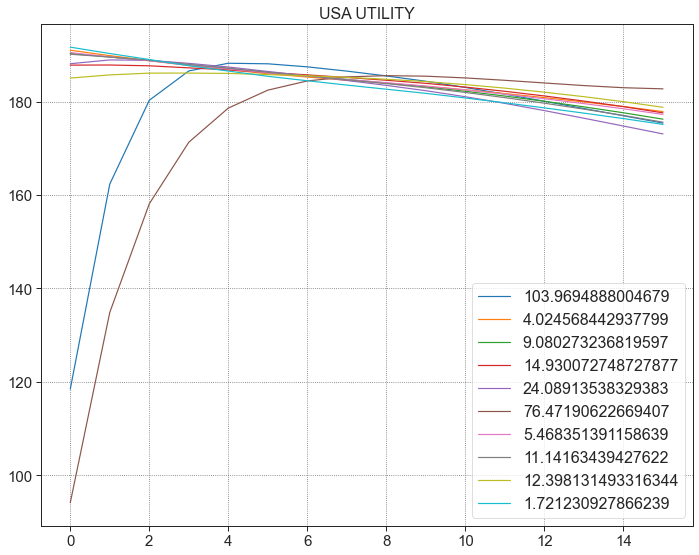

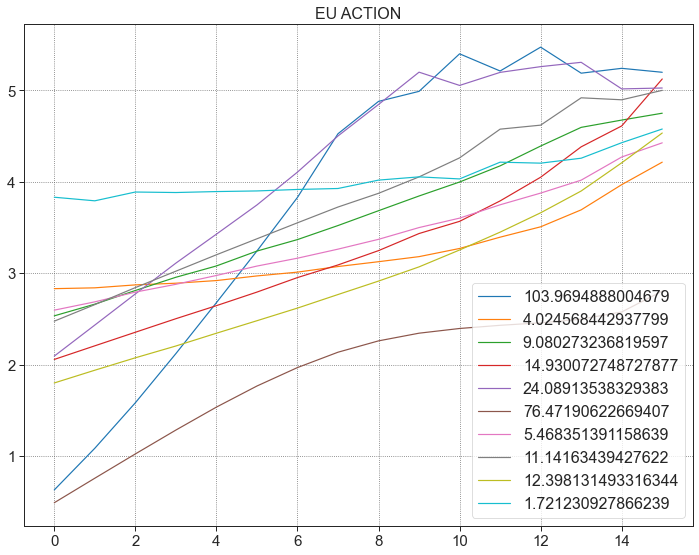

...

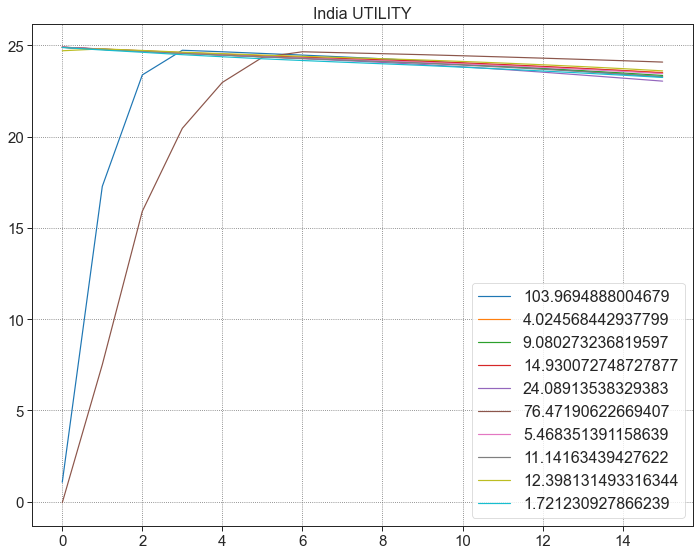

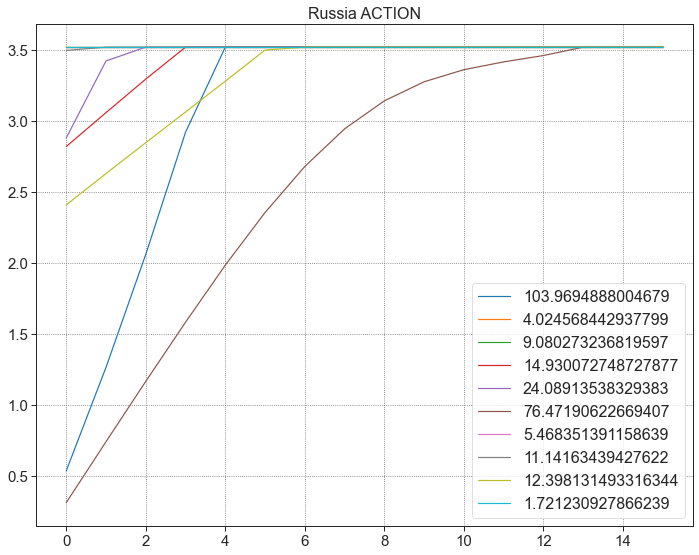

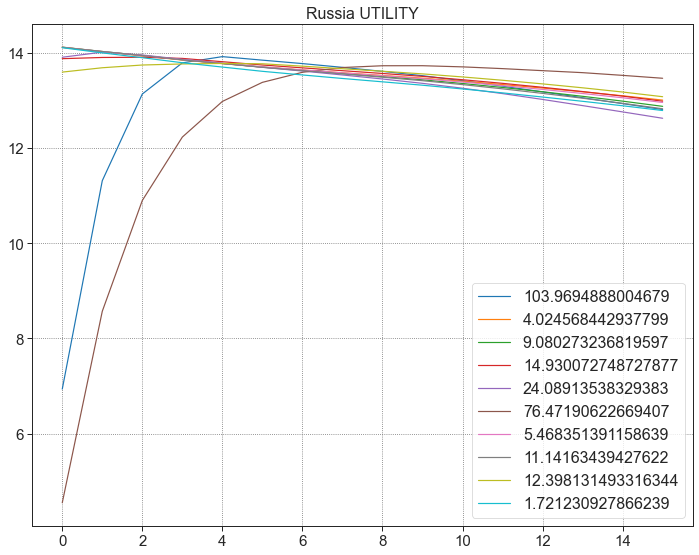

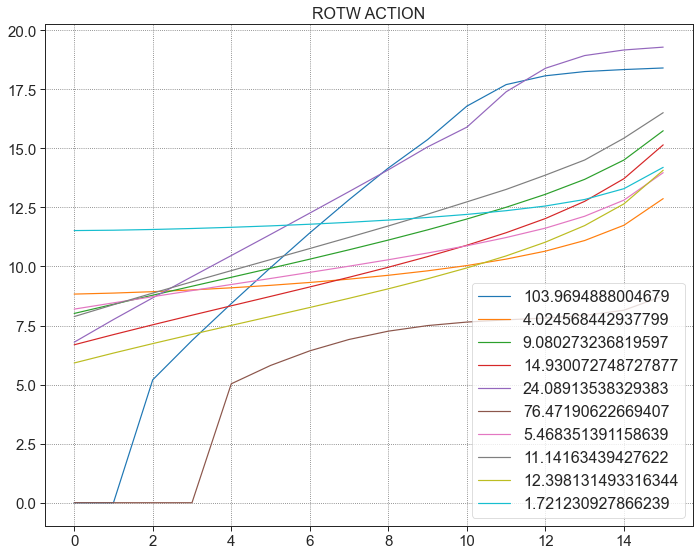

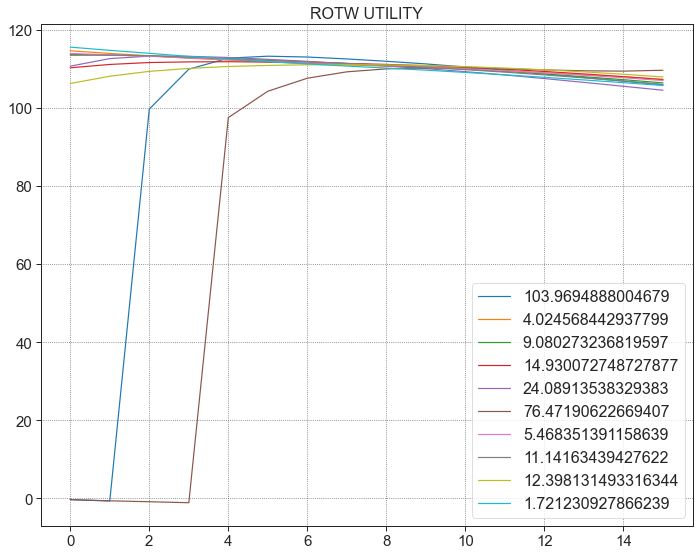

In [38]:
for l in range(N):

    plt.figure(figsize=(10,8))
    for k in range(10):

        plt.title(NAMES[l] + ' ACTION')
        plt.plot(res[0][0][k][l], label=all_temp[0][k][l])
    plt.legend()
    plt.show()

    plt.figure(figsize=(10,8))

    for k in range(10):
        plt.title(NAMES[l] + ' UTILITY')

        plt.plot(res[0][2][k][l], label=all_temp[0][k][l])
    plt.legend()

    plt.show()

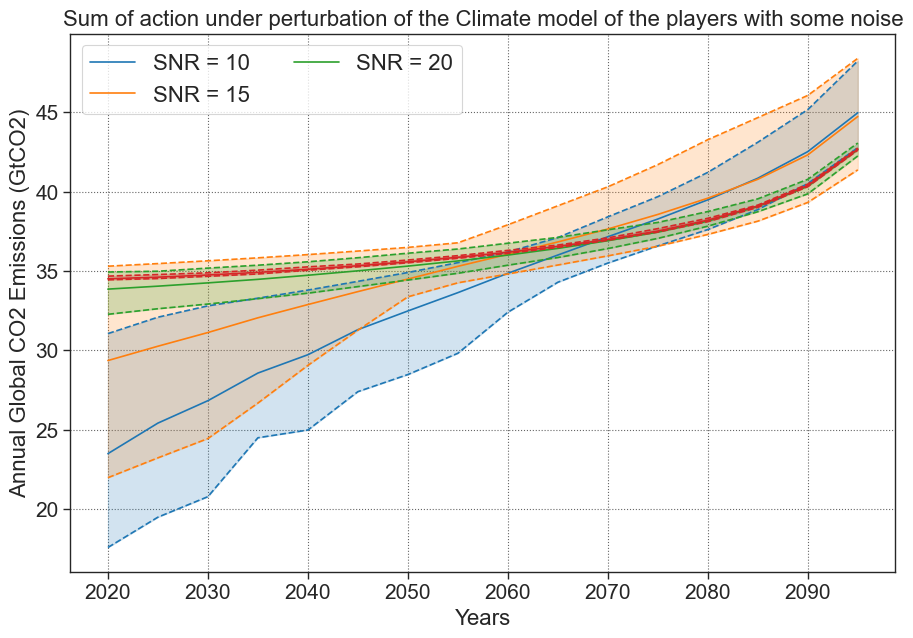

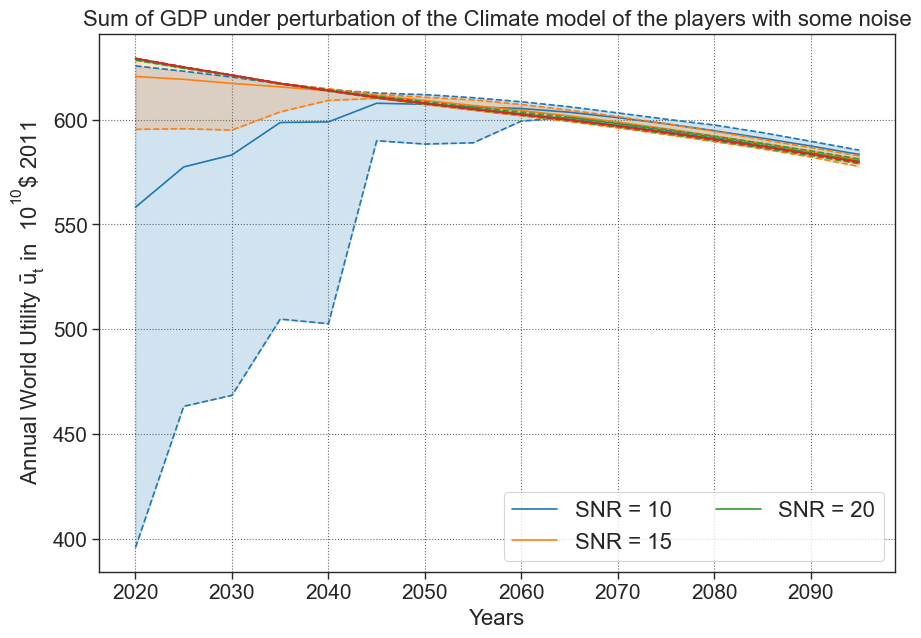

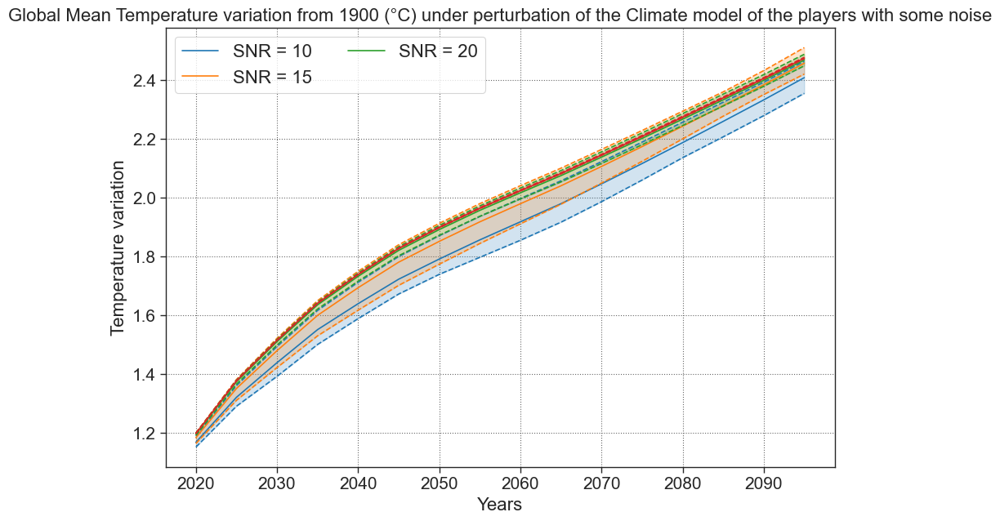

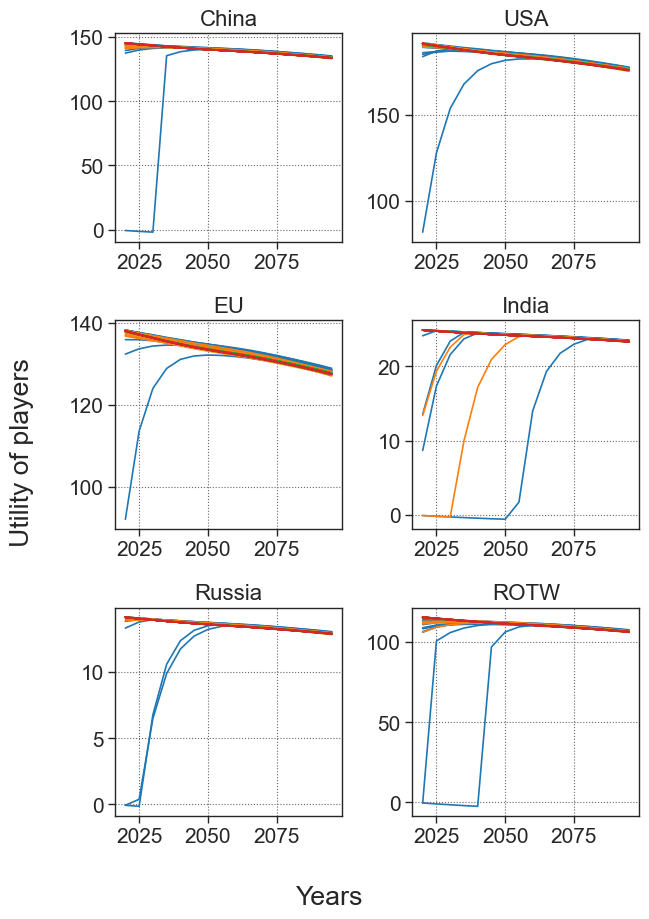

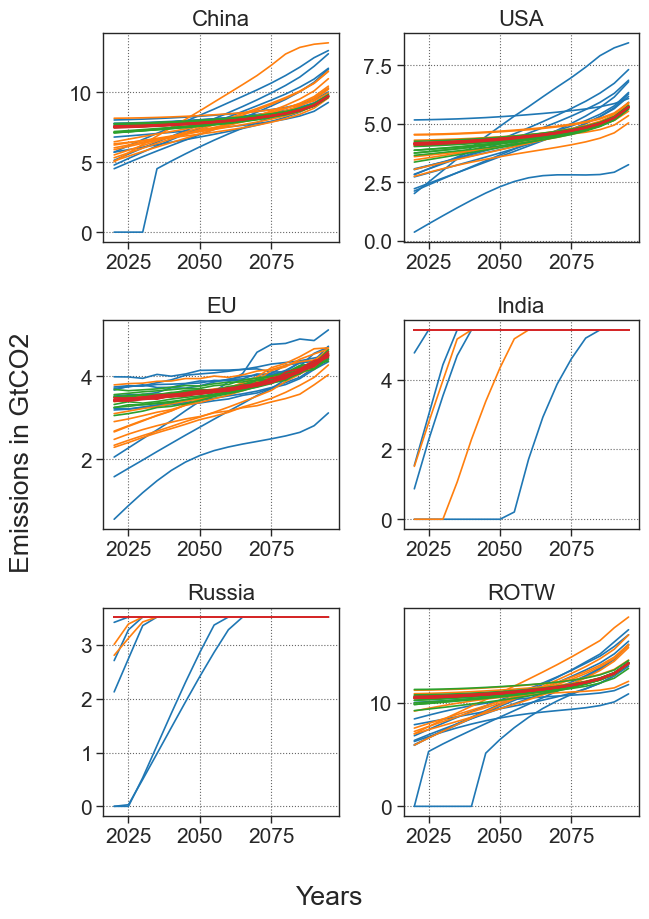

In [ ]:
plots_noise(res, NOISE, 'test_plot', list_label=list_label, case = 'classic_sigmoid')

## NOISE low

In [57]:
NOISE = [20] #, 10]


In [ ]:
res, all_temp = noise_game_common(list_param, list_label, noise=NOISE, horizon=horizon)

Running f(%s)
coef: 2x^{2}-2x alpha: 1 function: Sigmoid
Noise:  20 dB


Planning BRD, t_piece = 16:   0%|          | 0/1 [00:00<?, ?it/s]

Planning BRD, t_piece = 16:   0%|          | 0/1 [00:00<?, ?it/s]

Planning BRD, t_piece = 16:   0%|          | 0/1 [00:00<?, ?it/s]

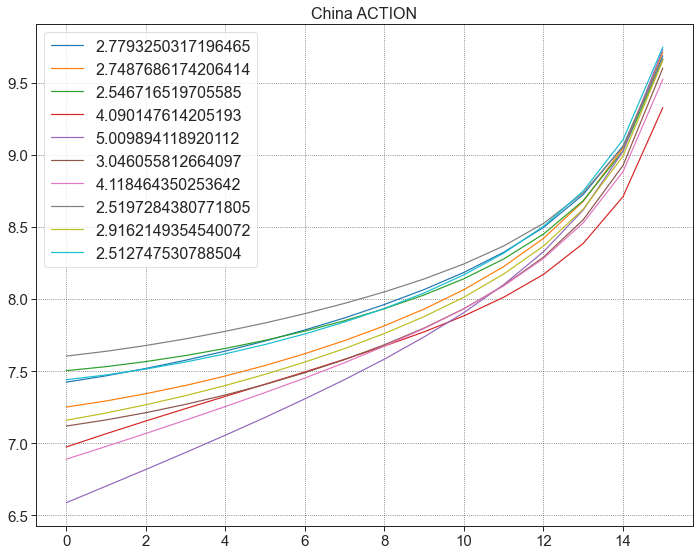

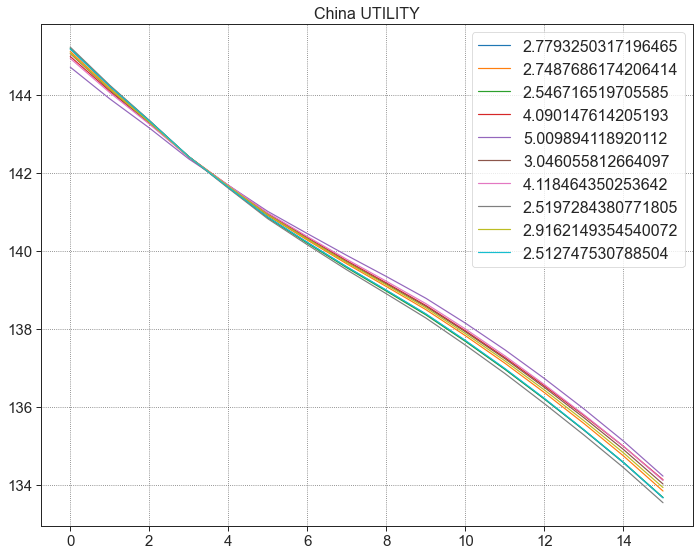

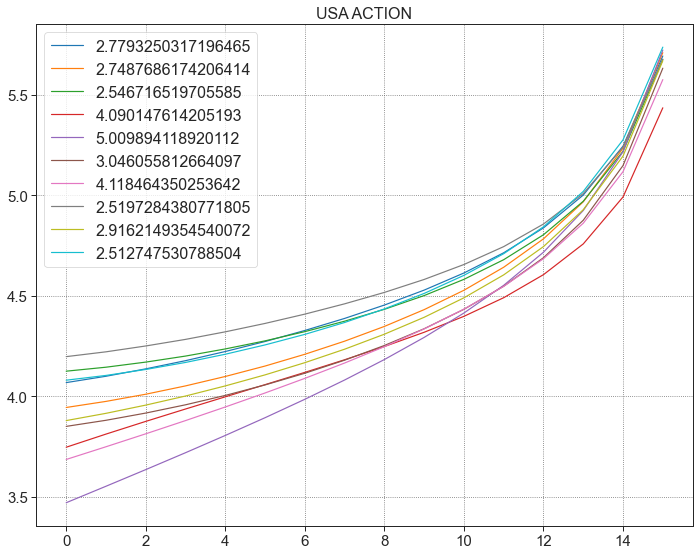

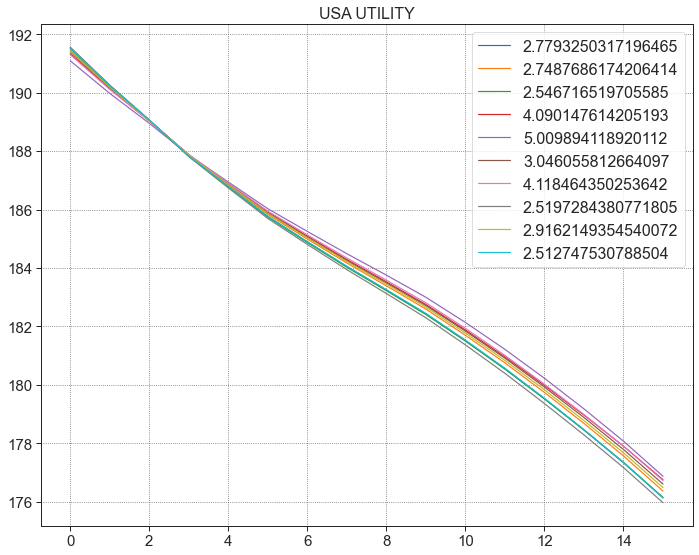

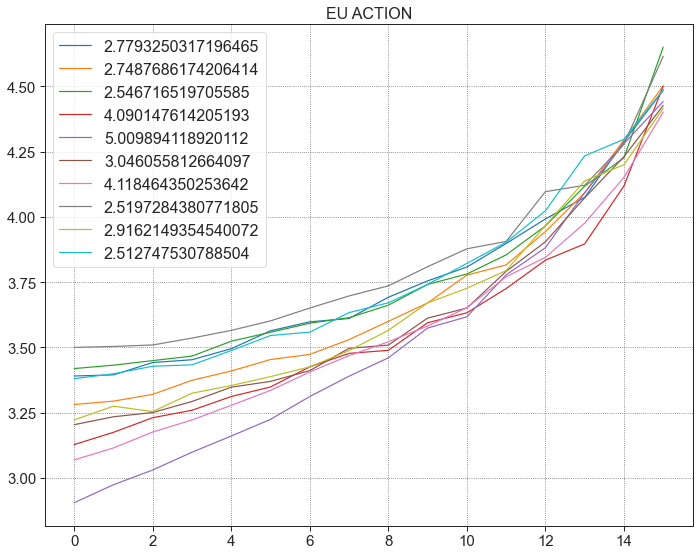

...

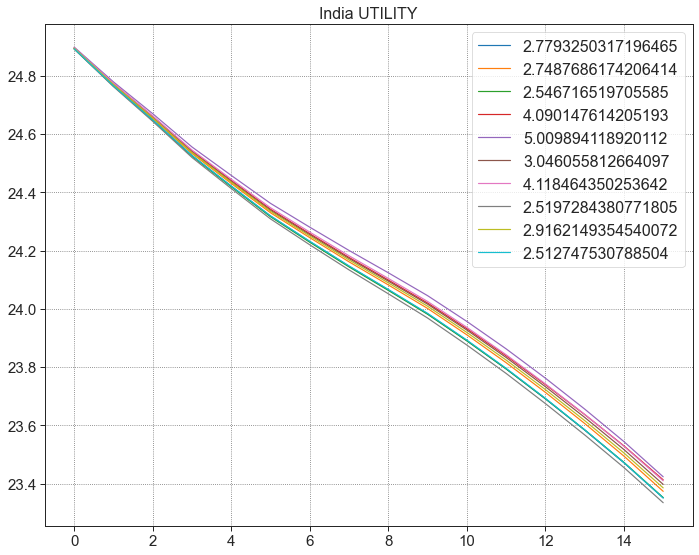

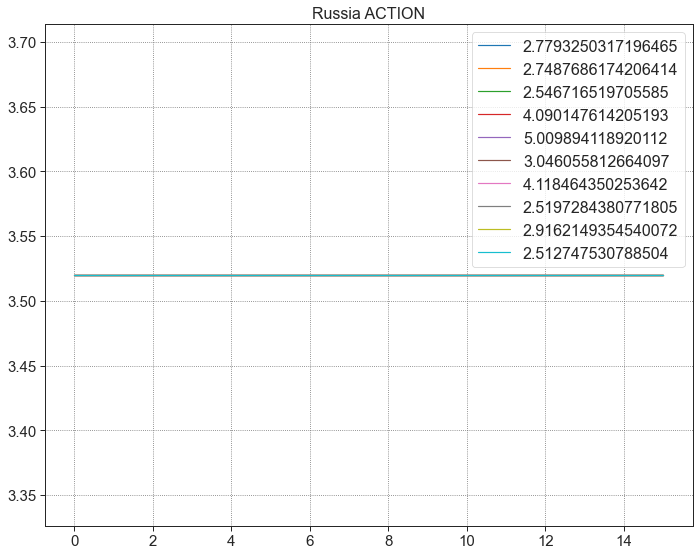

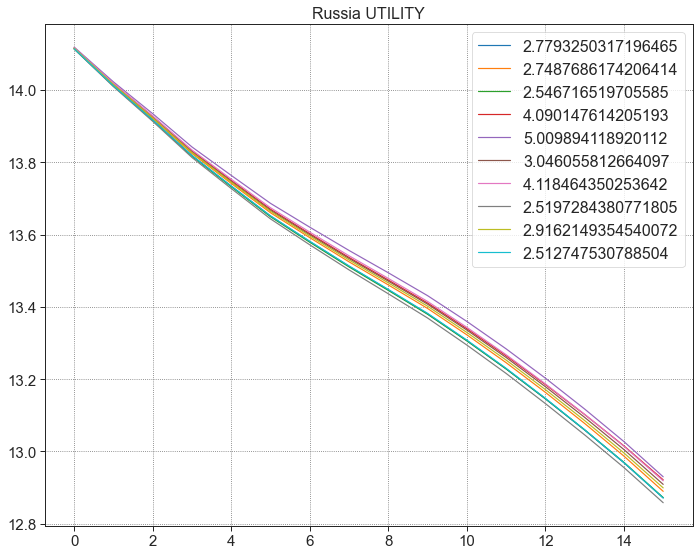

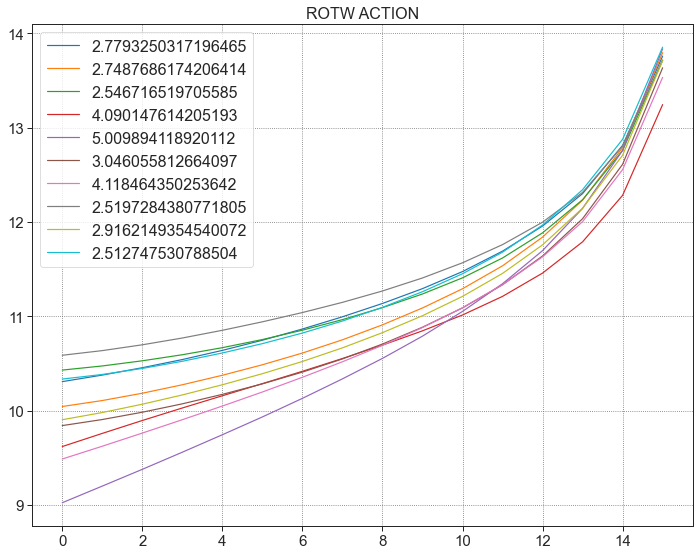

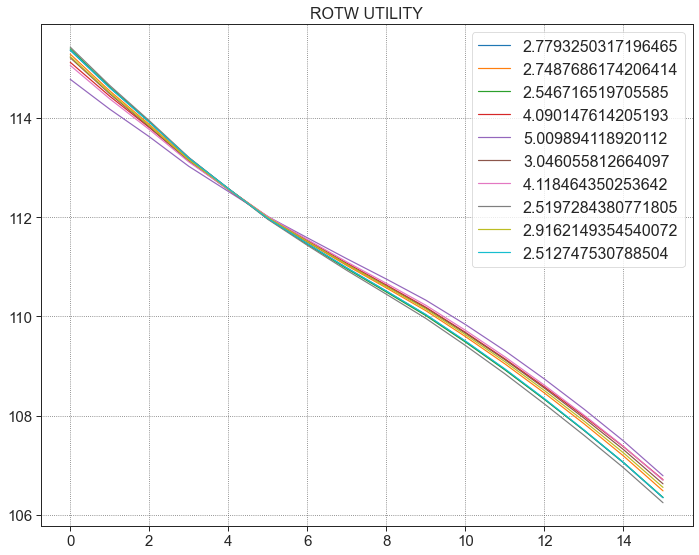

In [ ]:
for l in range(N):

    plt.figure(figsize=(10,8))
    for k in range(10):

        plt.title(NAMES[l] + ' ACTION')
        plt.plot(res[0][0][k][l], label=all_temp[0][k][l])
    plt.legend()
    plt.show()

    plt.figure(figsize=(10,8))

    for k in range(10):
        plt.title(NAMES[l] + ' UTILITY')

        plt.plot(res[0][2][k][l], label=all_temp[0][k][l])
    plt.legend()

    plt.show()

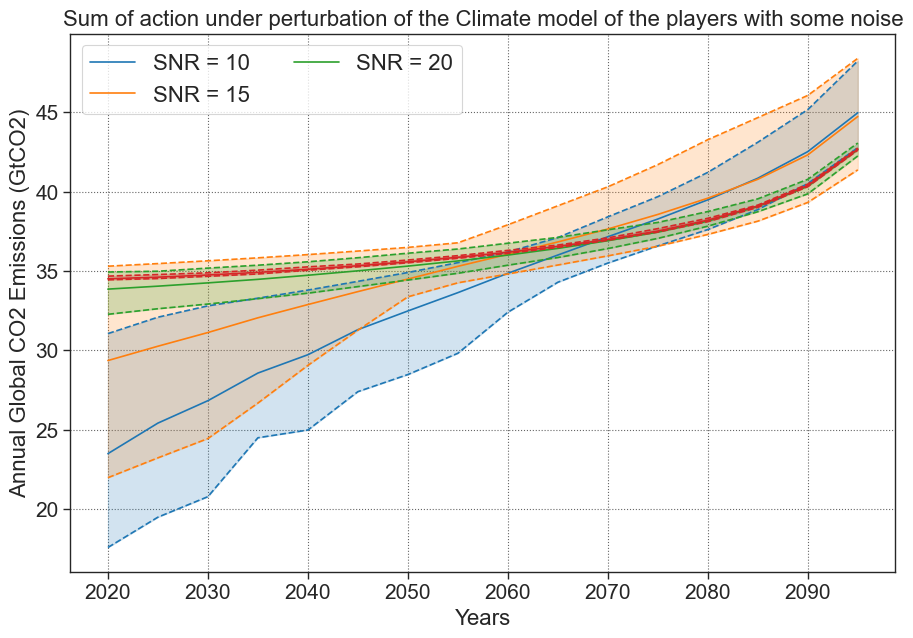

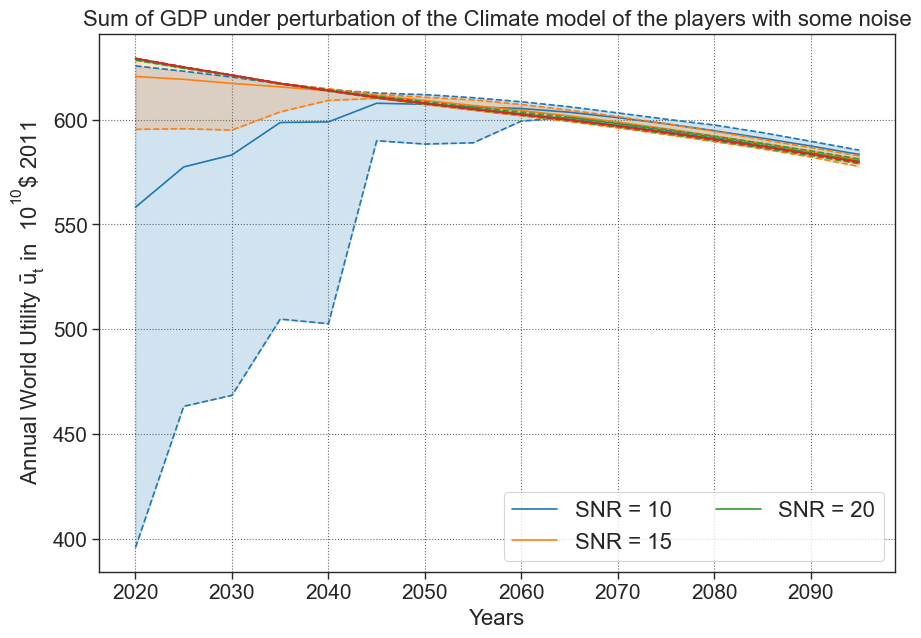

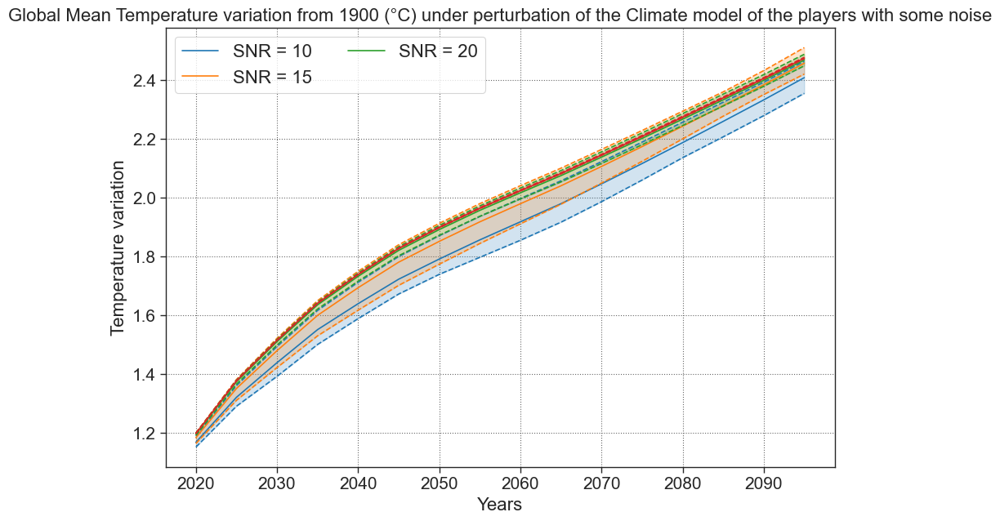

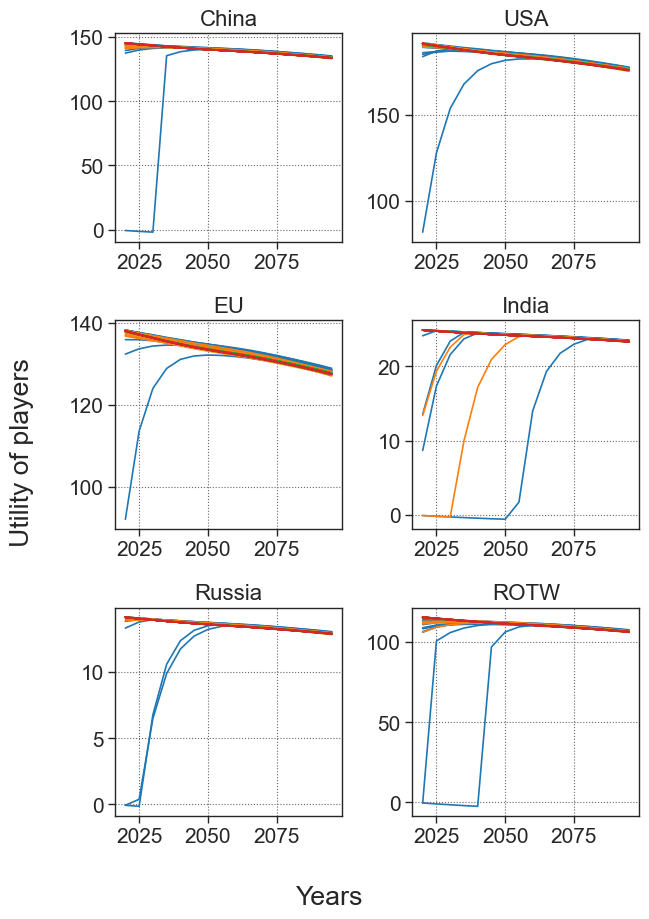

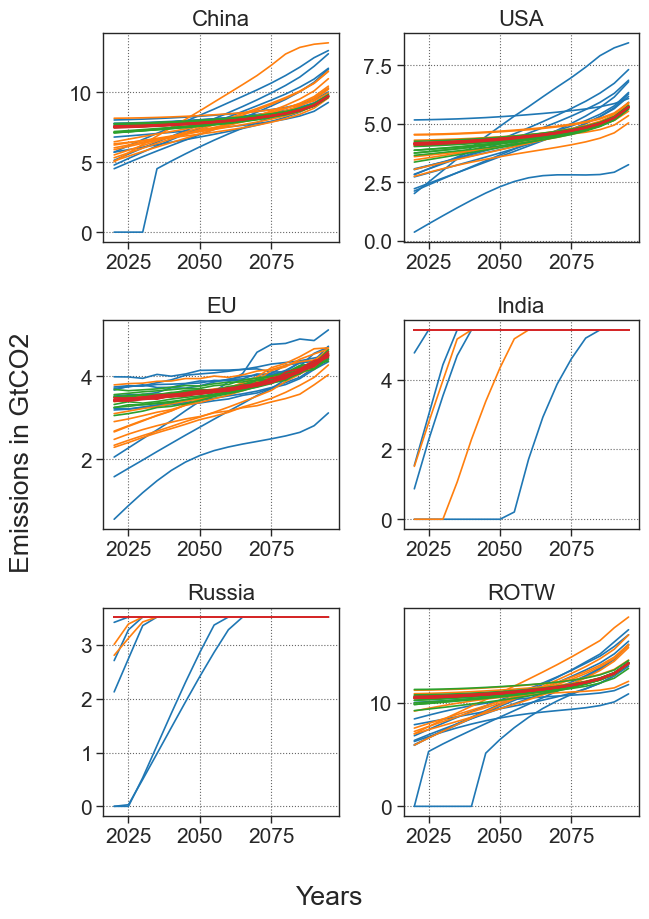

In [ ]:
plots_noise(res, NOISE, 'test_plot', list_label=list_label, case = 'classic_sigmoid')

## MULTIPLE noise

In [ ]:
NOISE = [5, 10, 20, 40]


In [ ]:
res, all_temp = noise_game_common(list_param, list_label, noise=NOISE, horizon=horizon)

Running f(%s)
coef: 2x^{2}-2x alpha: 1 function: Sigmoid
Noise:  20 dB


Planning BRD, t_piece = 16: 100%|██████████| 1/1 [00:01<00:00,  1.78s/it]

-----------------------------------------------------------


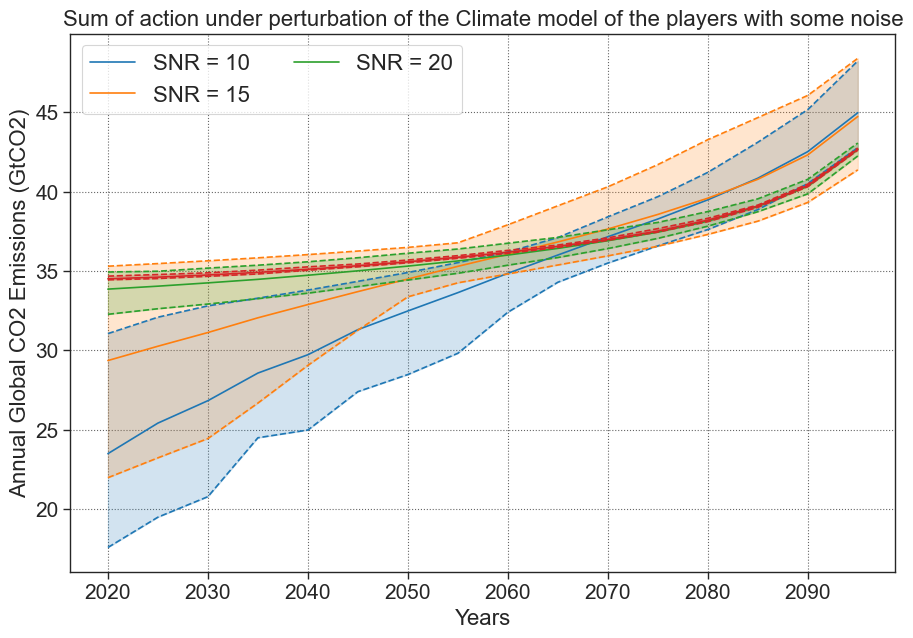

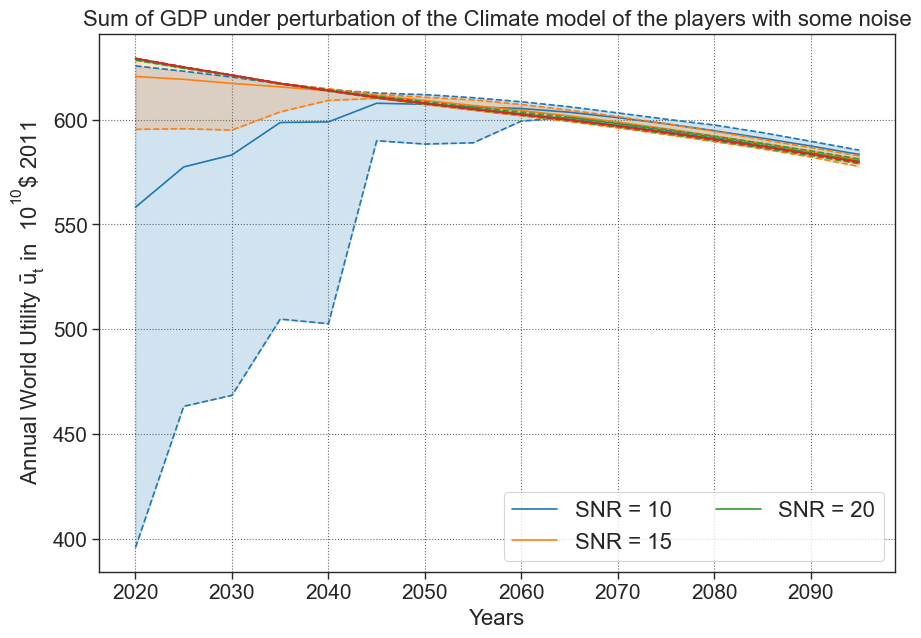

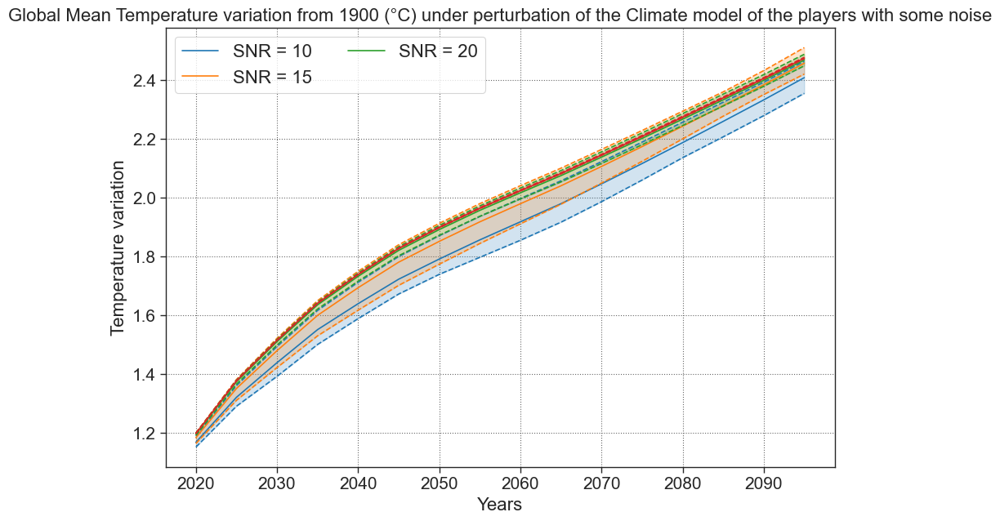

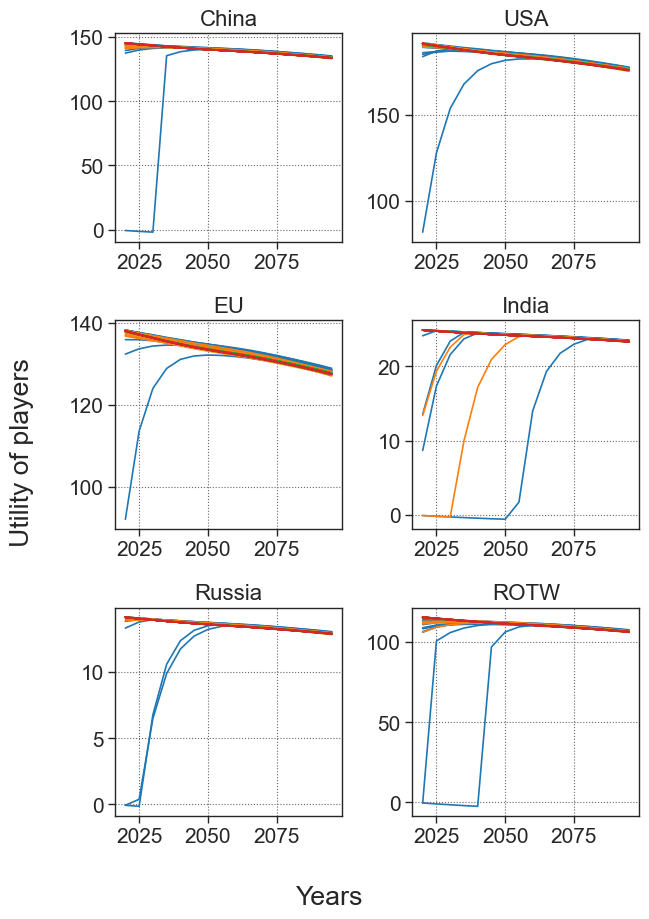

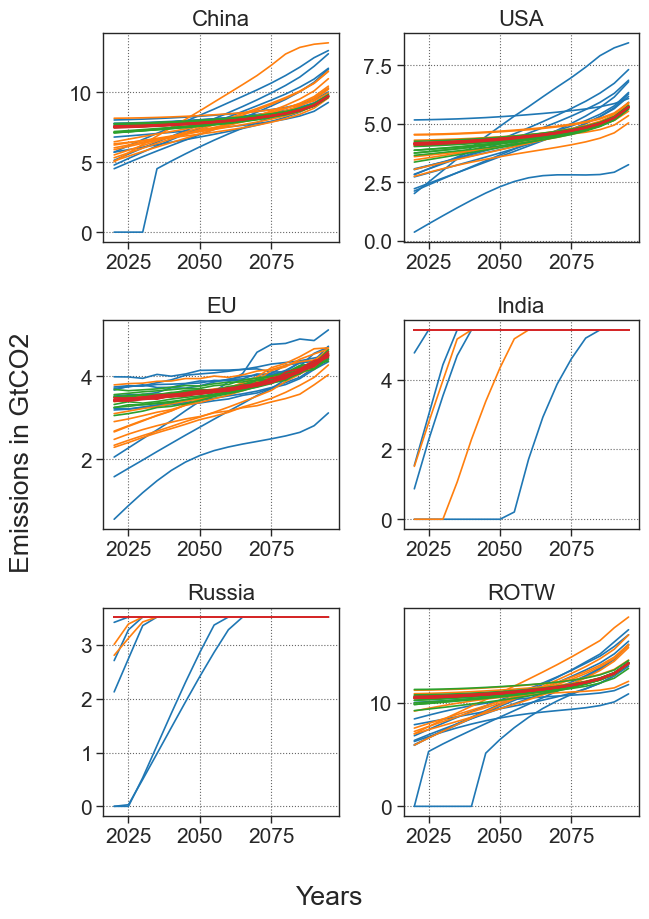

In [ ]:
plots_noise(res, NOISE, 'test_plot', list_label=list_label, case = 'classic_sigmoid')

# Lower damages


In [39]:
from utility.array_to_latex import array_to_latex

X = 2020 + np.arange((horizon-2020)//5 )*5

list_t_piece = np.arange(1,T,2)


list_damage_coef = [np.array([0,0,1.1450])] #, np.array([0,0,2]) ] #np.array([0,-2,2]),  np.array([0,-0.5,1.1])] #, , np.array([0,0,0,0,1])]
list_alpha = [1] #[1,1.5,2]
list_list_benefit_functions = [
                                [partial(benefit_sigm, e=e[i], r = r[i]) for i in range(N)],
                                # BENEFITS_CONCAVE,
                                ]
 #[partial(benefit_sigm, e=e[i], r = r[i]) for i in range(N)], BENEFITS_LOG]
list_label_benefit_function = [
                                ('Sigmoid', '-'),
                                # ('Concave', '--'),
                                ]
#, #, ('Logaritmic', 'dotted')]
# list_damage_label = [array_to_latex(coef) for coef in list_damage_coef]


list_damage_label = [array_to_latex(coef) for coef in list_damage_coef]

case = 'sigmoid'
list_param = list(product(list_damage_coef, list_alpha, list_list_benefit_functions))
list_label = list(product(list_damage_label, list_alpha, list_label_benefit_function))

In [40]:
alpha = list_alpha[-1]
benef = list_list_benefit_functions[0]
coef = list_damage_coef[-1]

In [41]:
list_players = create_players(alpha=alpha, list_action_sets=ACTION_SETS, list_of_names=NAMES, list_benefit_functions=benef, damage_function=damage_polynome(coef), discount=1)

game = Game(list_players, horizon=horizon)

# INDIVIDUAL NOISE

## NOISE high

In [42]:
NOISE = [5] #, 10]


In [43]:
res, all_temp = noise_game(list_param, list_label, noise=NOISE, horizon=horizon)

Running f(%s)
coef: 1.145x^{2} alpha: 1 function: Sigmoid
Noise:  5 dB


Planning BRD, t_piece = 16:   0%|          | 0/1 [00:00<?, ?it/s]c:\ProgramData\Anaconda3\envs\CO2\lib\site-packages\scipy\optimize\optimize.py:282: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
Planning BRD, t_piece = 16: 100%|██████████| 1/1 [00:02<00:00,  2.34s/it]

-----------------------------------------------------------


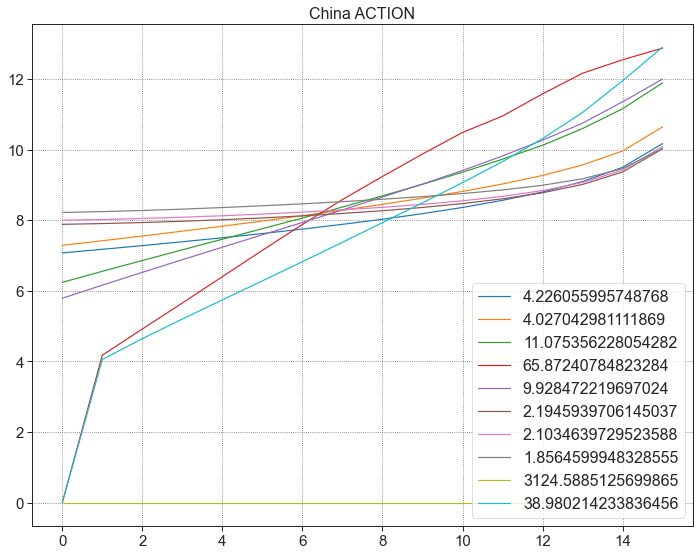

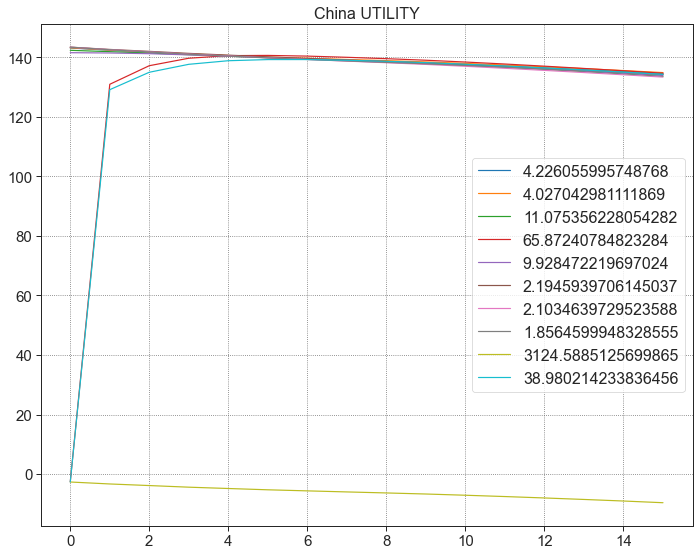

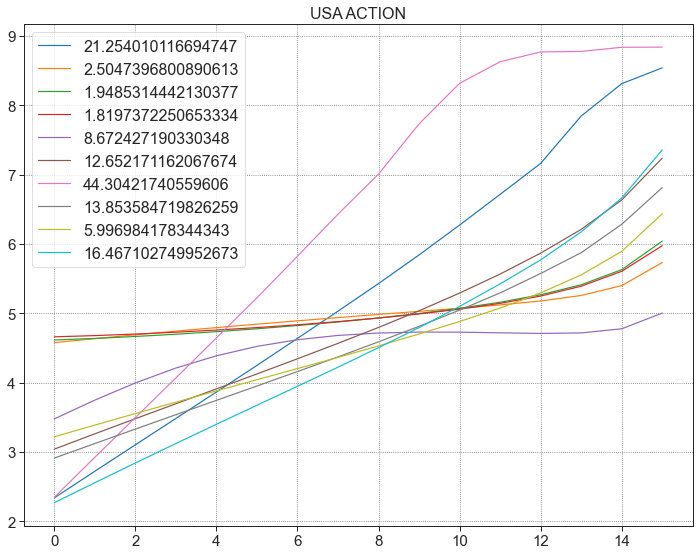

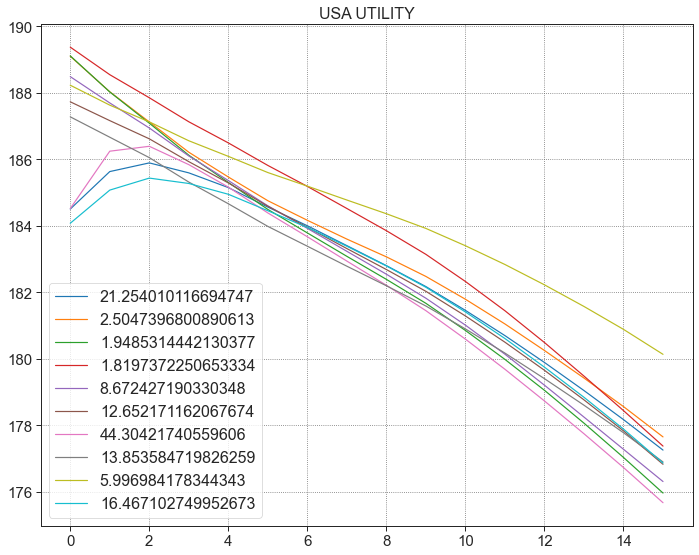

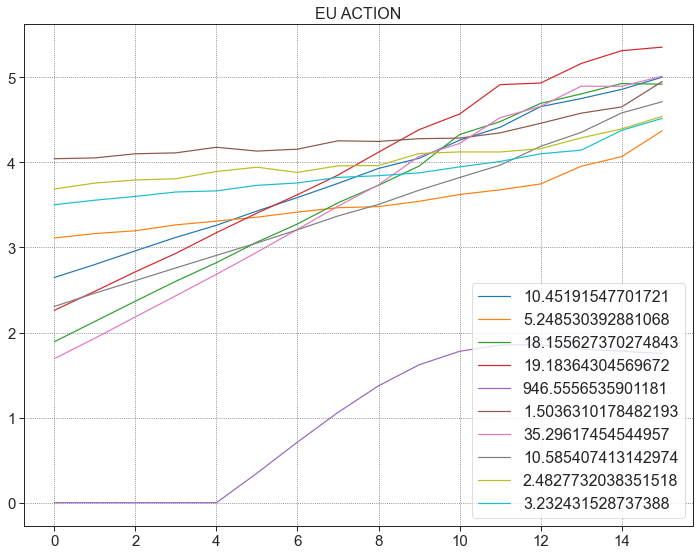

...

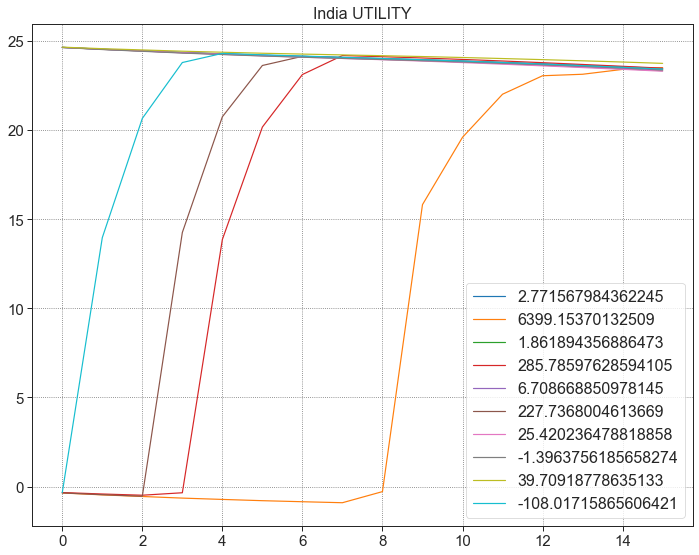

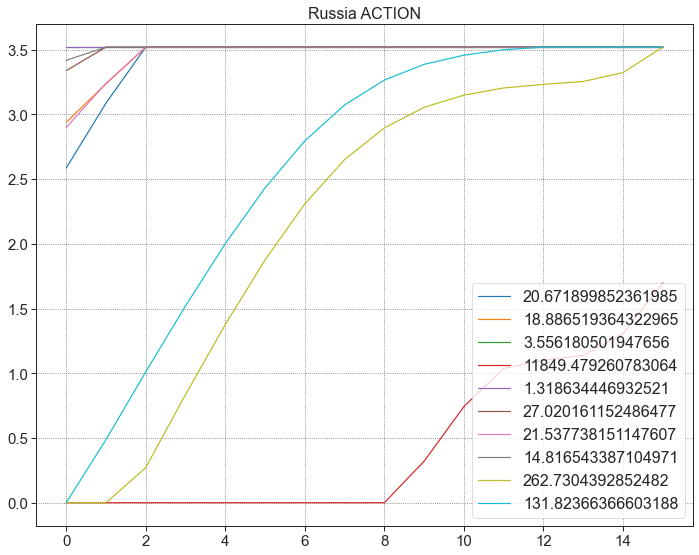

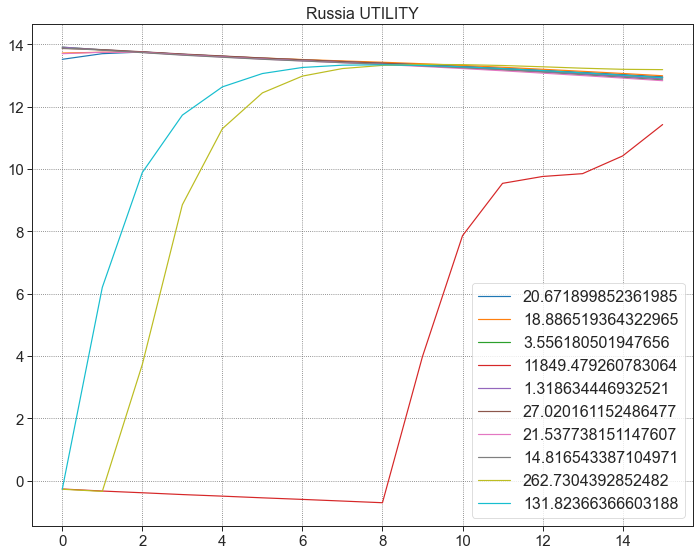

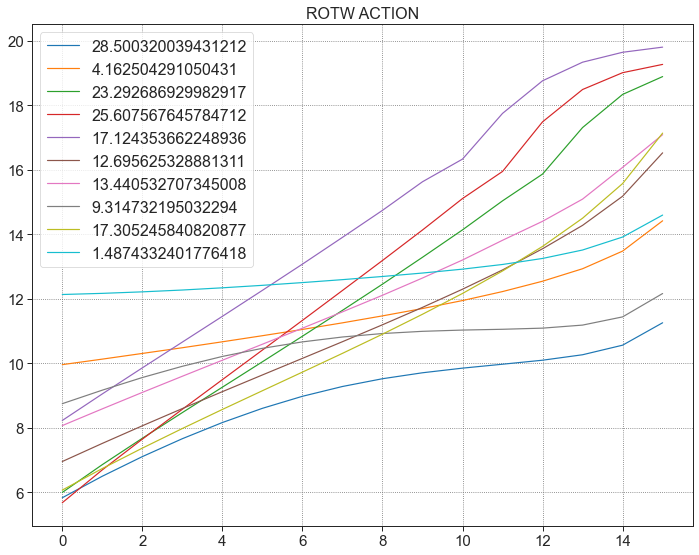

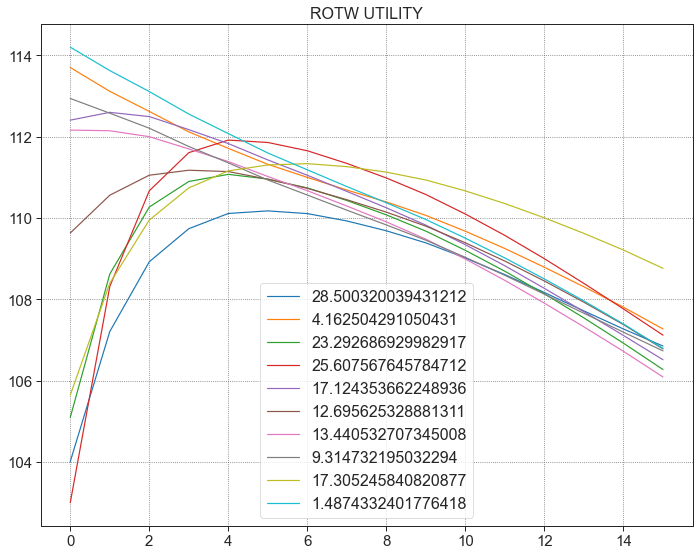

In [44]:
for l in range(N):

    plt.figure(figsize=(10,8))
    for k in range(10):

        plt.title(NAMES[l] + ' ACTION')
        plt.plot(res[0][0][k][l], label=all_temp[0][k][l])
    plt.legend()
    plt.show()

    plt.figure(figsize=(10,8))

    for k in range(10):
        plt.title(NAMES[l] + ' UTILITY')

        plt.plot(res[0][2][k][l], label=all_temp[0][k][l])
    plt.legend()

    plt.show()

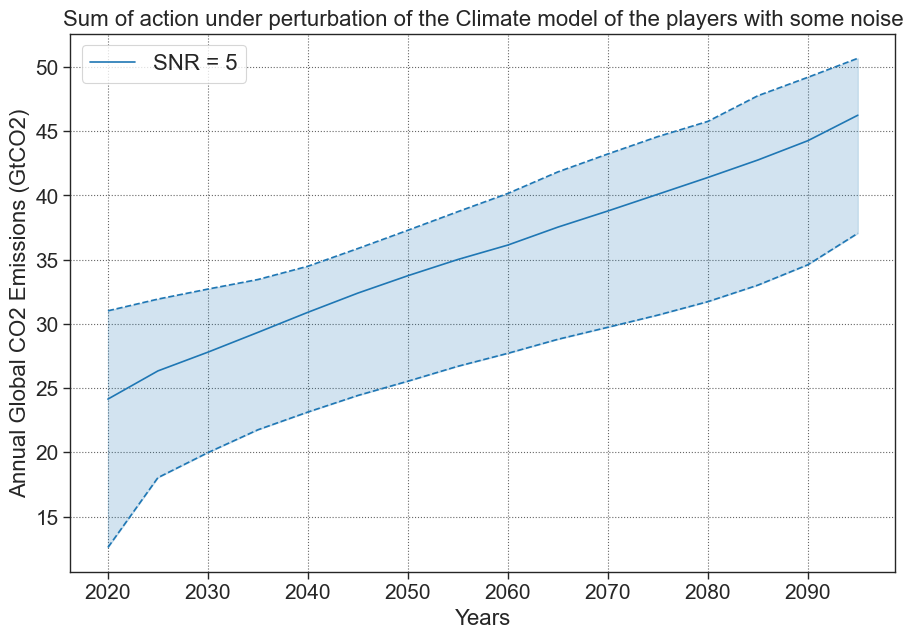

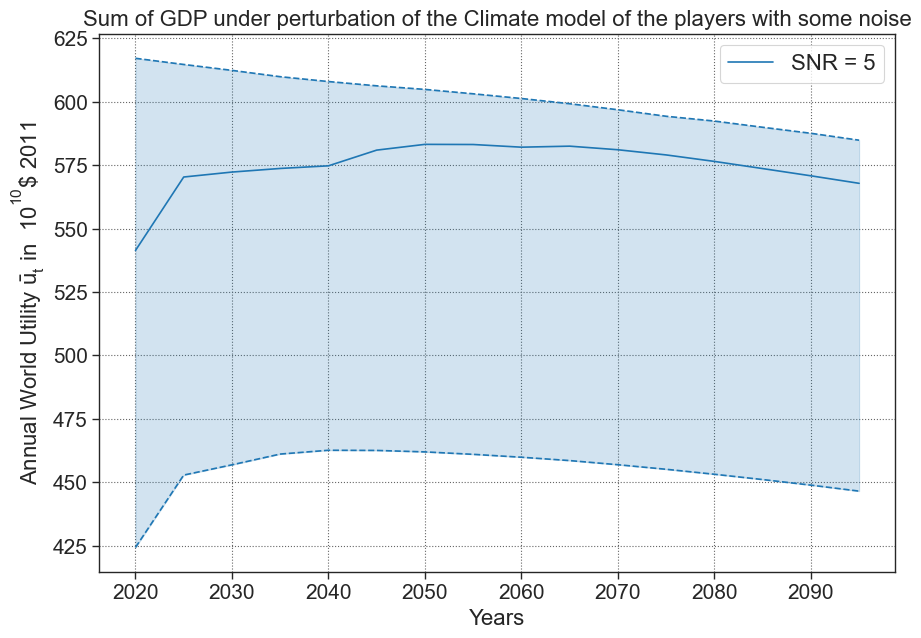

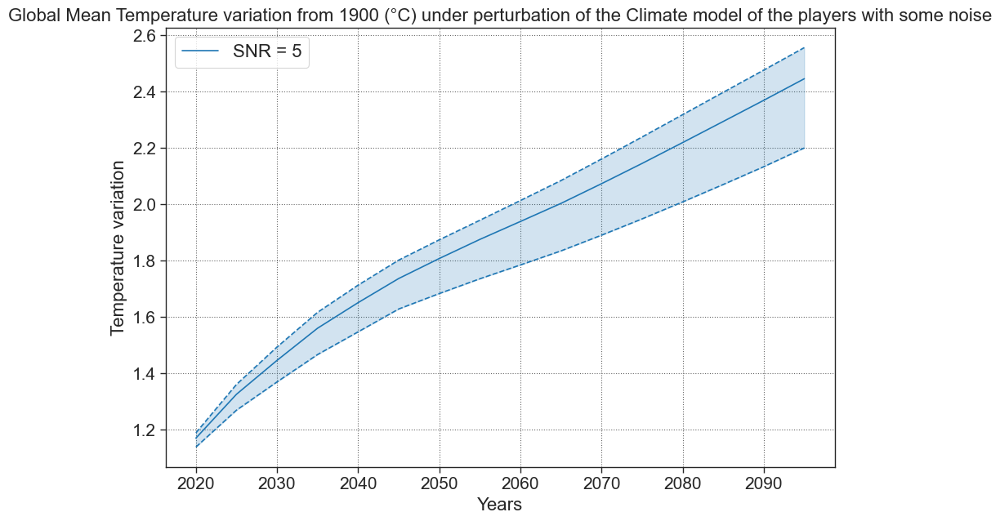

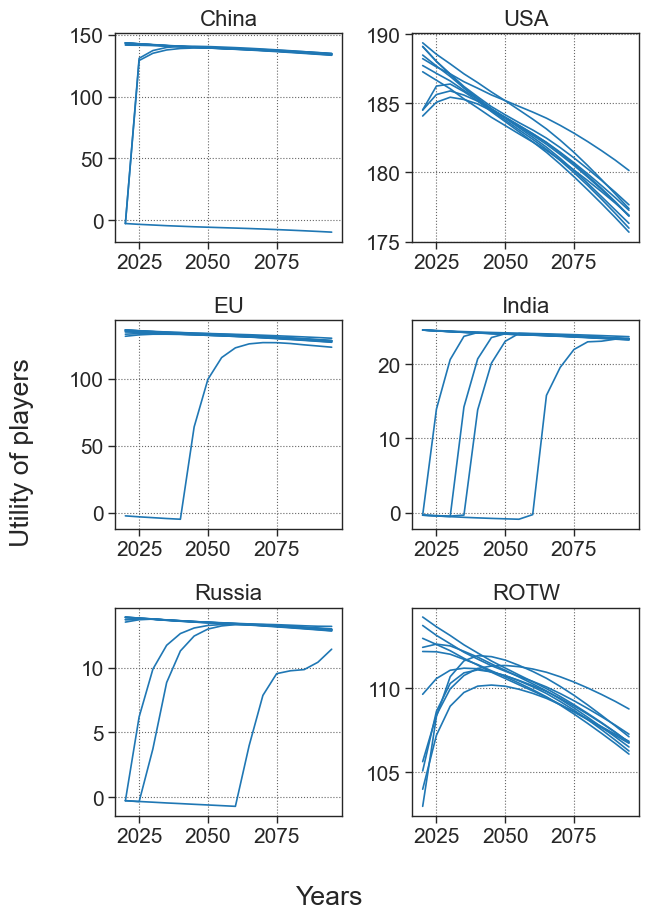

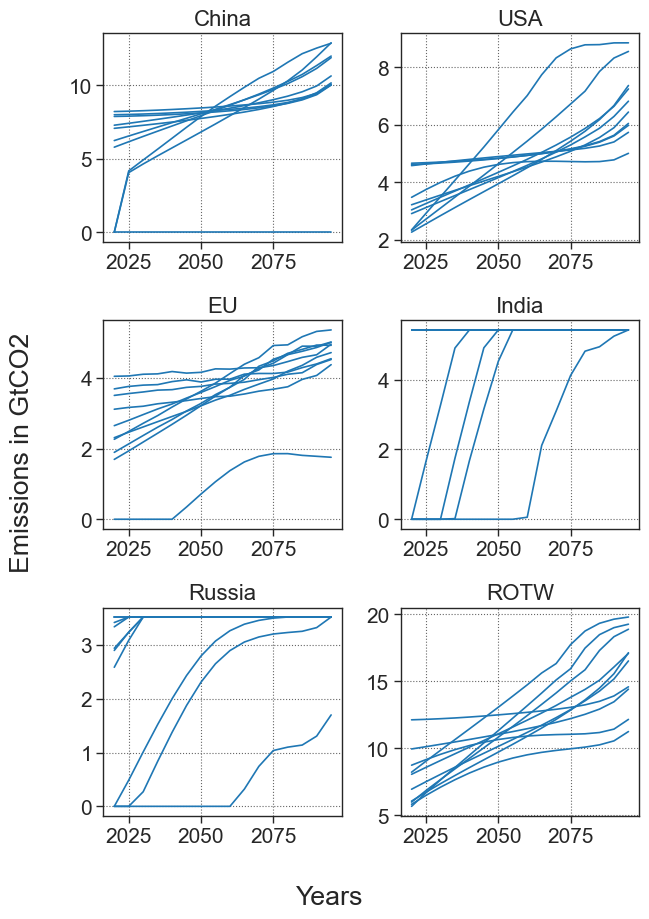

In [45]:
plots_noise(res, NOISE, 'test_plot', list_label=list_label, case = 'classic_sigmoid')

## NOISE low

In [46]:
NOISE = [20] #, 10]


In [47]:
res, all_temp = noise_game(list_param, list_label, noise=NOISE, horizon=horizon)

Running f(%s)
coef: 1.145x^{2} alpha: 1 function: Sigmoid
Noise:  20 dB


Planning BRD, t_piece = 16:   0%|          | 0/1 [00:00<?, ?it/s]

Planning BRD, t_piece = 16: 100%|██████████| 1/1 [00:00<00:00,  1.27it/s]

-----------------------------------------------------------


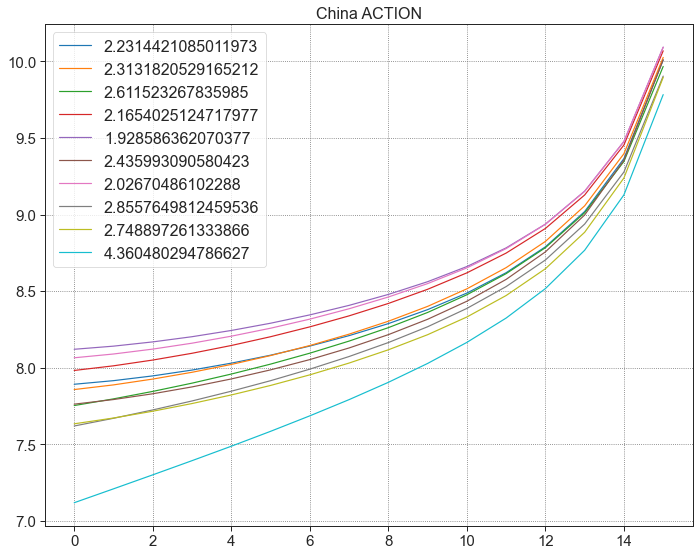

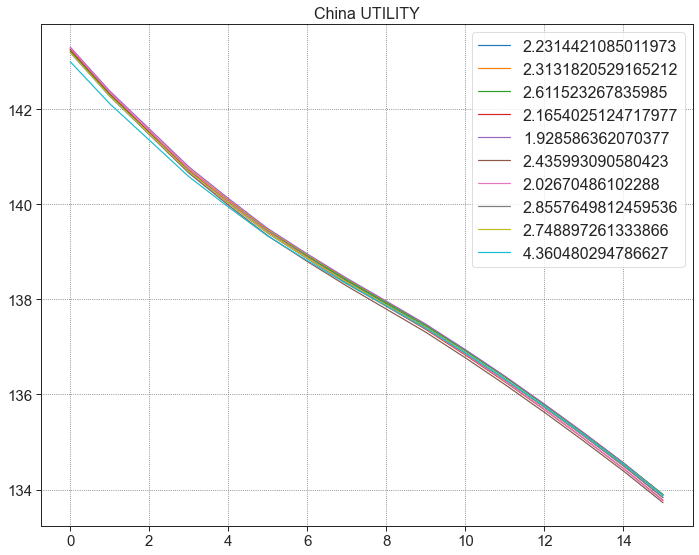

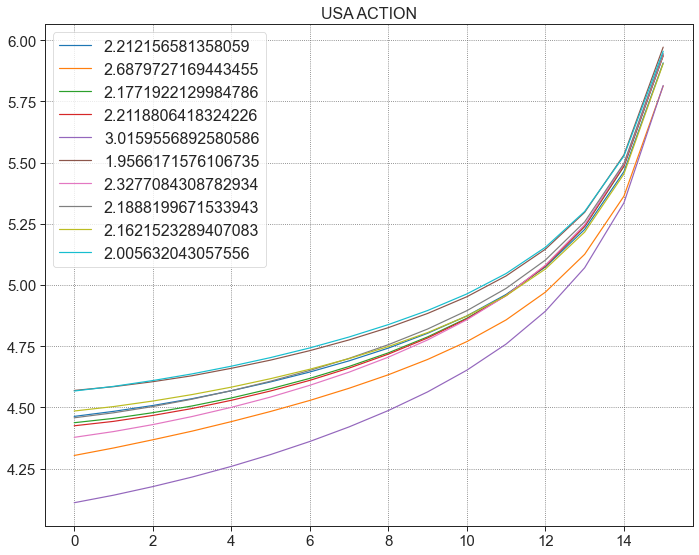

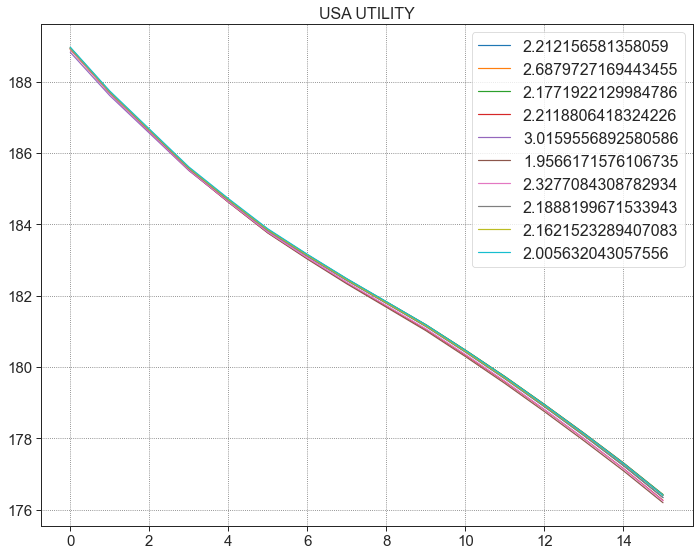

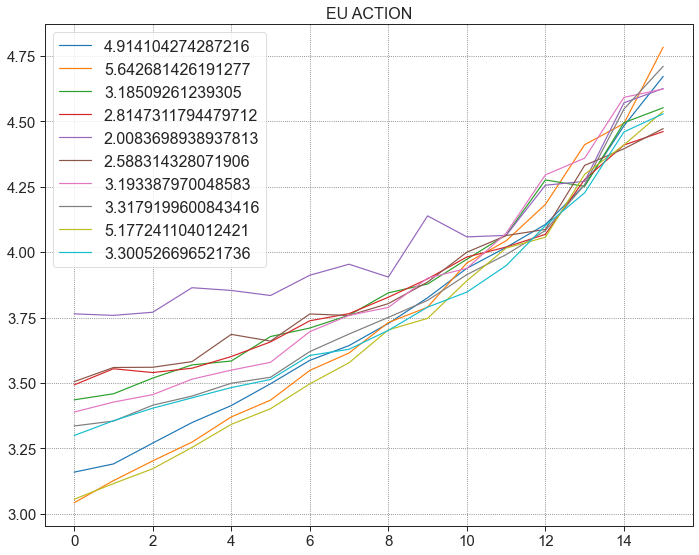

...

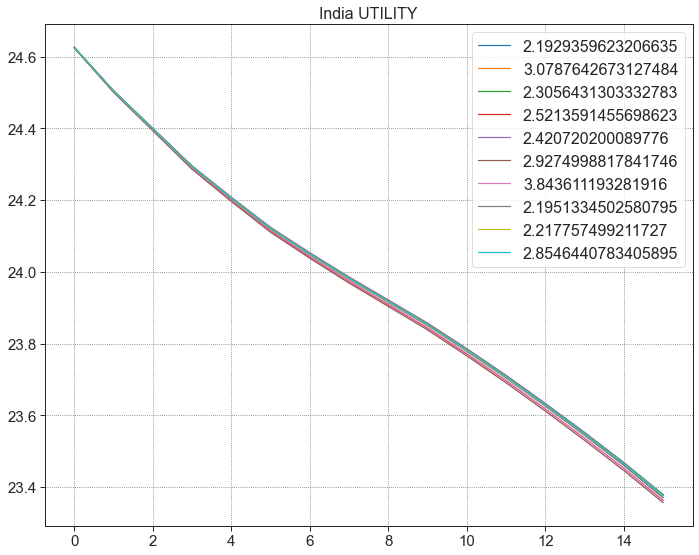

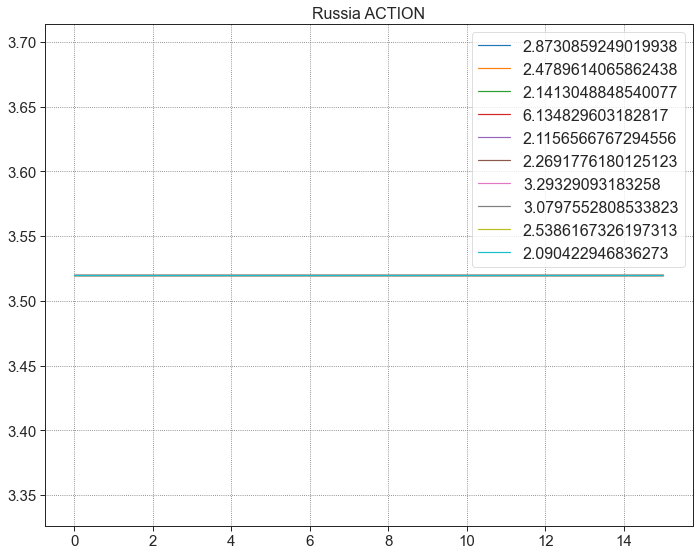

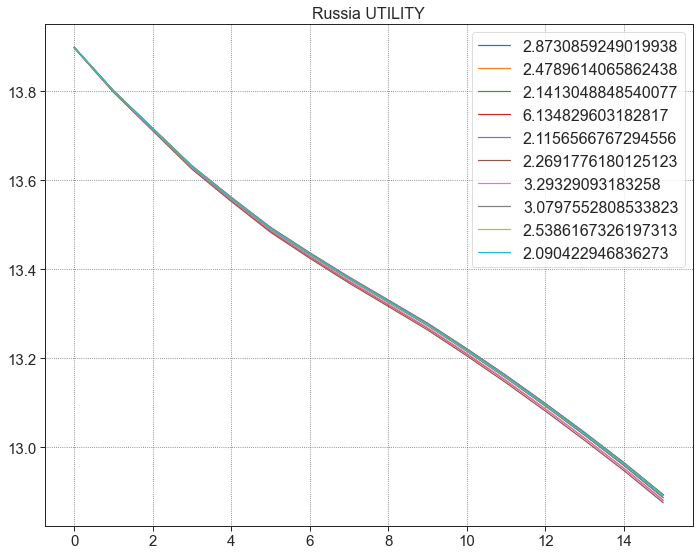

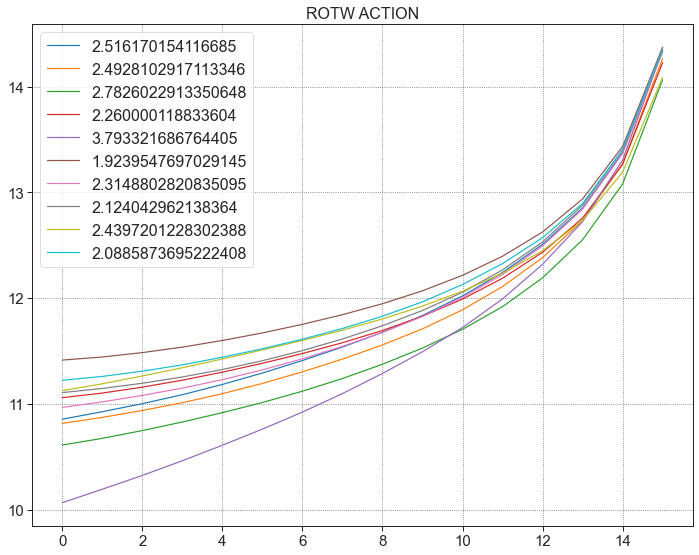

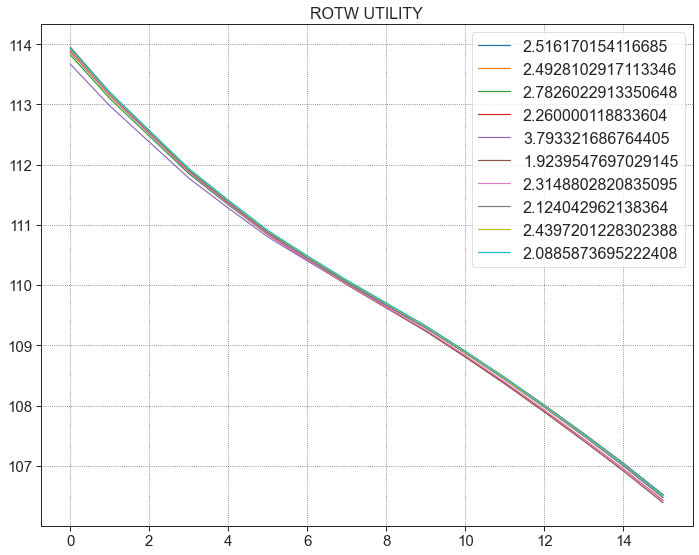

In [48]:
for l in range(N):

    plt.figure(figsize=(10,8))
    for k in range(10):

        plt.title(NAMES[l] + ' ACTION')
        plt.plot(res[0][0][k][l], label=all_temp[0][k][l])
    plt.legend()
    plt.show()

    plt.figure(figsize=(10,8))

    for k in range(10):
        plt.title(NAMES[l] + ' UTILITY')

        plt.plot(res[0][2][k][l], label=all_temp[0][k][l])
    plt.legend()

    plt.show()

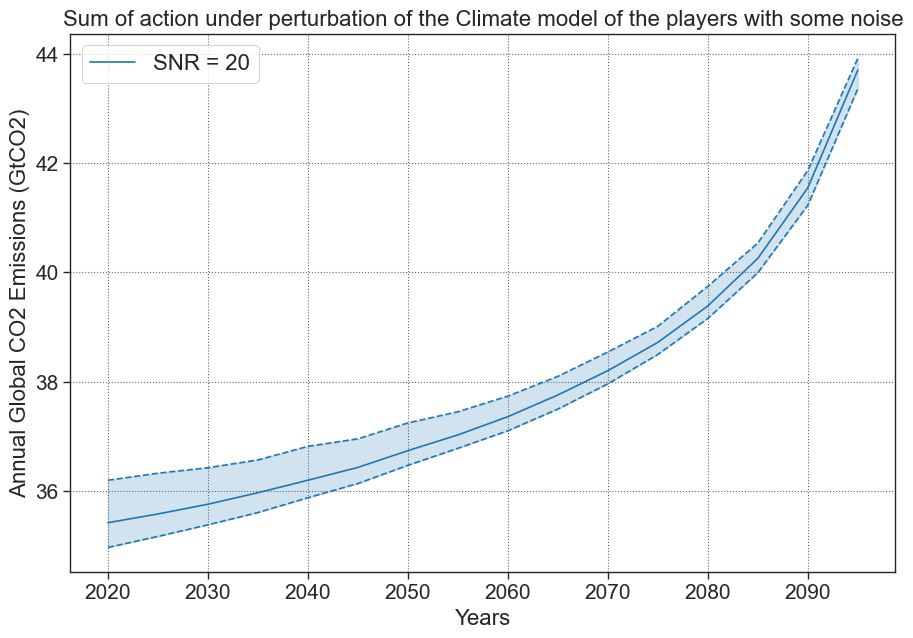

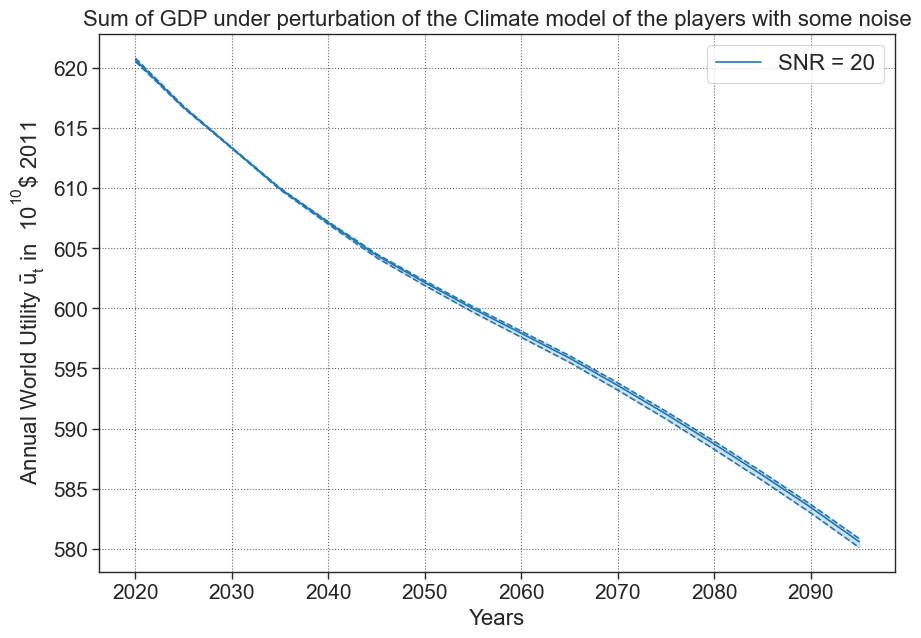

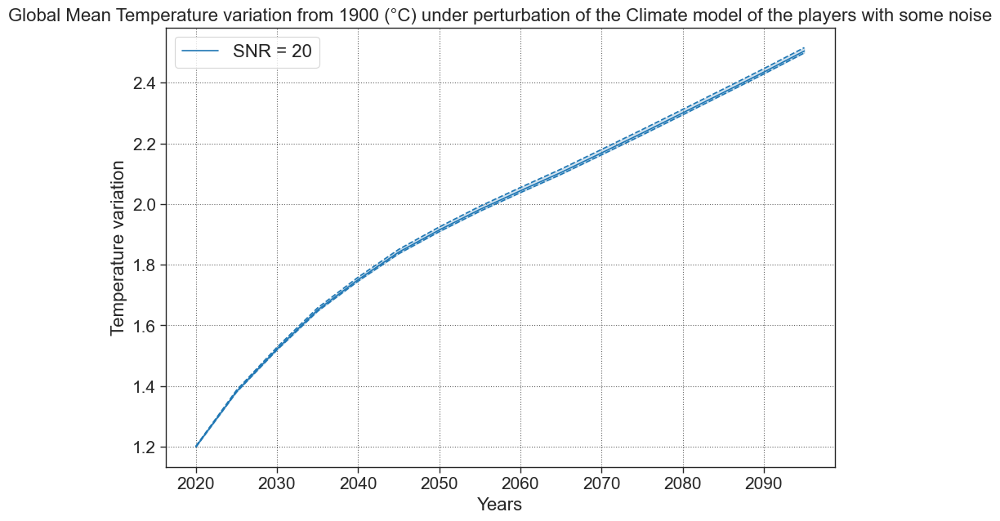

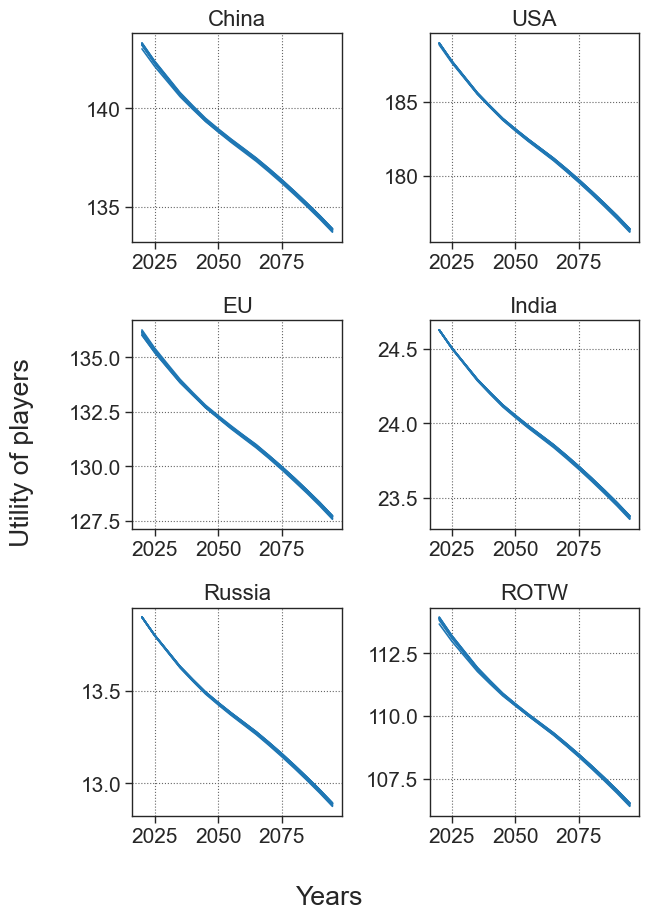

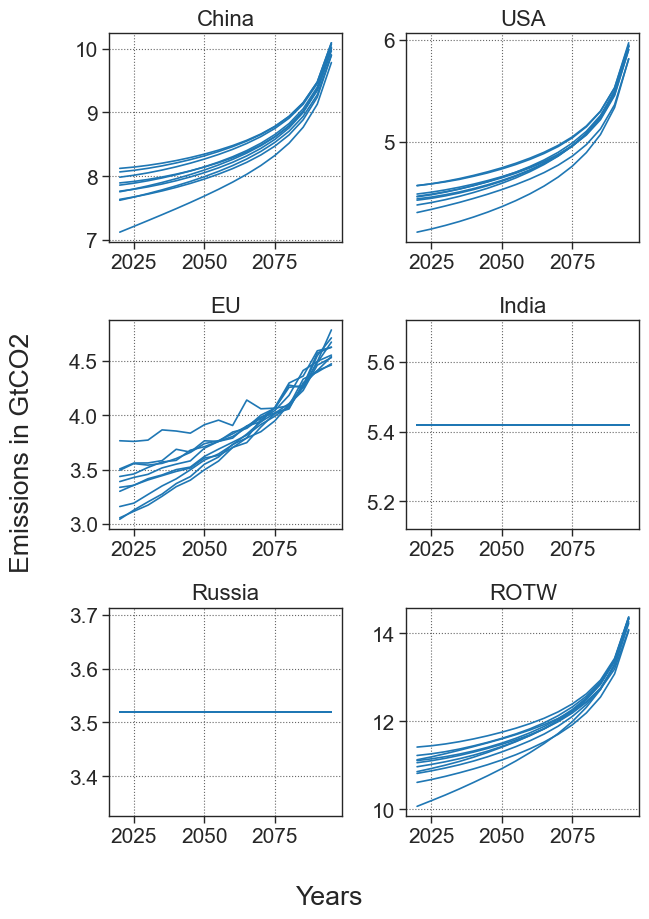

In [49]:
plots_noise(res, NOISE, 'test_plot', list_label=list_label, case = 'classic_sigmoid')

## MULTIPLE noise

In [50]:
NOISE = [5, 10, 20, 40]


In [51]:
res, all_temp = noise_game(list_param, list_label, noise=NOISE, horizon=horizon)

Running f(%s)
coef: 1.145x^{2} alpha: 1 function: Sigmoid
Noise:  5 dB


Planning BRD, t_piece = 16:   0%|          | 0/1 [00:00<?, ?it/s]

Planning BRD, t_piece = 16: 100%|██████████| 1/1 [00:01<00:00,  1.93s/it]


Noise:  10 dB


Planning BRD, t_piece = 16: 100%|██████████| 1/1 [00:01<00:00,  1.76s/it]


Noise:  20 dB


Planning BRD, t_piece = 16: 100%|██████████| 1/1 [00:01<00:00,  1.48s/it]


Noise:  40 dB


Planning BRD, t_piece = 16: 100%|██████████| 1/1 [00:01<00:00,  1.63s/it]

-----------------------------------------------------------


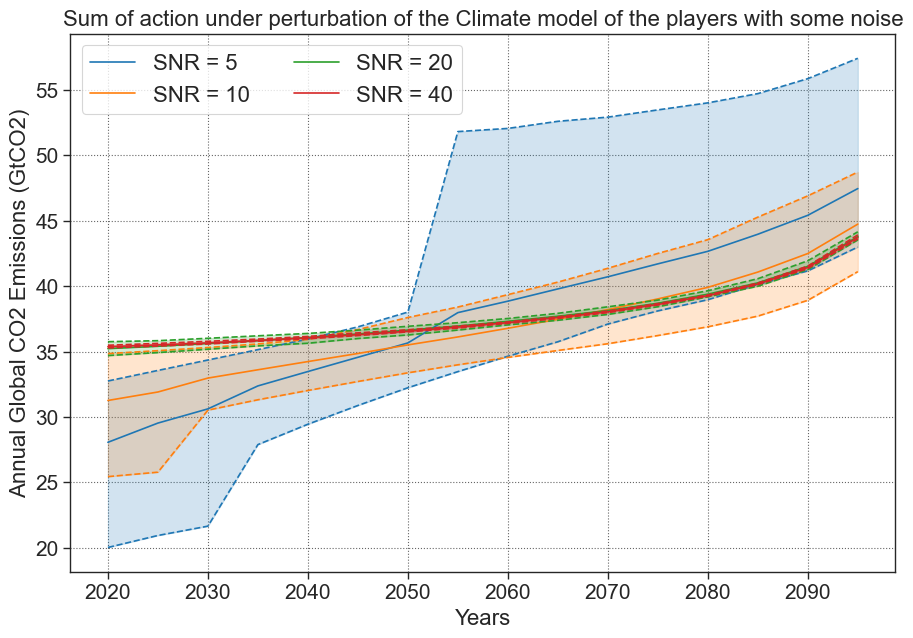

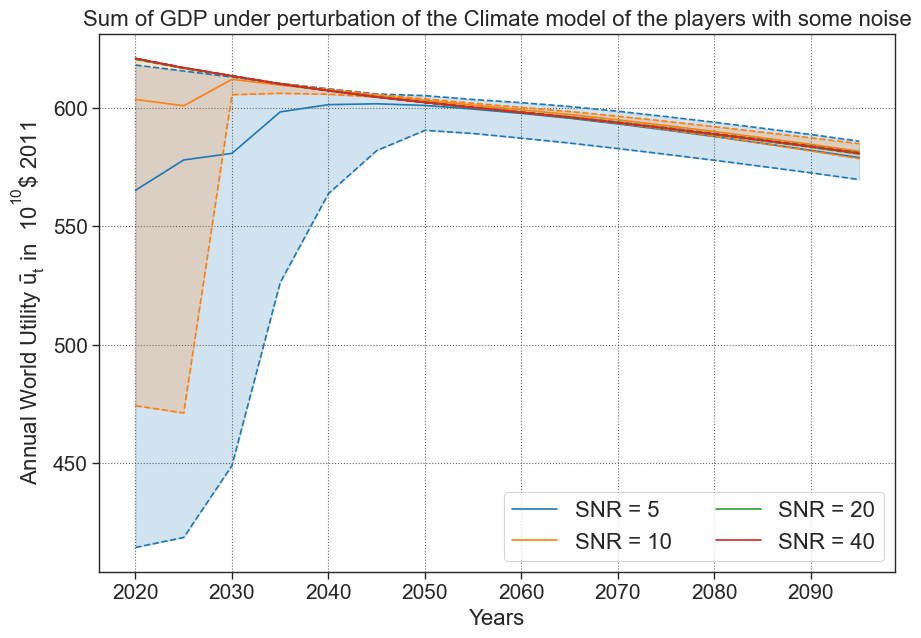

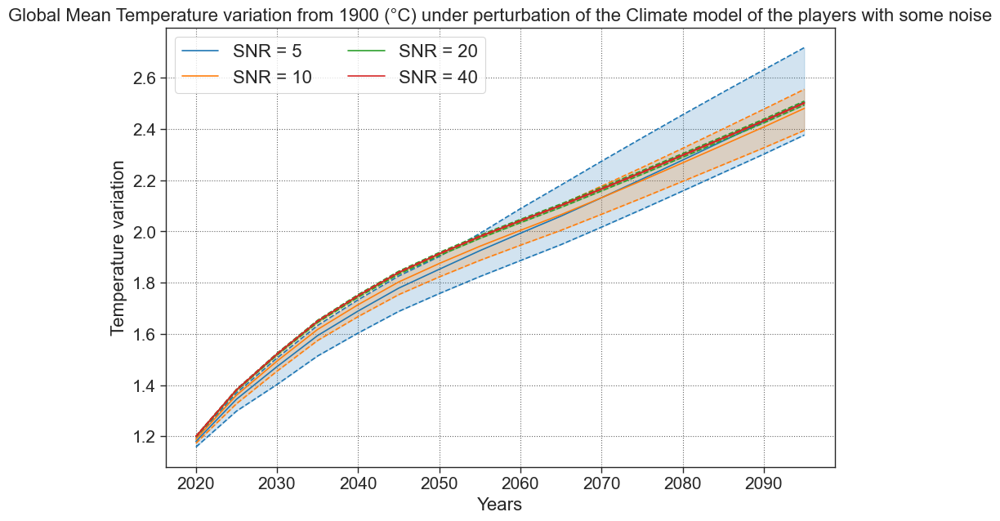

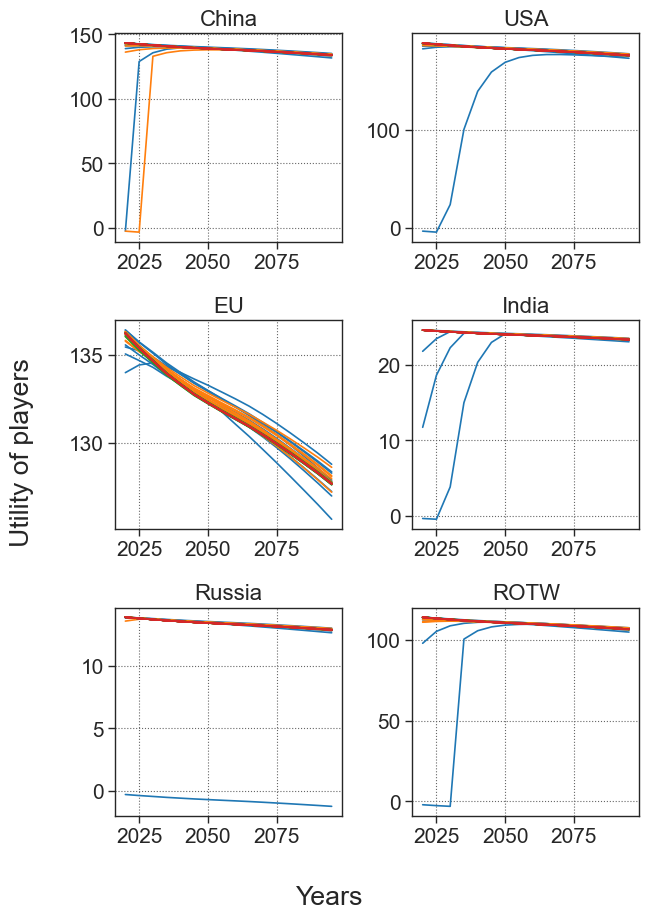

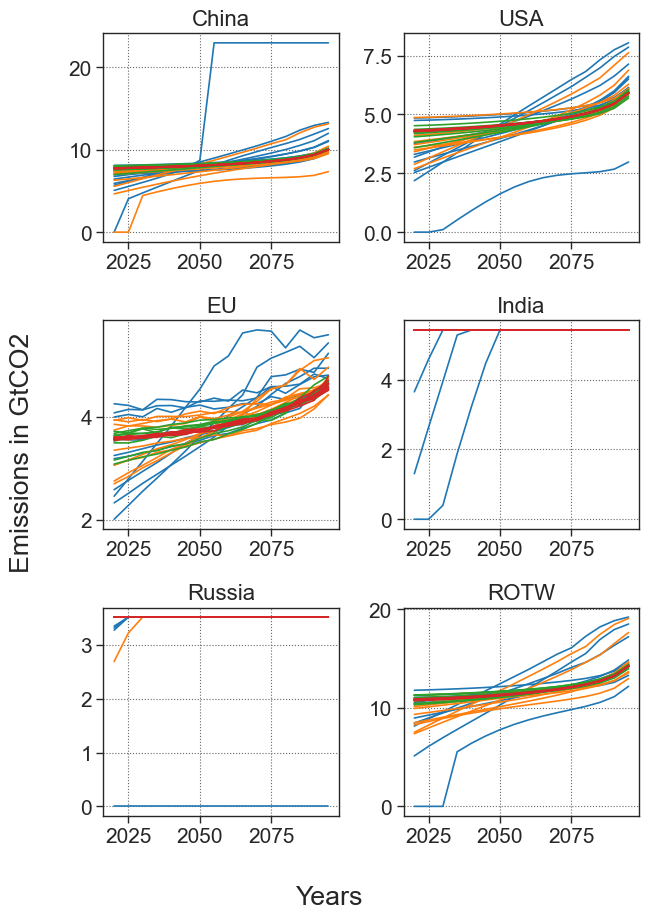

In [52]:
plots_noise(res, NOISE, 'test_plot', list_label=list_label, case = 'classic_sigmoid')

# COMMON NOISE

## NOISE high

In [53]:
NOISE = [5] #, 10]


In [54]:
res, all_temp = noise_game_common(list_param, list_label, noise=NOISE, horizon=horizon)

Running f(%s)
coef: 1.145x^{2} alpha: 1 function: Sigmoid
Noise:  5 dB


Planning BRD, t_piece = 16: 100%|██████████| 1/1 [00:01<00:00,  1.78s/it]

-----------------------------------------------------------


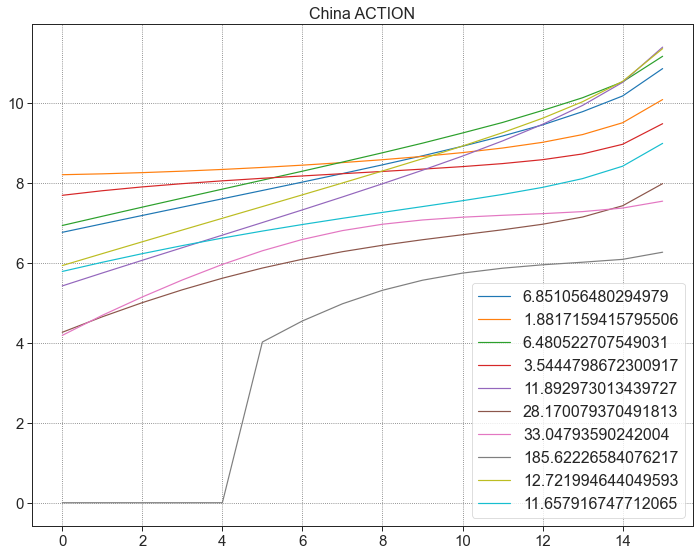

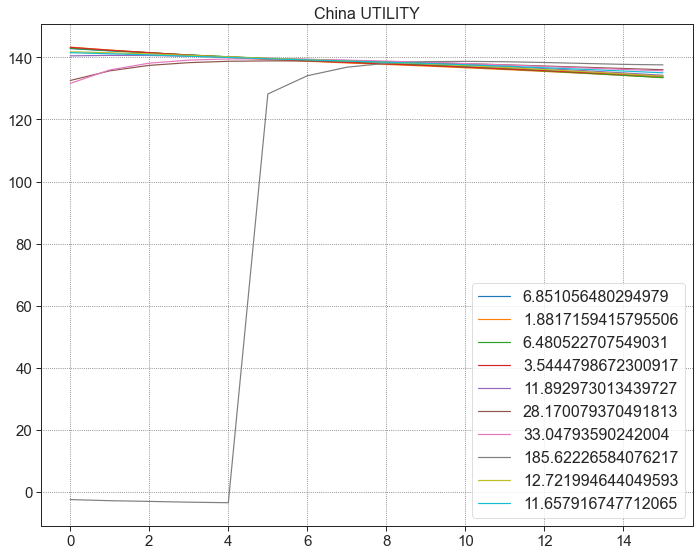

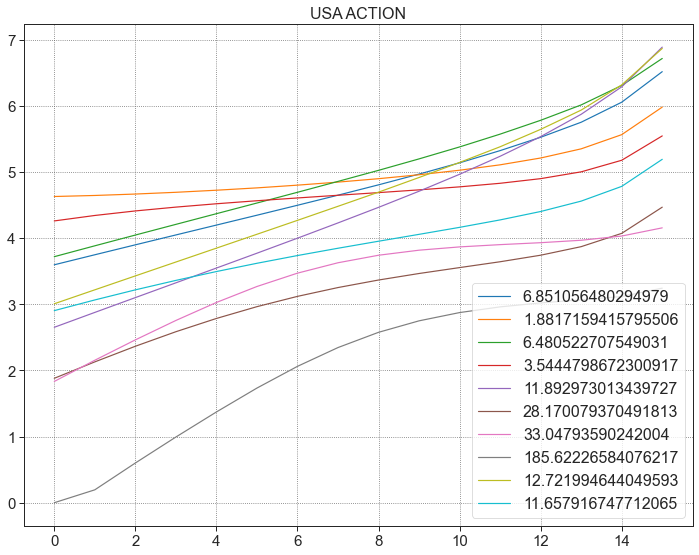

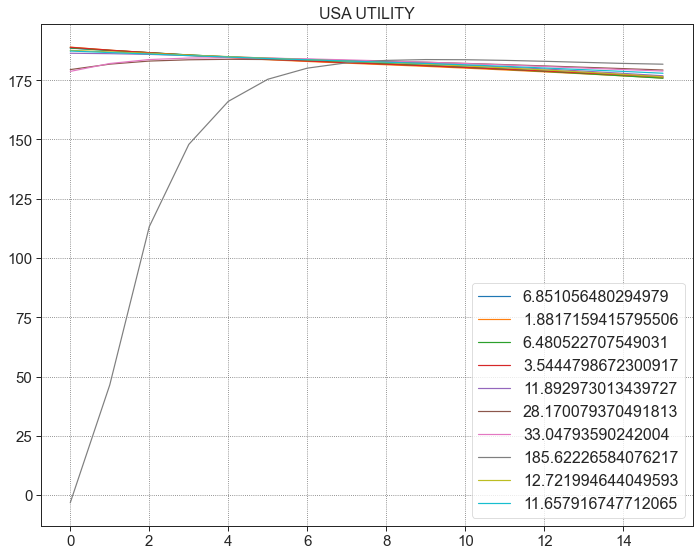

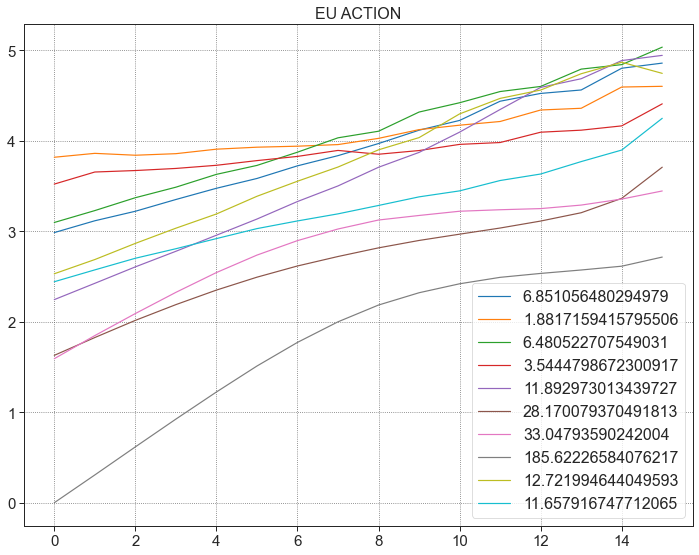

...

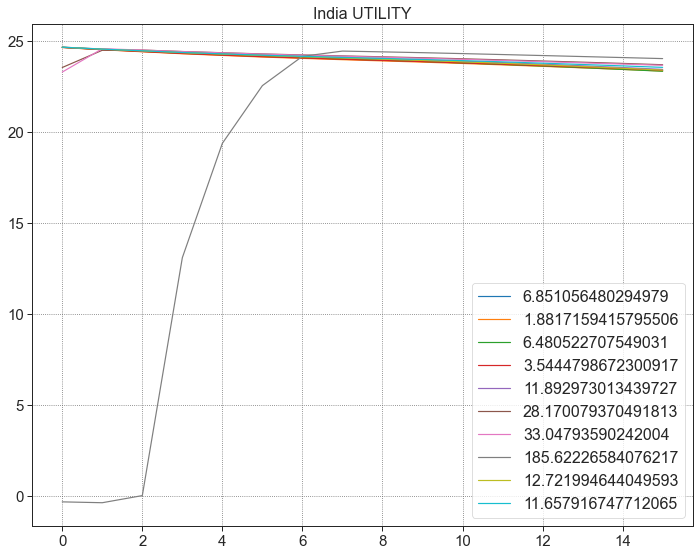

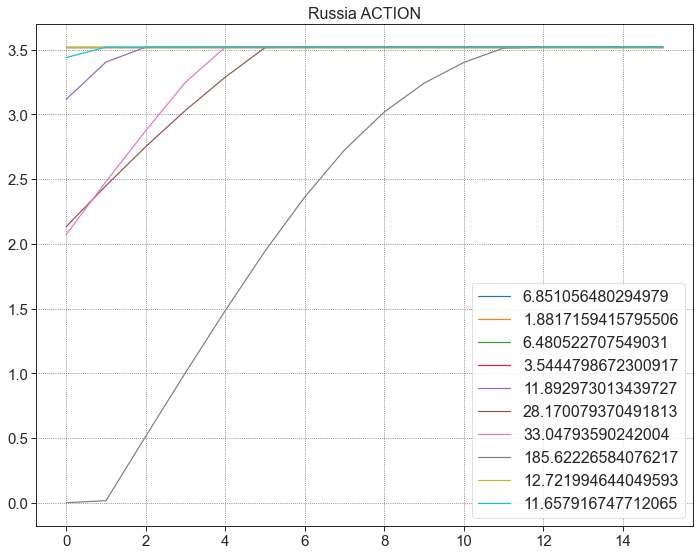

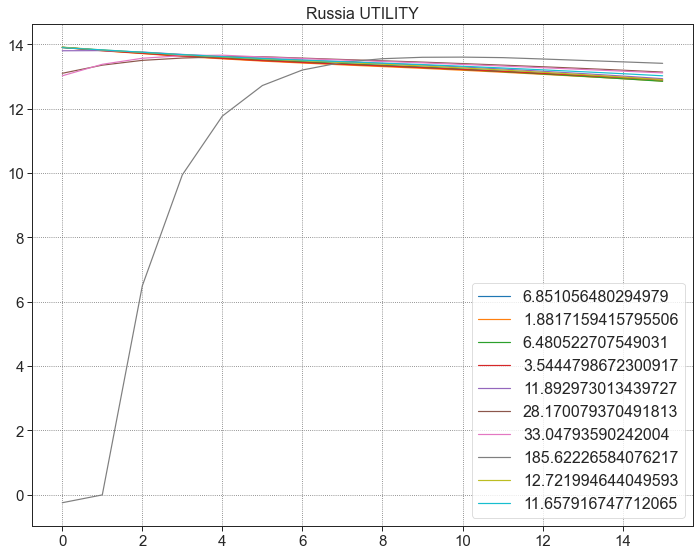

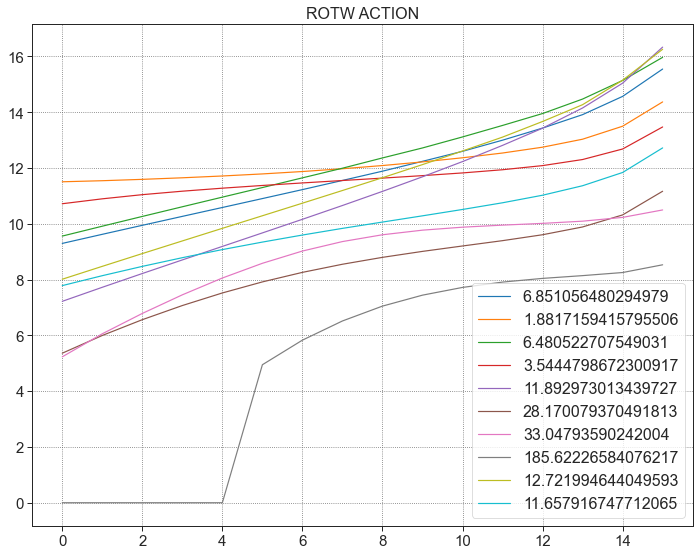

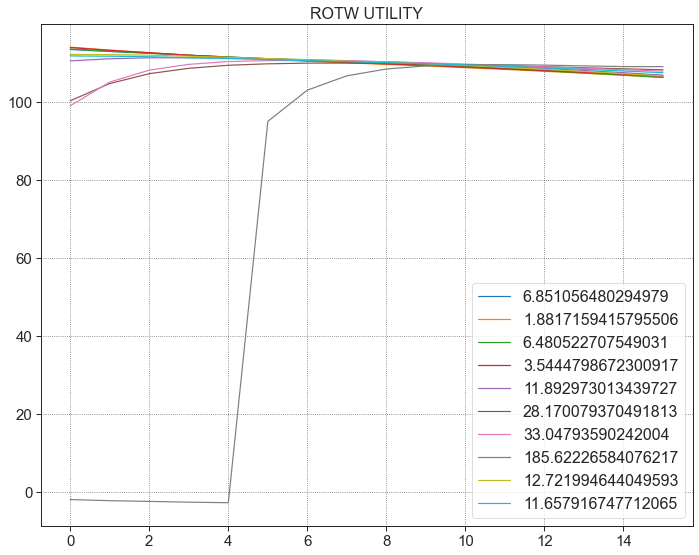

In [55]:
for l in range(N):

    plt.figure(figsize=(10,8))
    for k in range(10):

        plt.title(NAMES[l] + ' ACTION')
        plt.plot(res[0][0][k][l], label=all_temp[0][k][l])
    plt.legend()
    plt.show()

    plt.figure(figsize=(10,8))

    for k in range(10):
        plt.title(NAMES[l] + ' UTILITY')

        plt.plot(res[0][2][k][l], label=all_temp[0][k][l])
    plt.legend()

    plt.show()

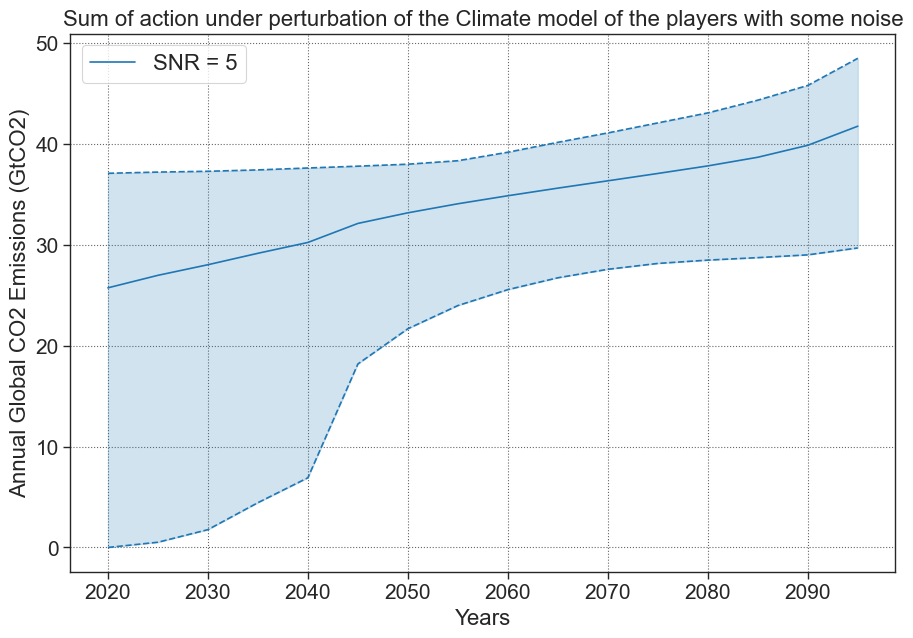

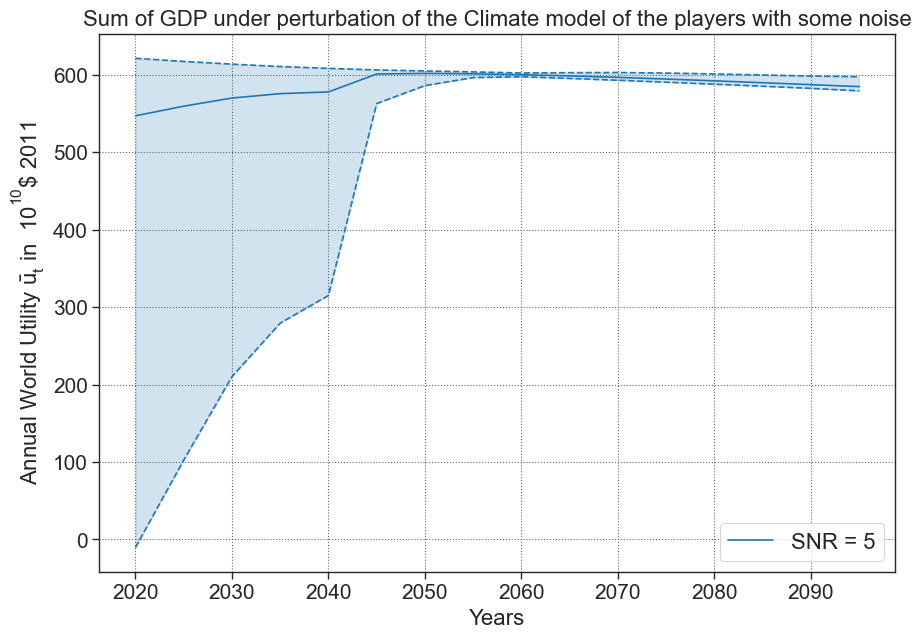

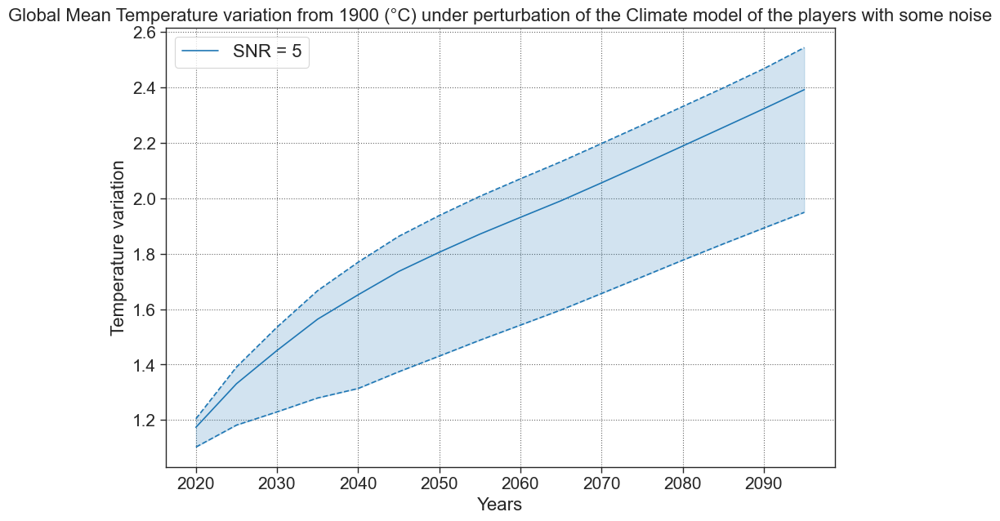

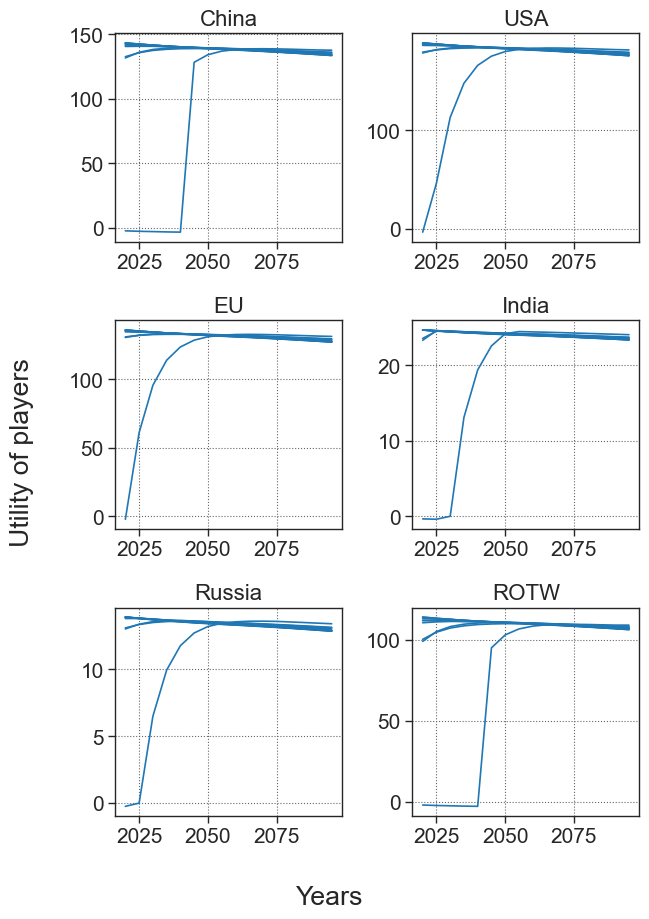

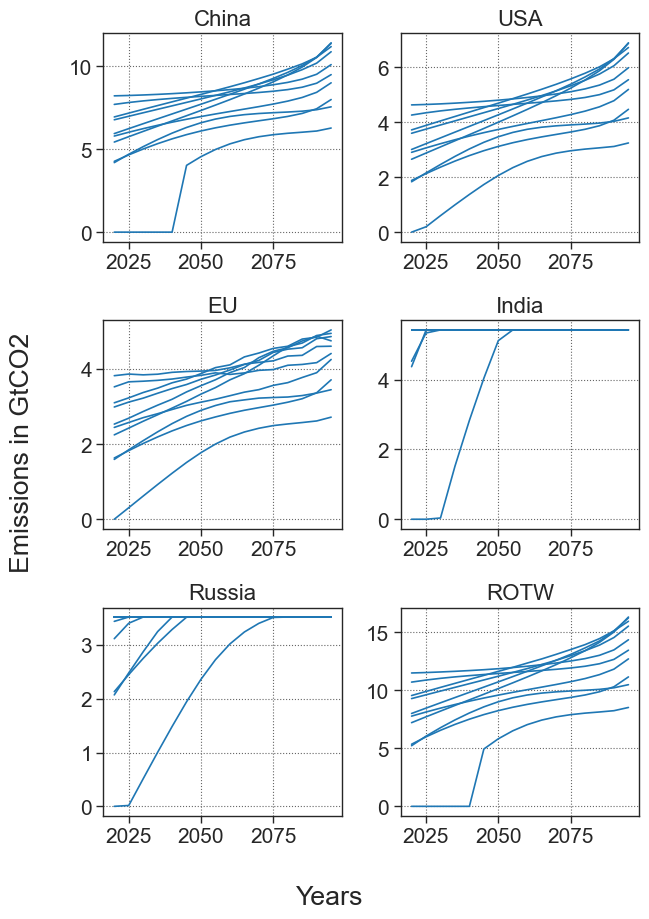

In [56]:
plots_noise(res, NOISE, 'test_plot', list_label=list_label, case = 'classic_sigmoid')

## NOISE low

In [57]:
NOISE = [20] #, 10]


In [58]:
res, all_temp = noise_game_common(list_param, list_label, noise=NOISE, horizon=horizon)

Running f(%s)
coef: 1.145x^{2} alpha: 1 function: Sigmoid
Noise:  20 dB


Planning BRD, t_piece = 16: 100%|██████████| 1/1 [00:01<00:00,  1.52s/it]

-----------------------------------------------------------


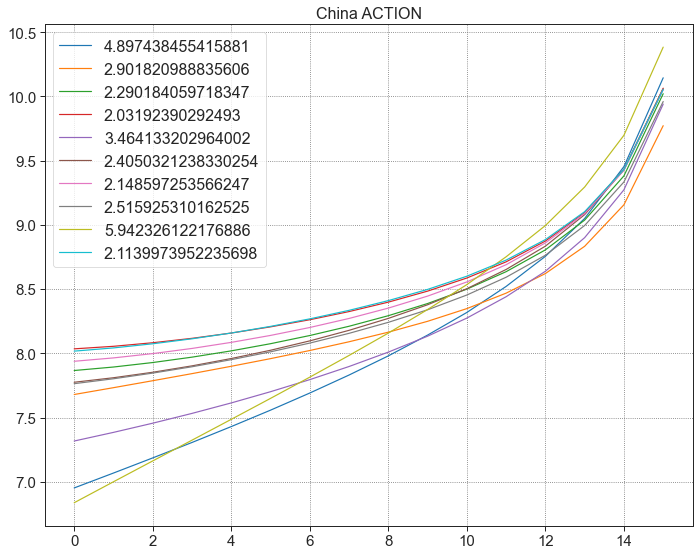

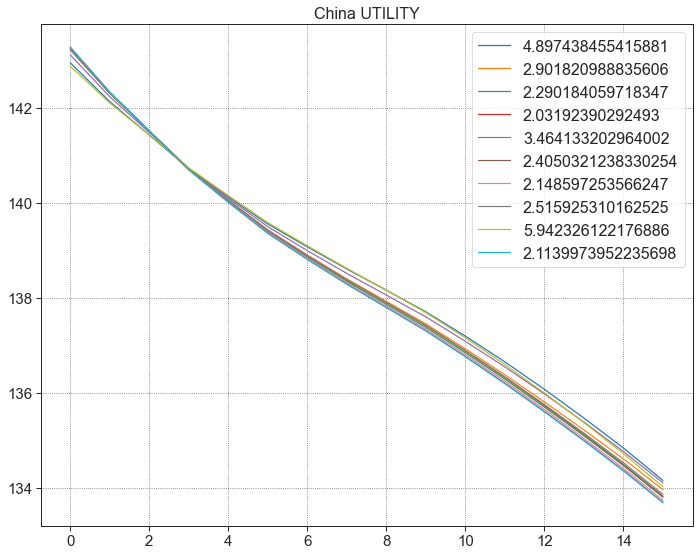

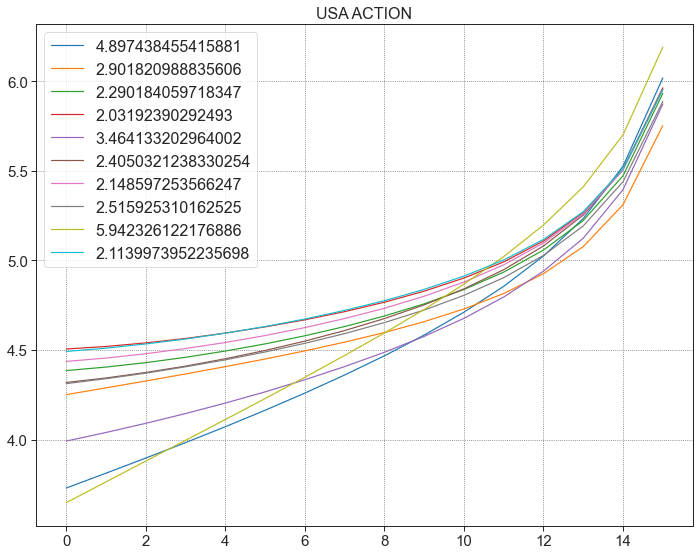

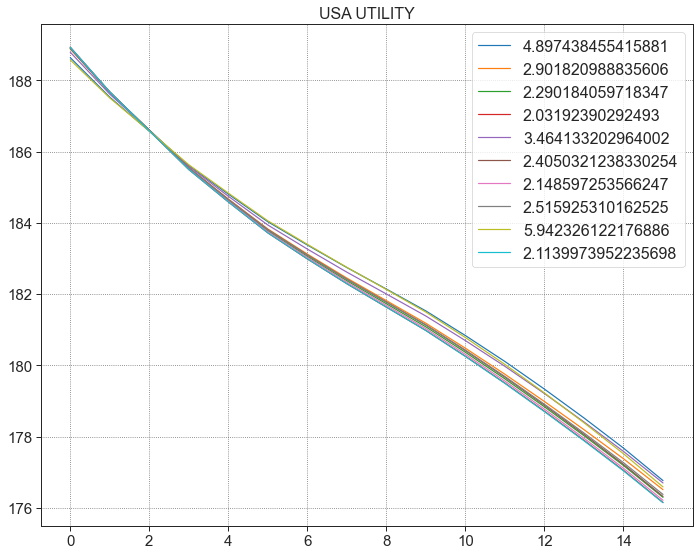

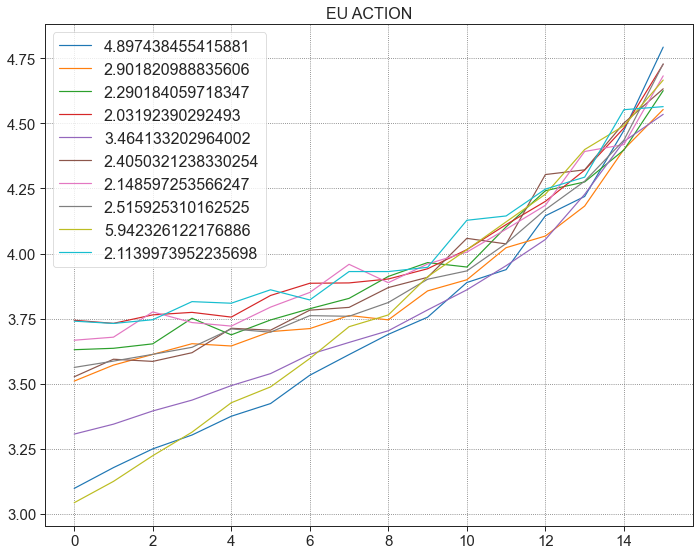

...

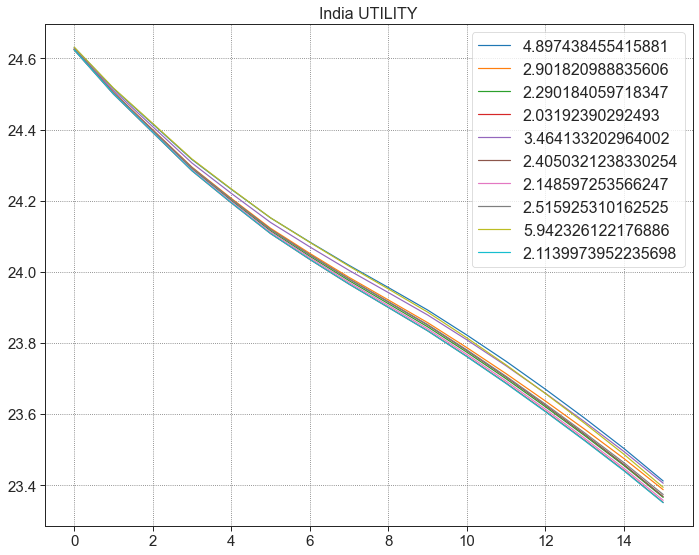

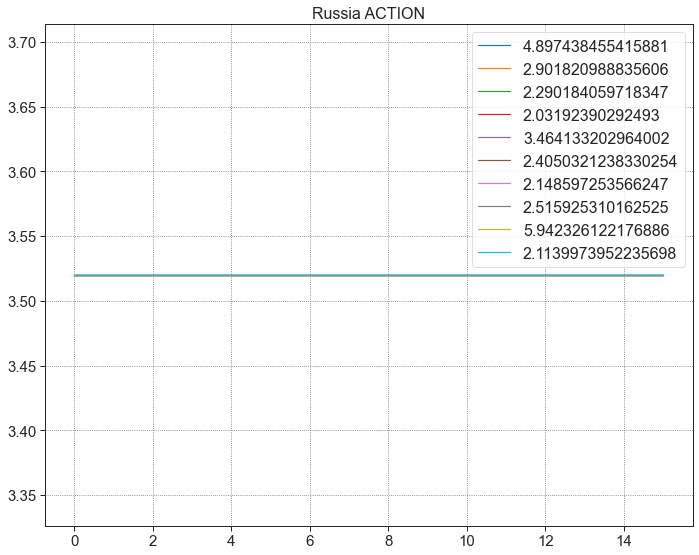

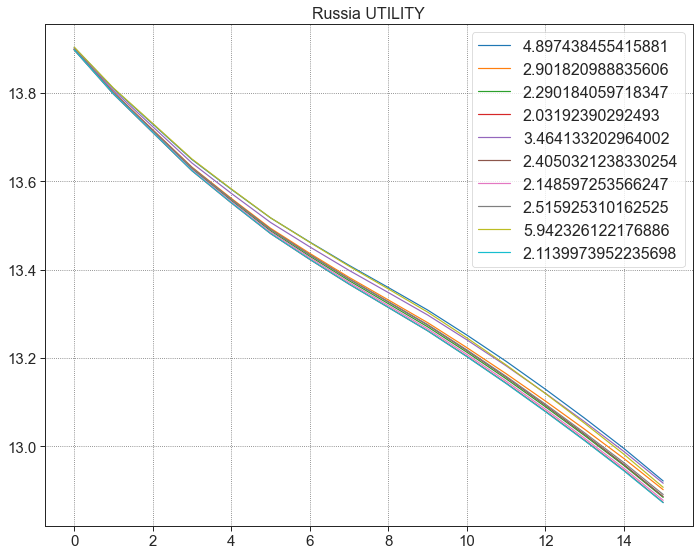

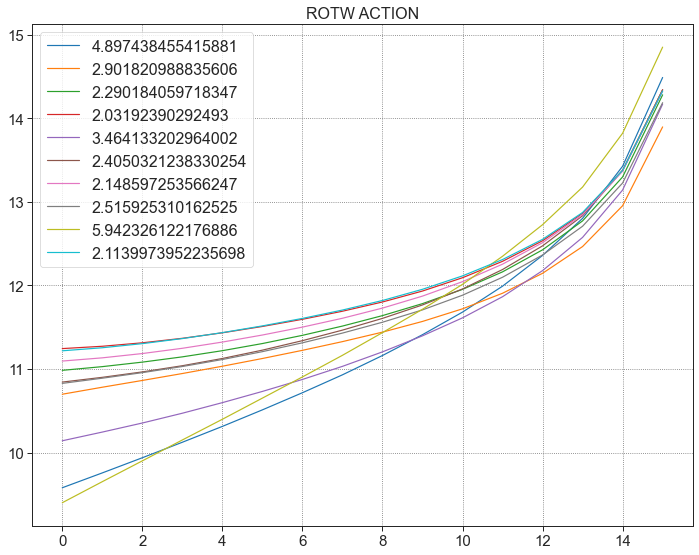

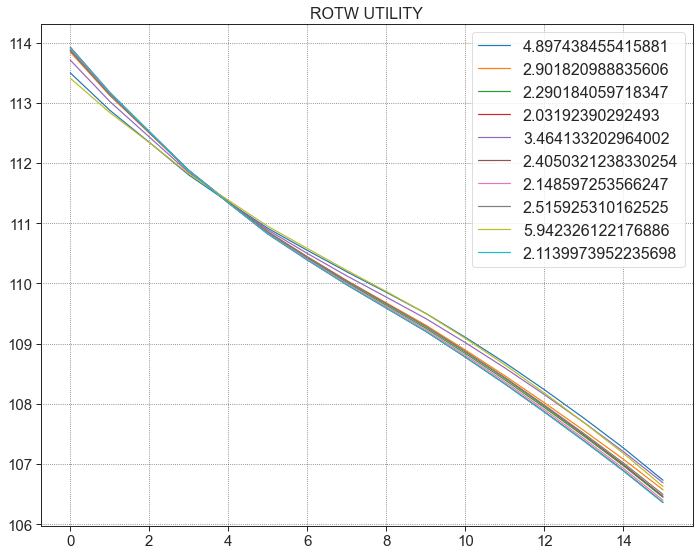

In [59]:
for l in range(N):

    plt.figure(figsize=(10,8))
    for k in range(10):

        plt.title(NAMES[l] + ' ACTION')
        plt.plot(res[0][0][k][l], label=all_temp[0][k][l])
    plt.legend()
    plt.show()

    plt.figure(figsize=(10,8))

    for k in range(10):
        plt.title(NAMES[l] + ' UTILITY')

        plt.plot(res[0][2][k][l], label=all_temp[0][k][l])
    plt.legend()

    plt.show()

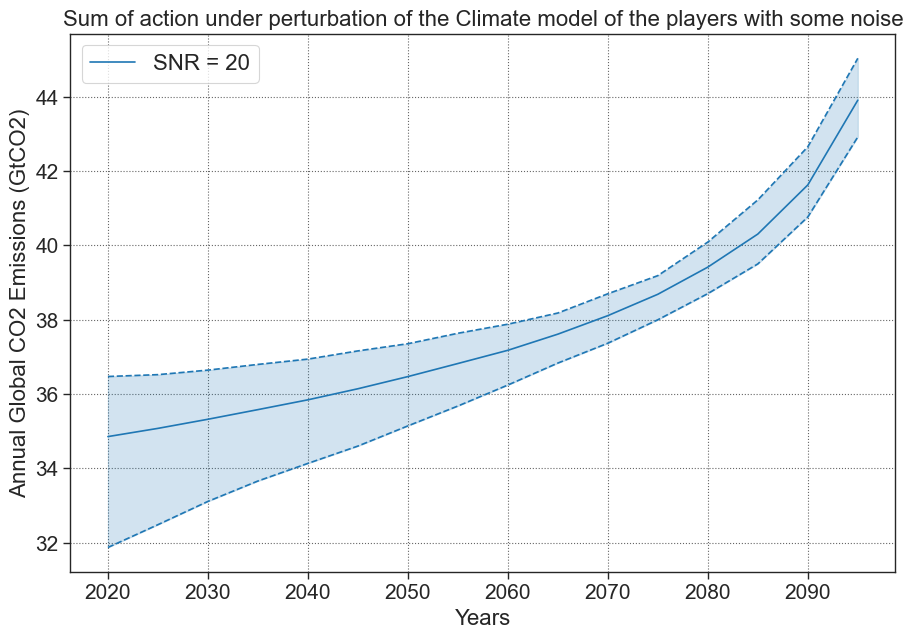

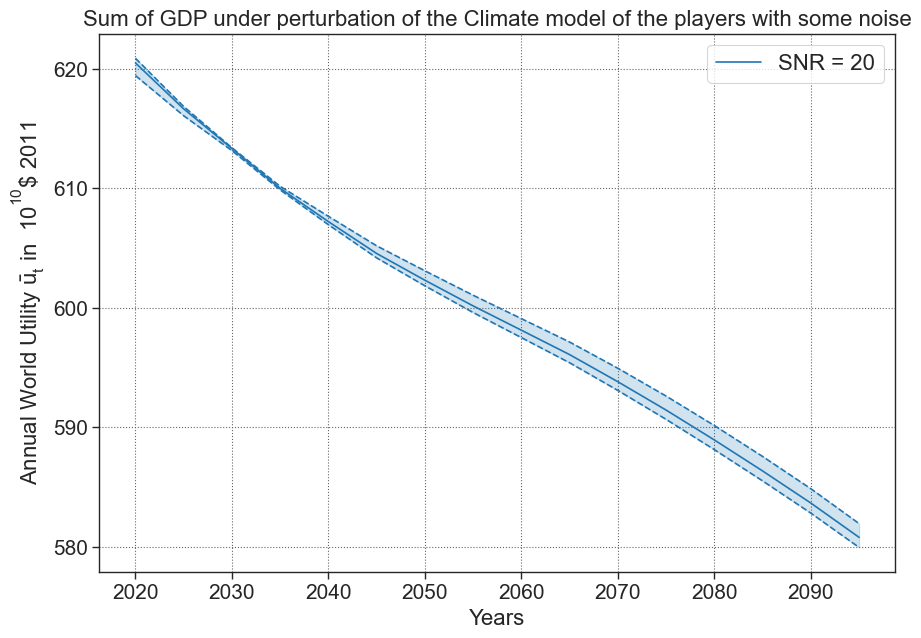

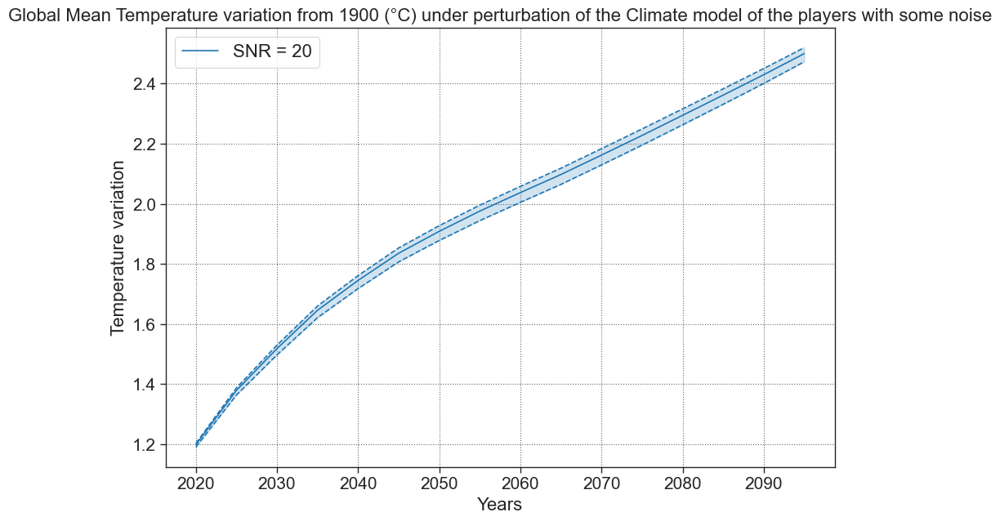

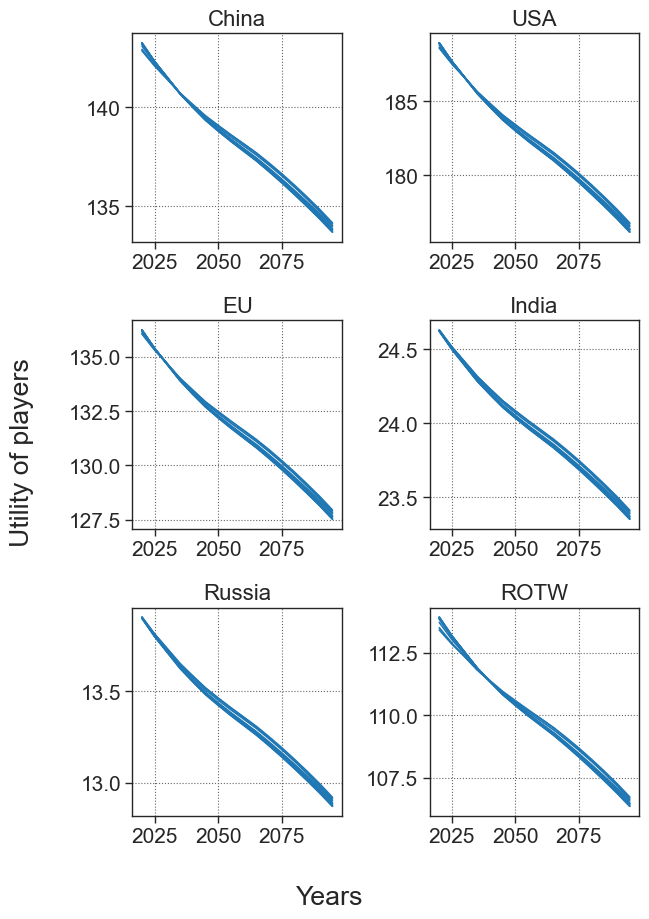

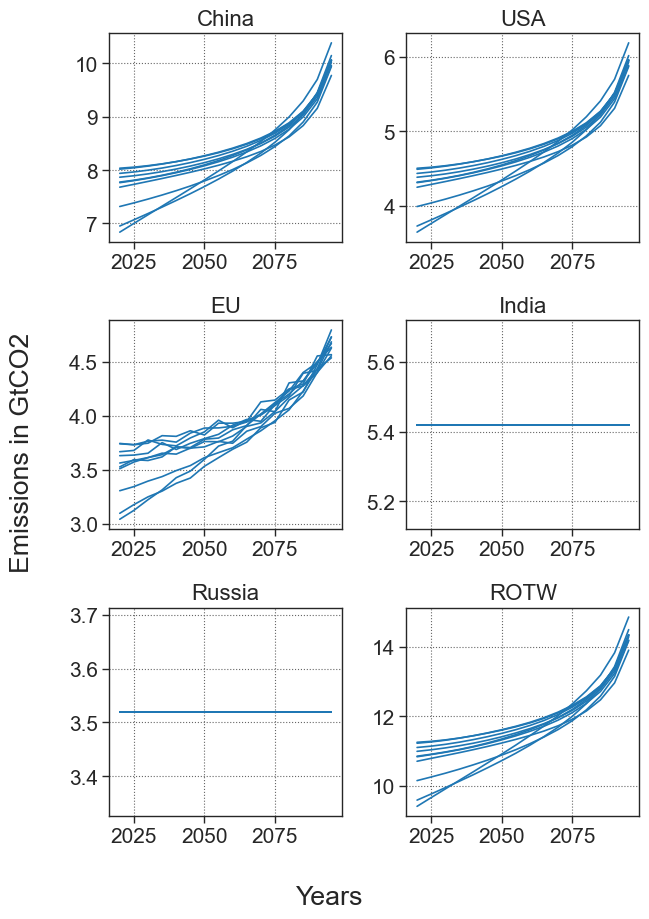

In [60]:
plots_noise(res, NOISE, 'test_plot', list_label=list_label, case = 'classic_sigmoid')

## MULTIPLE noise

In [61]:
NOISE = [5, 10, 20, 40]


In [62]:
res, all_temp = noise_game_common(list_param, list_label, noise=NOISE, horizon=horizon)

Running f(%s)
coef: 1.145x^{2} alpha: 1 function: Sigmoid
Noise:  5 dB


Planning BRD, t_piece = 16: 100%|██████████| 1/1 [00:01<00:00,  1.37s/it]


Noise:  10 dB


Planning BRD, t_piece = 16: 100%|██████████| 1/1 [00:01<00:00,  1.89s/it]


Noise:  20 dB


Planning BRD, t_piece = 16: 100%|██████████| 1/1 [00:01<00:00,  1.76s/it]


Noise:  40 dB


Planning BRD, t_piece = 16: 100%|██████████| 1/1 [00:02<00:00,  2.12s/it]

-----------------------------------------------------------


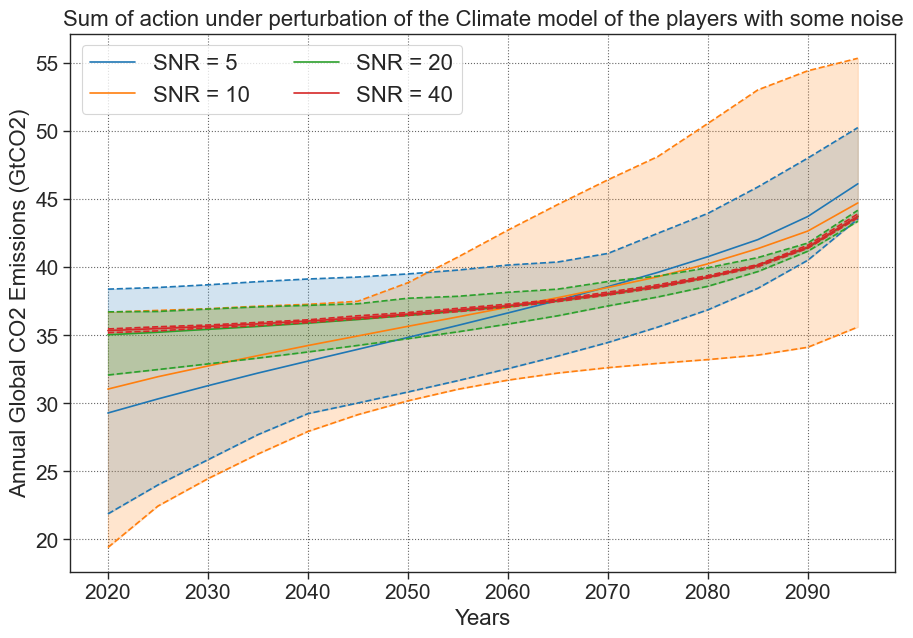

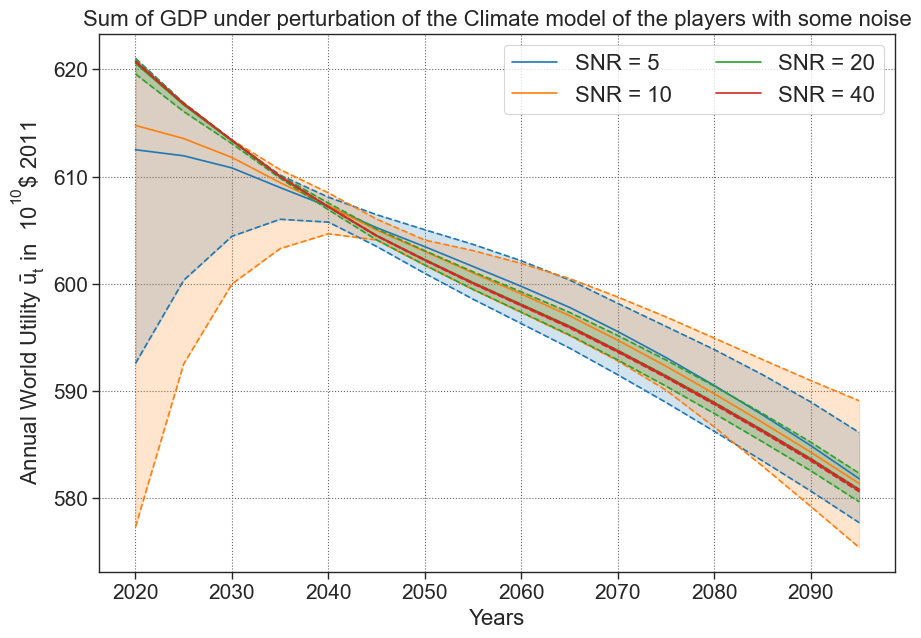

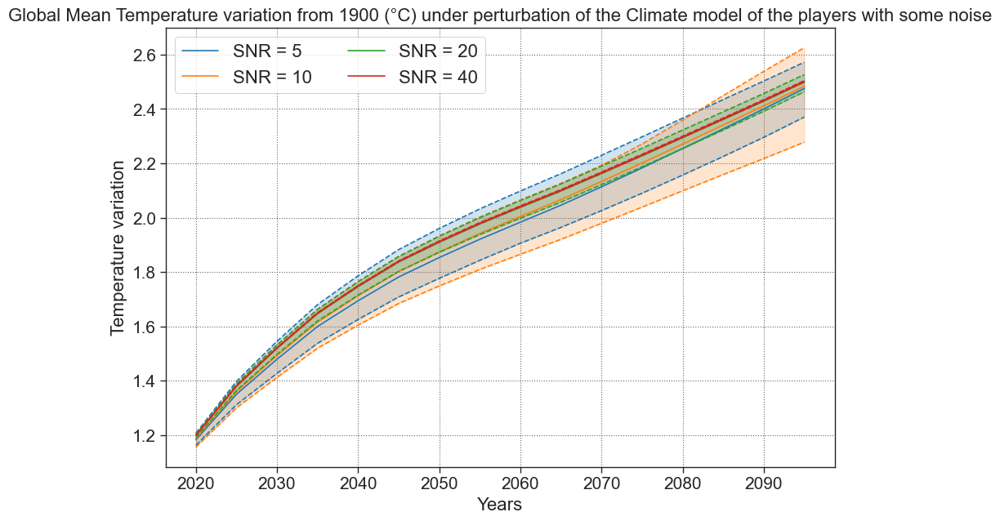

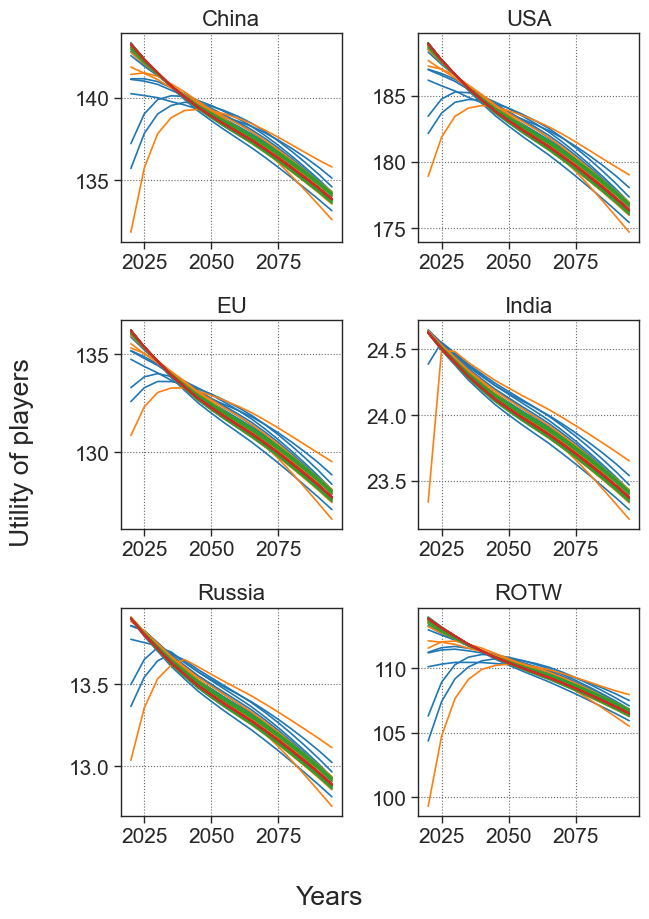

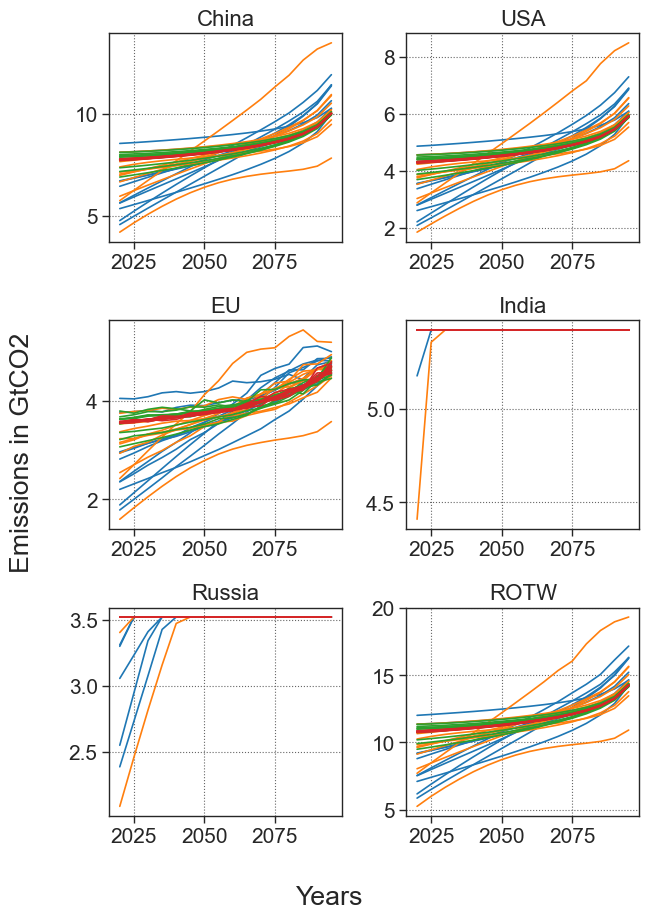

In [63]:
plots_noise(res, NOISE, 'test_plot', list_label=list_label, case = 'classic_sigmoid')

# END

In [67]:
!pip install py-spy

Defaulting to user installation because normal site-packages is not writeable


In [71]:
import s

ModuleNotFoundError: No module named 'spy'

In [ ]:
@pyspy.sampling
def noise_game(list_param, list_label, horizon, noise, temperature_target=None, final_multiplier=None):
    
    print('Running f(%s)' )

    noisy_results = []

    # loop over parameter and label lists
    for param, label in zip(list_param, list_label):
        print('coef:', label[0], 'alpha:', label[1], 'function:', label[2][0])
        

        # create list of players
        damage_coef, alpha, list_benefit_functions = param
        list_players = create_players(alpha=alpha, list_benefit_functions=list_benefit_functions, damage_function=damage_polynome(damage_coef), discount=1)

            # create game instance

        all_temp = []
        for nois in noise : 
            noisy_ = []
            print('Noise: ', nois, 'dB')
            temps = []
            for _ in range(10): 
                temp = []
                game = Game(list_players, horizon=horizon, temperature_target=temperature_target, final_multiplier=final_multiplier)
                # print('0',  ll)

                game = noise_climate_model( nois, game)
                # print('avant', ll - game.list_players[0].scm.temperature_model.At)
                rr  = game.planning_BRD_by_piece_return(game.T)
                noisy_.append(game.planning_BRD_by_piece_return(game.T))
            #     print('apres', ll - game.list_players[0].scm.temperature_model.At)
                for player in game.list_players:
                    temp.append(player.scm.evaluate_trajectory(rr[1])[-1][-1])

                temps.append(temp)
            noisy_ = list(zip(*noisy_))
            all_temp.append(temps)
            noisy_results.append(noisy_)
        print('-----------------------------------------------------------')


    return noisy_results, all_temp

In [ ]:

res, all_temp = noise_game(list_param, list_label, noise=NOISE, horizon=horizon)

Running f(%s)
coef: 1.145x^{2} alpha: 1 function: Sigmoid
Noise:  20 dB


Planning BRD, t_piece = 16: 100%|██████████| 1/1 [00:01<00:00,  1.52s/it]

-----------------------------------------------------------


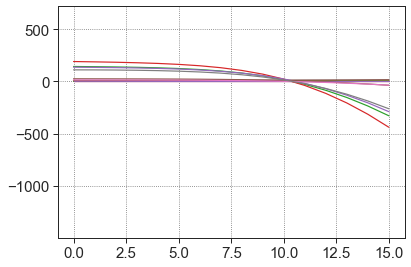

In [122]:
for k in res[0]:
    for kk in k[0]:
        plt.plot(kk)  

In [124]:
res[0]

[(array([[ 6.02855955,  6.23788866,  6.44427812,  6.6475783 ,  6.84871808,
           7.04833074,  7.24642518,  7.44605723,  7.64876768,  7.85751669,
           8.07757222,  8.31548094,  8.58394769,  8.90531212,  9.33526791,
          10.05226275],
         [ 5.02299979,  5.02446268,  5.03204333,  5.04609221,  5.06735486,
           5.09379924,  5.12705563,  5.16515414,  5.20800439,  5.25812904,
           5.31605133,  5.38690042,  5.4758149 ,  5.59385387,  5.76761338,
           6.0843801 ],
         [ 2.44722006,  2.55346218,  2.65703258,  2.76089717,  2.86201823,
           2.9843542 ,  3.0874114 ,  3.19397791,  3.33655346,  3.47215685,
           3.58702508,  3.75932335,  3.9560002 ,  4.13110852,  4.43205418,
           4.51802853],
         [ 5.42      ,  5.42      ,  5.42      ,  5.42      ,  5.42      ,
           5.42      ,  5.42      ,  5.42      ,  5.42      ,  5.42      ,
           5.42      ,  5.42      ,  5.42      ,  5.42      ,  5.42      ,
           5.42      ],
    

In [102]:
len(list(zip(*res[0])))

5

In [92]:
list(zip(*res))

[(array([[ 7.92581756,  7.93456174,  7.95487933,  7.98382246,  8.02137068,
           8.06604799,  8.1186092 ,  8.17918887,  8.24921337,  8.33117521,
           8.42923032,  8.55110466,  8.70907635,  8.9276406 ,  9.26236242,
           9.89454075],
         [ 3.49322738,  3.60977084,  3.72620087,  3.84307523,  3.9611687 ,
           4.08125351,  4.20523499,  4.33374004,  4.46880715,  4.61206119,
           4.76701571,  4.93801349,  5.13193129,  5.36321575,  5.66567374,
           6.14941877],
         [ 2.87350059,  2.91843349,  2.97343029,  3.02935996,  3.06608227,
           3.13990239,  3.19749715,  3.26036734,  3.32999605,  3.42373219,
           3.51726621,  3.63387502,  3.74370076,  3.92125793,  4.18542978,
           4.32997019],
         [ 5.42      ,  5.42      ,  5.42      ,  5.42      ,  5.42      ,
           5.42      ,  5.42      ,  5.42      ,  5.42      ,  5.42      ,
           5.42      ,  5.42      ,  5.42      ,  5.42      ,  5.42      ,
           5.42      ],
    

In [93]:
list(zip(*res))

[(array([[ 7.92581756,  7.93456174,  7.95487933,  7.98382246,  8.02137068,
           8.06604799,  8.1186092 ,  8.17918887,  8.24921337,  8.33117521,
           8.42923032,  8.55110466,  8.70907635,  8.9276406 ,  9.26236242,
           9.89454075],
         [ 3.49322738,  3.60977084,  3.72620087,  3.84307523,  3.9611687 ,
           4.08125351,  4.20523499,  4.33374004,  4.46880715,  4.61206119,
           4.76701571,  4.93801349,  5.13193129,  5.36321575,  5.66567374,
           6.14941877],
         [ 2.87350059,  2.91843349,  2.97343029,  3.02935996,  3.06608227,
           3.13990239,  3.19749715,  3.26036734,  3.32999605,  3.42373219,
           3.51726621,  3.63387502,  3.74370076,  3.92125793,  4.18542978,
           4.32997019],
         [ 5.42      ,  5.42      ,  5.42      ,  5.42      ,  5.42      ,
           5.42      ,  5.42      ,  5.42      ,  5.42      ,  5.42      ,
           5.42      ,  5.42      ,  5.42      ,  5.42      ,  5.42      ,
           5.42      ],
    

In [70]:
(list_ne, list_so, list_ne_u, list_so_u, list_ne_planning_u, list_so_planning_u, 
            list_sum_action, list_sum_utilities, list_temp, list_sum_action_so, list_sum_utilities_so, list_temp_so, 
            list_sum_action_planning, list_sum_utilities_planning, list_temp_planning, list_sum_action_planning_so, 
            list_sum_utilities_planning_so, list_temp_planning_so, list_ne_planning, list_so_planning)= noise_game(list_param, list_label, noise=[10, 15, 20], horizon=horizon)

Running f(%s)
coef: 2x^{2}-2x alpha: 1 function: Sigmoid
-----------------------------------------------------------


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


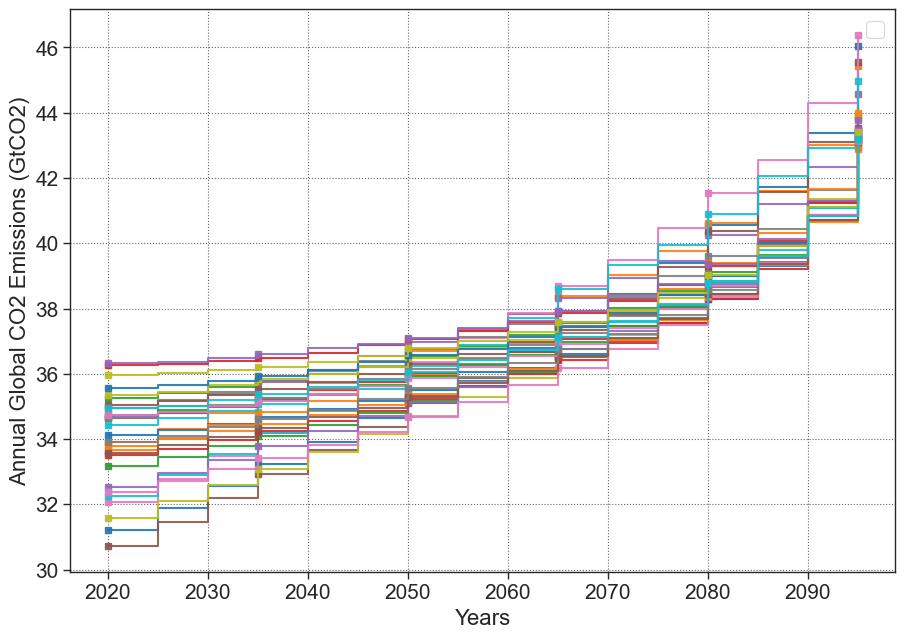

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


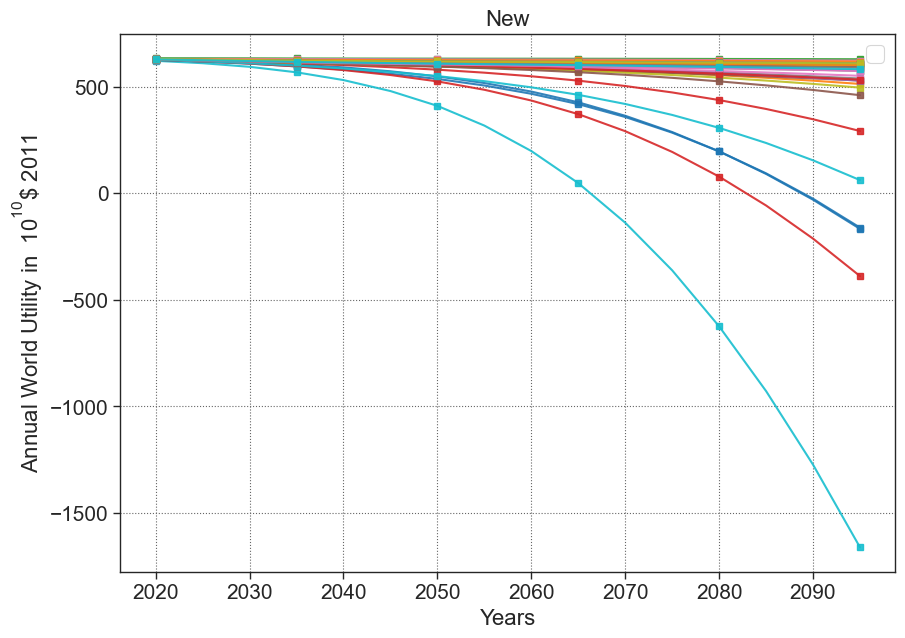

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


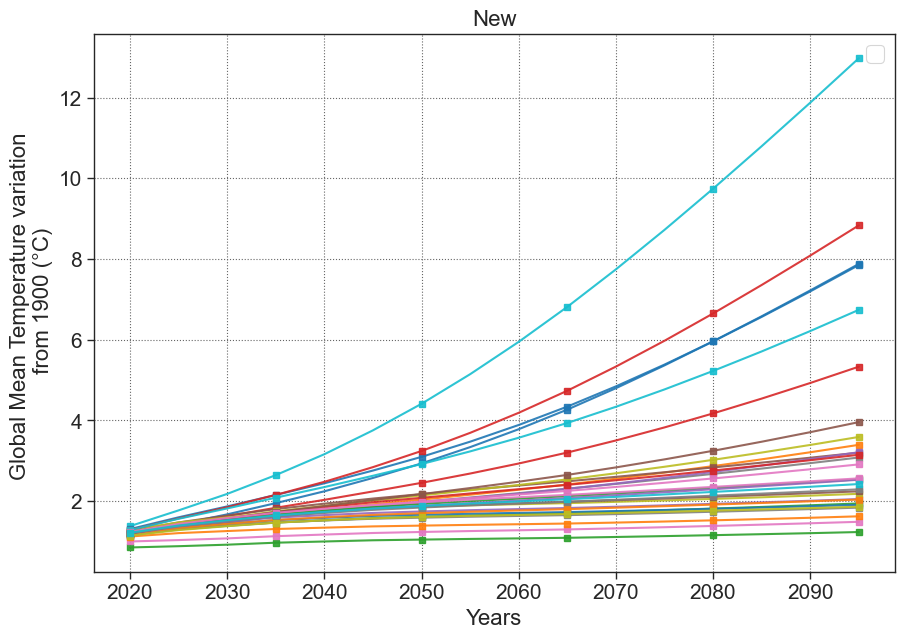

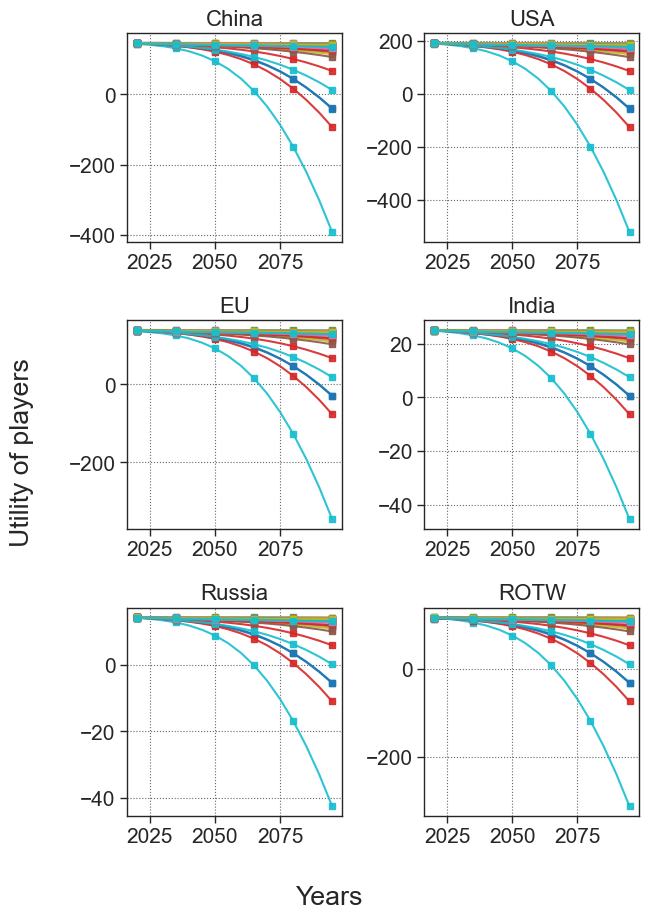

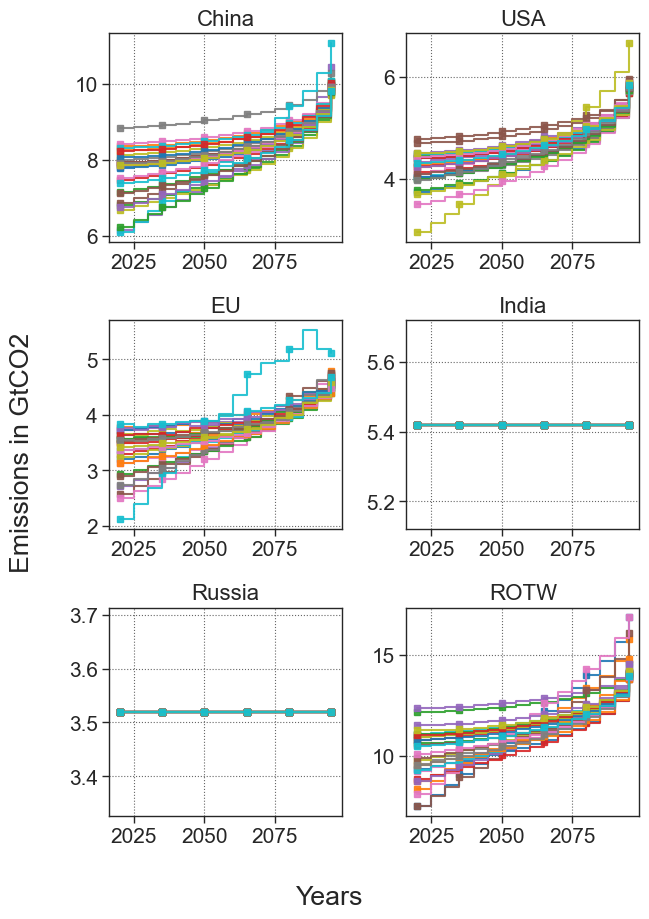

In [71]:
plots('test_plot', list_label=list_label, case = 'classic_sigmoid')

In [1]:
import numpy as np

def add_noise(signal, snr_dB):
    # Convert SNR from decibels to linear scale
    snr_linear = 10**(snr_dB / 10.0)
    
    # Calculate signal power
    signal_power = np.sum(signal**2) / len(signal)
    
    # Calculate noise power based on SNR
    noise_power = signal_power / snr_linear
    
    # Generate noise with the same shape as the signal
    noise = np.random.normal(0, np.sqrt(noise_power), signal.shape)
    
    # Add noise to the signal
    noisy_signal = signal + noise
    
    return noisy_signal


In [7]:
x = np.linspace(0,10,1000)
y = np.sin(x)*100

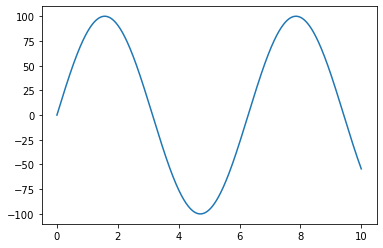

In [8]:
import matplotlib.pyplot as plt
plt.plot(x,y)

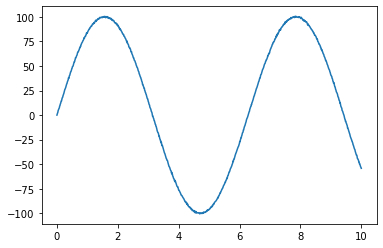

In [11]:
no = add_noise(y, 45)
plt.plot(x, no )

In [46]:
add_noise(np.array([399.49979141,  36.53475613,   4.30458486]), 20)

array([362.66087582,  52.78885993, -47.03451869])

In [327]:
10**np.mean(y - no)

0.9900778448354904

In [330]:
import numpy as np

def calculate_snr(signal, noise):
    # Calculate signal power
    signal_power = np.sum(signal**2) / len(signal)
    
    # Calculate noise power
    noise_power = np.sum(noise**2) / len(noise)
    
    # Calculate SNR in decibels
    snr = 10 * np.log10(signal_power / noise_power)
    
    return snr

# Example usage
# Generate a signal


# Add noise to the signal
noisy_signal = add_noise(y, 15)

# Calculate the SNR of the noisy signal
calculated_snr = calculate_snr(y, noisy_signal - y)

# Print the calculated SNR
print("Calculated SNR:", calculated_snr)
print("Specified SNR:", 15)


Calculated SNR: 14.836566380358455
Specified SNR: 15


In [83]:
param = 1/-np.log(np.diag(SCM.carbon_model.Ac_0))[1:]

In [363]:
param_bruit = [add_noise(np.array([v]), 5) for v in param ]
param_bruit

[array([488.86673833]), array([33.40391996]), array([1.35668736])]

In [214]:
param_bruit_ = [add_noise(np.array([v]), 50) for v in np.diag(SCM.carbon_model.Ac_0)[1:] ]
1/-np.log(param_bruit_)

array([[2534.61232462],
       [  38.39468694],
       [   4.24529525]])

array([[ -2.49414286],
       [-13.65172306],
       [ 17.5802257 ]])

In [ ]:
import numpy as np

def find_best_snr(signal, relative_error):
    snr = 0  # Initial SNR guess
    epsilon = 1e-6  # Error tolerance
    max_iterations = 1000  # Maximum number of iterations

    for _ in range(max_iterations):
        noisy_signal = add_noise(signal, snr)  # Add noise with current SNR
        current_error = calculate_mean_relative_error(noisy_signal, signal)  # Calculate error

        if current_error < relative_error:
            return snr

        # Adjust SNR based on error difference
        snr += 1  # Increase SNR by 1

        # Check if error is within tolerance
        if np.abs(current_error - relative_error) < epsilon:
            return snr

    # If no satisfactory SNR is found, return None
    return None

# Example usage
# Generate the signal
signal = np.array([1, 2, 3, 4, 5])

# Specify the desired relative error
relative_error = 0.1

# Find the best SNR for the given relative error
best_snr = find_best_snr(signal, relative_error)

# Print the best SNR
if best_snr is not None:
    print("Best SNR:", best_snr)
else:
    print("No satisfactory SNR found.")


In [ ]:
import numpy as np

def calculate_mean_relative_error(simulated_signal, desired_signal):
    absolute_error = np.abs(simulated_signal - desired_signal)
    mean_relative_error = np.mean(absolute_error) / np.max(desired_signal)
    return mean_relative_error

# Example usage
# Generate the simulated signal and desired signal
simulated_signal = np.array([1, 2, 3, 4, 5])
desired_signal = np.array([0.8, 2.1, 3.2, 4.3, 5.5])

# Calculate the mean relative error
mean_relative_error = calculate_mean_relative_error(simulated_signal, desired_signal)

# Translate mean relative error to dB
mean_relative_error_dB = 20 * np.log10(mean_relative_error)

# Print the mean relative error in dB
print("Mean Relative Error (dB):", mean_relative_error_dB)
